In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"
from memflow.read_data.dataset_all import DatasetCombined
from memflow.unfolding_network.conditional_transformer import ConditioningTransformerLayer
from memflow.unfolding_flow.utils import *
from memflow.unfolding_flow.unfolding_flow import UnfoldingFlow

import numpy as np
#import scipy.stats as st
from torch import optim
from torch.utils.data import DataLoader
import torch.nn as nn
from torch.nn.functional import normalize
from torch.optim.lr_scheduler import CosineAnnealingLR

import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import matplotlib as mpl
from matplotlib import cm

from collections import defaultdict
from tensorboardX import SummaryWriter
from omegaconf import OmegaConf
import sys
import argparse
from pynvml import *
from hist import Hist
import hist
import vector
import mplhep
import awkward as ak
import random
import pandas as pd

from memflow.read_data.utils import to_flat_tensor
from memflow.phasespace.phasespace import PhaseSpace

from utils import FindMasks
from utils import SavePlots
from utils import plot_regressionFactor, plot_diff_mode_quantile,get_central_smallest_interval


from rich.progress import track

pi = torch.pi


In [2]:
torch.cuda.device_count()

1

In [3]:
torch.cuda.empty_cache()

In [3]:
batchSize = 1024

device = torch.device("cuda") #torch.device("cuda" if torch.cuda.is_available() else "cpu") # specify the GPU ids

basedir_flow= "/work/dvalsecc/MEM/models_archive/flow_labframe_sampling/best/maybebest_flow_sampling_v9-regr"

model_weights = basedir_flow + '/model_flow_sampling_v9-sampling-regr.pt'

path_to_conf = basedir_flow + '/config_flow_sampling_v9-sampling-regr.yaml'

input_dataset_test = '/work/dvalsecc/MEM/datasets/all_jets_fullRun2_ttHbb_forTraining_allyears_spanetprov_part2.parquet'

with open(path_to_conf) as f:
        config = OmegaConf.load(path_to_conf)

config

data = DatasetCombined(input_dataset_test, dev=torch.device("cpu"),
                                    dtype=torch.float64, datasets=['partons_lab', 'reco_lab', 'partons_CM'],
                           reco_list_lab=['scaledLogRecoParticles', 'mask_lepton', 
                                      'mask_jets','mask_met',
                                      'mask_boost', 'scaledLogBoost'],
                           parton_list_lab=['logScaled_data_higgs_t_tbar_ISR',
                                        'logScaled_data_boost',
                                        'mean_log_data_higgs_t_tbar_ISR',
                                        'std_log_data_higgs_t_tbar_ISR',
                                        'mean_log_data_boost',
                                            'std_log_data_boost'],
                           parton_list_cm=['phasespace_intermediateParticles_onShell_logit',
                                           'phasespace_intermediateParticles_onShell_logit_scaled',
                                           'phasespace_intermediateParticles_onShell',
                                           'mean_phasespace_intermediateParticles_onShell_logit',
                                            'std_phasespace_intermediateParticles_onShell_logit',
                                           'mean_log_data_higgs_t_tbar_ISR',
                                        'std_log_data_higgs_t_tbar_ISR',
                                          ])



log_mean_parton_lab = data.partons_lab.mean_log_data_higgs_t_tbar_ISR.to(device)
log_std_parton_lab = data.partons_lab.std_log_data_higgs_t_tbar_ISR.to(device)
log_mean_parton_CM = data.partons_CM.mean_log_data_higgs_t_tbar_ISR.to(device)
log_std_parton_CM = data.partons_CM.std_log_data_higgs_t_tbar_ISR.to(device)
log_mean_boost = data.partons_lab.mean_log_data_boost.to(device)
log_std_boost = data.partons_lab.std_log_data_boost.to(device)
mean_ps = data.partons_CM.mean_phasespace_intermediateParticles_onShell_logit.to(device)
scale_ps = data.partons_CM.std_phasespace_intermediateParticles_onShell_logit.to(device)

# Initialize model
model = UnfoldingFlow(
                pretrained_model=None,
                load_conditioning_model=False,
                scaling_partons_lab = [log_mean_parton_lab, log_std_parton_lab],
                scaling_boost_lab = [log_mean_boost, log_std_boost],
                scaling_partons_CM_ps = [mean_ps, scale_ps],

                no_jets=config.input_shape.number_jets,
                no_lept=config.input_shape.number_lept,
                input_features=config.input_shape.input_features,
                cond_hiddenFeatures=config.conditioning_transformer.hidden_features,
                cond_dimFeedForward=config.conditioning_transformer.dim_feedforward_transformer,
                cond_outFeatures=config.conditioning_transformer.out_features,
                cond_nheadEncoder=config.conditioning_transformer.nhead_encoder,
                cond_NoLayersEncoder=config.conditioning_transformer.no_layers_encoder,
                cond_nheadDecoder=config.conditioning_transformer.nhead_decoder,
                cond_NoLayersDecoder=config.conditioning_transformer.no_layers_decoder,
                cond_NoDecoders=config.conditioning_transformer.no_decoders,
                cond_aggregate=config.conditioning_transformer.aggregate,
                cond_use_latent=config.conditioning_transformer.use_latent,
                cond_out_features_latent=config.conditioning_transformer.out_features_latent,
                cond_no_layers_decoder_latent=config.conditioning_transformer.no_layers_decoder_latent,   
    
                flow_nfeatures=config.unfolding_flow.nfeatures,
                flow_ncond=config.unfolding_flow.ncond, 
                flow_ntransforms=config.unfolding_flow.ntransforms,
                flow_hiddenMLP_NoLayers=config.unfolding_flow.hiddenMLP_NoLayers, 
                flow_hiddenMLP_LayerDim=config.unfolding_flow.hiddenMLP_LayerDim,
                flow_bins=config.unfolding_flow.bins,
                flow_autoregressive=config.unfolding_flow.autoregressive,
                flow_base=config.unfolding_flow.base,
                flow_base_first_arg=config.unfolding_flow.base_first_arg,
                flow_base_second_arg=config.unfolding_flow.base_second_arg,
                flow_bound=config.unfolding_flow.bound,
                randPerm=config.unfolding_flow.randPerm,
                device=device,
                dtype=torch.float64,
                eps=config.training_params.eps)

model.load_state_dict(torch.load(model_weights, map_location=device)["model_state_dict"])


>>Loading datasets
Loading partons in LAB
PartonLevel LAB
Reading parton_level Files
Load logScaled_data_higgs_t_tbar_ISR
Load logScaled_data_boost
Parton: Move tensors to device (cpu) memory
Loading reco in LAB
RecoLevel LAB
Reading reco_level Files
Load scaledLogBoost
Load scaledLogRecoParticles
Reco: Move tensors to device (cpu) memory
Loading partons in CM
PartonLevel CM
Reading parton_level Files
Load phasespace_intermediateParticles_onShell
Load phasespace_intermediateParticles_onShell_logit
Load logScaled_data_higgs_t_tbar_ISR
Parton: Move tensors to device (cpu) memory
Loaded datasets:  ['partons_lab', 'reco_lab', 'partons_CM']


<All keys matched successfully>

In [48]:
E_CM = 13000
phasespace = PhaseSpace(E_CM, [21,21], [25,6,-6,21], dev="cpu")


dataCM = data.partons_CM.data_higgs_t_tbar_ISR_cartesian
parton_cartesian = dataCM
dataLab = data.partons_lab.data_higgs_t_tbar_ISR_cartesian
PS_target = data.partons_CM.phasespace_intermediateParticles_onShell
boost_parton = data.partons_CM.data_boost

higgsCorrect = vector.array(
    {
        "E": dataCM[:,0,0].detach().cpu().numpy(),
        "px": dataCM[:,0,1].detach().cpu().numpy(),
        "py": dataCM[:,0,2].detach().cpu().numpy(),
        "pz": dataCM[:,0,3].detach().cpu().numpy(),
    }
)

thadCorrect = vector.array(
    {
        "E": dataCM[:,1,0].detach().cpu().numpy(),
        "px": dataCM[:,1,1].detach().cpu().numpy(),
        "py": dataCM[:,1,2].detach().cpu().numpy(),
        "pz": dataCM[:,1,3].detach().cpu().numpy(),
    }
)

tlepCorrect = vector.array(
    {
        "E": dataCM[:,2,0].detach().cpu().numpy(),
        "px": dataCM[:,2,1].detach().cpu().numpy(),
        "py": dataCM[:,2,2].detach().cpu().numpy(),
        "pz": dataCM[:,2,3].detach().cpu().numpy(),
    }
)

glISRCorrect = vector.array(
    {
        "E": dataCM[:,3,0].detach().cpu().numpy(),
        "px": dataCM[:,3,1].detach().cpu().numpy(),
        "py": dataCM[:,3,2].detach().cpu().numpy(),
        "pz": dataCM[:,3,3].detach().cpu().numpy(),
    }
)

# In the lab
higgsCorrect_lab = vector.array(
    {
        "E": dataLab[:,0,0].detach().cpu().numpy(),
        "px": dataLab[:,0,1].detach().cpu().numpy(),
        "py": dataLab[:,0,2].detach().cpu().numpy(),
        "pz": dataLab[:,0,3].detach().cpu().numpy(),
    }
)

thadCorrect_lab = vector.array(
    {
        "E": dataLab[:,1,0].detach().cpu().numpy(),
        "px": dataLab[:,1,1].detach().cpu().numpy(),
        "py": dataLab[:,1,2].detach().cpu().numpy(),
        "pz": dataLab[:,1,3].detach().cpu().numpy(),
    }
)

tlepCorrect_lab = vector.array(
    {
        "E": dataLab[:,2,0].detach().cpu().numpy(),
        "px": dataLab[:,2,1].detach().cpu().numpy(),
        "py": dataLab[:,2,2].detach().cpu().numpy(),
        "pz": dataLab[:,2,3].detach().cpu().numpy(),
    }
)

glISRCorrect_lab = vector.array(
    {
        "E": dataLab[:,3,0].detach().cpu().numpy(),
        "px": dataLab[:,3,1].detach().cpu().numpy(),
        "py": dataLab[:,3,2].detach().cpu().numpy(),
        "pz": dataLab[:,3,3].detach().cpu().numpy(),
    }
)

higgsCorrect = ak.with_name(higgsCorrect, name="Momentum4D")
thadCorrect = ak.with_name(thadCorrect, name="Momentum4D")
tlepCorrect = ak.with_name(tlepCorrect, name="Momentum4D")
glISRCorrect = ak.with_name(glISRCorrect, name="Momentum4D")

higgsCorrect_lab = ak.with_name(higgsCorrect_lab, name="Momentum4D")
thadCorrect_lab = ak.with_name(thadCorrect_lab, name="Momentum4D")
tlepCorrect_lab = ak.with_name(tlepCorrect_lab, name="Momentum4D")
glISRCorrect_lab = ak.with_name(glISRCorrect_lab, name="Momentum4D")

In [5]:
def plot_var2d(higgs_var1, higgs_var2, thad_var1, thad_var2, tlep_var1, tlep_var2,
             ISR_var1, ISR_var2, name1, name2, nameFig, start1=0, stop1=1000, start2=0, stop2=1000, bins1=100, bins2=100,
             higgs_mask=1, thad_mask=1, tlep_mask=1, ISR_mask=1, neg_Mask=False, log=False, name='da', nameunit=''):
        
        
        if neg_Mask:
            higgs_mask = np.logical_not(higgs_mask)
            thad_mask = np.logical_not(thad_mask)
            tlep_mask = np.logical_not(tlep_mask)
            ISR_mask = np.logical_not(ISR_mask)

        # Quick construction, no other imports needed:
        hist2d_var_higgs = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_thad = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_tlep = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_ISR = (
          Hist.new
          .Reg(bins=bins1, start=start1, stop=stop1, name=name1, label=name1)
          .Reg(bins=bins2, start=start2, stop=stop2, name=name2, label=name2)
          .Double())

        hist2d_var_higgs.fill(higgs_var1[higgs_mask],
                            higgs_var2[higgs_mask])

        hist2d_var_thad.fill(thad_var1[thad_mask],
                            thad_var2[thad_mask])

        hist2d_var_tlep.fill(tlep_var1[tlep_mask],
                            tlep_var2[tlep_mask])

        hist2d_var_ISR.fill(ISR_var1[ISR_mask],
                            ISR_var2[ISR_mask])

        colormap='viridis'
        my_viridis = mpl.colormaps[colormap].with_extremes(under="white")
        
        fontsize = 20
        labelsize=14
        labels = ['higgs', 'thad', 'tlep', 'ISR']
        hist2d_list = [hist2d_var_higgs, hist2d_var_thad, hist2d_var_tlep, hist2d_var_ISR]
        
        
        fig, axs = plt.subplots(1, 4, figsize=(16, 6))

        if log:
            for i in range(4):
                w, x, y = hist2d_list[i].to_numpy()
                mesh = axs[i].pcolormesh(x, y, w.T, cmap=my_viridis, norm=mpl.colors.LogNorm(vmin=1))
                axs[i].set_xlabel(f"{name}-correct {nameunit}", fontsize=fontsize)
                axs[i].set_ylabel(f"{name}-regressed {nameunit}", fontsize=fontsize)
                axs[i].set_title(f"{labels[i]}", fontsize=fontsize)
                axs[i].tick_params(axis='both', which='major', labelsize=labelsize)
                cbar = fig.colorbar(mesh)
                cbar.ax.tick_params(labelsize=labelsize)
                plt.tight_layout()

        else:
            for i in range(4):
                w, x, y = hist2d_list[i].to_numpy()
                mesh = axs[i].pcolormesh(x, y, w.T, cmap=my_viridis, vmin=1)
                axs[i].set_xlabel(f"{name}-correct {nameunit}", fontsize=fontsize)
                axs[i].set_ylabel(f"{name}-regressed {nameunit}", fontsize=fontsize)
                axs[i].set_title(f"{labels[i]}", fontsize=fontsize)
                axs[i].tick_params(axis='both', which='major', labelsize=labelsize)
                cbar = fig.colorbar(mesh)
                cbar.ax.tick_params(labelsize=labelsize)
                plt.tight_layout()

In [6]:
def get_particle_awkward(momenta):
    
    higgs = momenta[:,0]
    thad = momenta[:,1]
    tlep = momenta[:,2]
    ISR = momenta[:,3]
    
    higgs = vector.array(
                {
                "E": higgs[:,0].detach().numpy(),
                "px": higgs[:,1].detach().numpy(),
                "py": higgs[:,2].detach().numpy(),
                "pz": higgs[:,3].detach().numpy()
                }
            )
    thad = vector.array(
                {
                "E": thad[:,0].detach().numpy(),
                "px": thad[:,1].detach().numpy(),
                "py": thad[:,2].detach().numpy(),
                "pz":thad[:,3].detach().numpy(),
                }
            )

    tlep = vector.array(
                {
                "E": tlep[:,0].detach().numpy(),
                "px": tlep[:,1].detach().numpy(),
                "py": tlep[:,2].detach().numpy(),
                "pz": tlep[:,3].detach().numpy(),
                }
            )
    
    ISR = vector.array(
                {
                "E": ISR[:,0].detach().numpy(),
                "px": ISR[:,1].detach().numpy(),
                "py": ISR[:,2].detach().numpy(),
                "pz": ISR[:,3].detach().numpy(),
                }
            )
    
    higgs = ak.with_name(higgs, name="Momentum4D")
    thad = ak.with_name(thad, name="Momentum4D")
    tlep = ak.with_name(tlep, name="Momentum4D")
    ISR = ak.with_name(ISR, name="Momentum4D")
    
    return higgs, thad, tlep, ISR


def get_particle_awkward_ptetaphi(momenta):

    higgs = momenta[:,0]
    thad = momenta[:,1]
    tlep = momenta[:,2]
    ISR = momenta[:,3]
    M_HIGGS = 125.25
    M_TOP = 172.5
    M_GLUON = 1e-5
    
    higgs = vector.array(
                {
                "pt": higgs[:,0].detach().numpy(),
                "eta": higgs[:,1].detach().numpy(),
                "phi": higgs[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_HIGGS
                }
            )
    thad = vector.array(
                {
                "pt": thad[:,0].detach().numpy(),
                "eta": thad[:,1].detach().numpy(),
                "phi": thad[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_TOP
                }
            )

    tlep = vector.array(
                {
                "pt": tlep[:,0].detach().numpy(),
                "eta": tlep[:,1].detach().numpy(),
                "phi": tlep[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_TOP
                }
            )
    
    ISR = vector.array(
                {
                "pt": ISR[:,0].detach().numpy(),
                "eta": ISR[:,1].detach().numpy(),
                "phi": ISR[:,2].detach().numpy(),
                "m": np.ones(len(momenta))*M_GLUON
                }
            )
    
    higgs = ak.with_name(higgs, name="Momentum4D")
    thad = ak.with_name(thad, name="Momentum4D")
    tlep = ak.with_name(tlep, name="Momentum4D")
    ISR = ak.with_name(ISR, name="Momentum4D")
    
    return higgs, thad, tlep, ISR

def get_particle_awkward_samples(momenta, offset=2):
    
    higgs = momenta[:,:,offset]
    thad = momenta[:,:,offset+1]
    tlep = momenta[:,:,offset+2]
    ISR = momenta[:,:,offset+3]
    
    higgs = vector.array(
                {
                "E": higgs[:,:,0].detach().numpy(),
                "px": higgs[:,:,1].detach().numpy(),
                "py": higgs[:,:,2].detach().numpy(),
                "pz": higgs[:,:,3].detach().numpy()
                }
            )

    thad = vector.array(
                {
                "E": thad[:,:,0].detach().numpy(),
                "px": thad[:,:,1].detach().numpy(),
                "py": thad[:,:,2].detach().numpy(),
                "pz":thad[:,:,3].detach().numpy(),
                }
            )

    tlep = vector.array(
                {
                "E": tlep[:,:,0].detach().numpy(),
                "px": tlep[:,:,1].detach().numpy(),
                "py": tlep[:,:,2].detach().numpy(),
                "pz": tlep[:,:,3].detach().numpy(),
                }
            )
    
    ISR = vector.array(
                {
                "E": ISR[:,:,0].detach().numpy(),
                "px": ISR[:,:,1].detach().numpy(),
                "py": ISR[:,:,2].detach().numpy(),
                "pz": ISR[:,:,3].detach().numpy(),
                }
            )
    
    higgs = ak.with_name(higgs, name="Momentum4D")
    thad = ak.with_name(thad, name="Momentum4D")
    tlep = ak.with_name(tlep, name="Momentum4D")
    ISR = ak.with_name(ISR, name="Momentum4D")
    
    return higgs, thad, tlep, ISR



def get_diff(C, C_samples, Nsamples):
    # Diff between target quantity in awkward array and samples of the same quantity
    return torch.from_numpy(ak.to_numpy(C_samples)) - torch.from_numpy(ak.to_numpy(C)).unsqueeze(1).expand(-1, Nsamples)

def get_std(C_samples): 
    return np.nanstd(ak.to_numpy(C_samples), axis=1)

# Testing the model sampling

In [22]:
indices = list(range(50))

In [23]:
logScaled_reco = data.reco_lab.scaledLogRecoParticles[indices].to(device)
mask_lepton_reco = data.reco_lab.mask_lepton[indices].to(device)
mask_jets = data.reco_lab.mask_jets[indices].to(device)
mask_met = data.reco_lab.mask_met[indices].to(device)
mask_boost_reco = data.reco_lab.mask_boost[indices].to(device)
data_boost_reco = data.reco_lab.scaledLogBoost[indices].to(device)

boost_parton = data.partons_CM.data_boost[indices].to(device)
parton_cartesian = data.partons_CM.data_higgs_t_tbar_ISR_cartesian_onShell[indices].to(device)
ps_target_scaled = data.partons_CM.phasespace_intermediateParticles_onShell_logit_scaled[indices].to(device)
ps_target = data.partons_CM.phasespace_intermediateParticles_onShell[indices].to(device)
ps_target_logit = data.partons_CM.phasespace_intermediateParticles_onShell[indices].to(device)

In [24]:
model = model.to(device)

In [25]:
device

device(type='cuda')

In [26]:
mask_recoParticles = torch.cat((mask_jets, mask_lepton_reco, mask_met), dim=1)
if True : # Always remove true proveance TODO REMOVE THE HACK 
    logScaled_reco = logScaled_reco[:,:,:-1]


In [27]:
with torch.no_grad():
# The provenance is remove in the model
    (data_regressed, data_regressed_cm, ps_regr,
         logit_ps_regr, flow_cond_vector,
         _, mask_problematic)   = model(logScaled_reco,
                                                  data_boost_reco,
                                                  mask_recoParticles,
                                                  mask_boost_reco,
                                                  None,
                                                  disableGradConditioning=False,
                                                  flow_eval="conditioning_only")


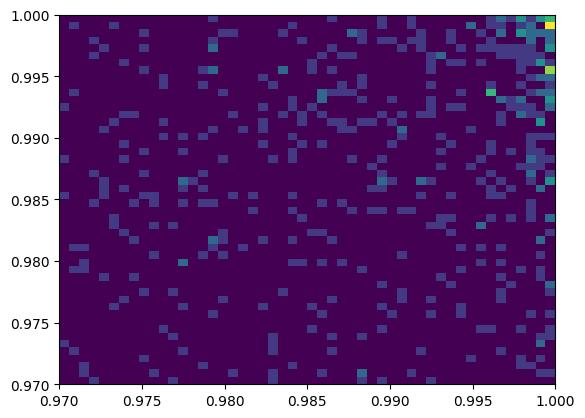

In [24]:
plt.hist2d(ps_target[:, 0].cpu().numpy(), ps_regr[:,0].cpu().numpy(), bins=50, range=((0.97,1),(0.97,1)));

# Evaluation of the shape of the latent space

In [25]:
with torch.no_grad():
    z, ladj = model.flow(flow_cond_vector).transform.call_and_ladj(ps_target_scaled)

0 tensor(-0.0221, device='cuda:0') tensor(0.3499, device='cuda:0')
1 tensor(0.0061, device='cuda:0') tensor(0.3591, device='cuda:0')
2 tensor(0.0081, device='cuda:0') tensor(0.3880, device='cuda:0')
3 tensor(0.0023, device='cuda:0') tensor(0.3751, device='cuda:0')
4 tensor(0.0029, device='cuda:0') tensor(0.3709, device='cuda:0')
5 tensor(0.0016, device='cuda:0') tensor(0.3810, device='cuda:0')
6 tensor(0.0103, device='cuda:0') tensor(0.3661, device='cuda:0')
7 tensor(0.0145, device='cuda:0') tensor(0.3645, device='cuda:0')
8 tensor(-0.0250, device='cuda:0') tensor(0.3676, device='cuda:0')
9 tensor(-0.0380, device='cuda:0') tensor(0.3772, device='cuda:0')


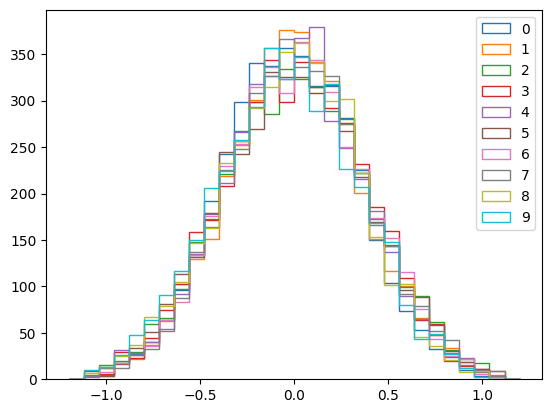

In [26]:
for i in range(10):
    plt.hist(z[:,i].detach().cpu().numpy(), bins=30, range=(-1.2,1.2), label=f"{i}", histtype="step")
    print(i, z[:,i].mean(), z[:,i].std())

plt.legend()

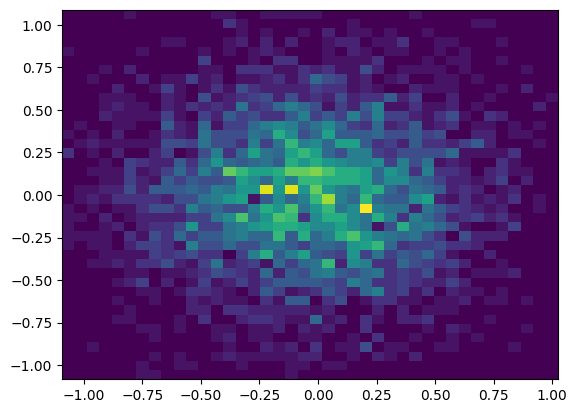

In [27]:
plt.hist2d(z[:,9].detach().cpu().numpy(), z[:,4].detach().cpu().numpy(),
          bins=40);

In [28]:
F= model.flow(flow_cond_vector)

In [29]:
with torch.no_grad():
    samples, W  = F.rsample_and_log_prob((100,))

OutOfMemoryError: CUDA out of memory. Tried to allocate 1.22 GiB (GPU 0; 10.92 GiB total capacity; 8.69 GiB already allocated; 921.44 MiB free; 9.46 GiB reserved in total by PyTorch) If reserved memory is >> allocated memory try setting max_split_size_mb to avoid fragmentation.  See documentation for Memory Management and PYTORCH_CUDA_ALLOC_CONF

(array([  1.,  11.,  49., 130., 209., 243., 145., 104.,  70.,  38.]),
 array([-6.27757906, -3.36715968, -0.4567403 ,  2.45367908,  5.36409846,
         8.27451784, 11.18493722, 14.09535659, 17.00577597, 19.91619535,
        22.82661473]),
 <BarContainer object of 10 artists>)

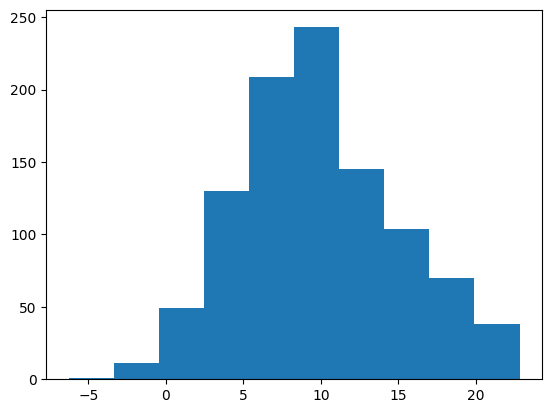

In [77]:
plt.hist(W.cpu().flatten().numpy())

In [28]:
with torch.no_grad():
    ps_samples, W = model.flow(flow_cond_vector).rsample_and_log_prob((1000,))

ps_new = torch.sigmoid(ps_samples*scale_ps + mean_ps)

(array([1.800000e+02, 1.668000e+03, 3.323000e+03, 1.813620e+05,
        1.272853e+06, 5.623310e+05, 2.371700e+04, 1.807000e+03,
        7.430000e+02, 1.600000e+01]),
 array([-1.67990742, -1.32193173, -0.96395604, -0.60598035, -0.24800466,
         0.10997103,  0.46794672,  0.8259224 ,  1.18389809,  1.54187378,
         1.89984947]),
 <BarContainer object of 10 artists>)

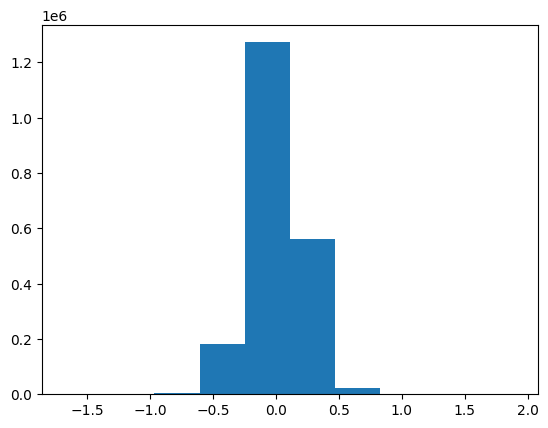

In [35]:
plt.hist(ps_samples.cpu().flatten())

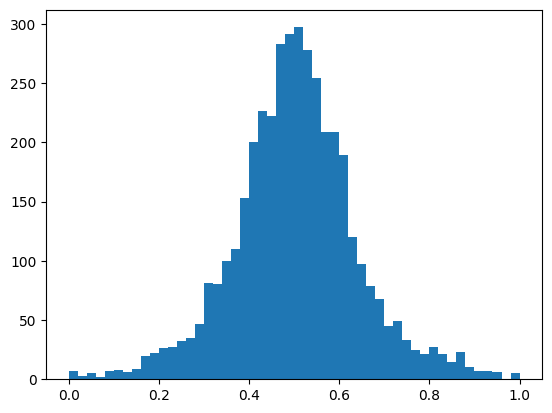

In [36]:
plt.hist(ps_new[:,1,2].cpu(), bins=50);

In [37]:
(ps_new > 1).sum()

tensor(0, device='cuda:0')

In [38]:
(ps_new<0).sum(dim=[0, 2]) / 2048

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0.], device='cuda:0')

In [39]:
(ps_new>1).sum(dim=[0, 2]) / 2048

tensor([0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.,
        0., 0.], device='cuda:0')

In [40]:
(ps_new > 1).sum()/ (ps_new > 0).sum()

tensor(0., device='cuda:0')

In [41]:
ps_samples[0,:,0]

tensor([-0.1319,  0.1309, -0.0284, -0.3341,  0.4874,  0.0205,  0.0537, -0.4070,
        -0.1900,  0.1918,  0.5595,  0.1741, -0.2008, -0.2277,  0.1180, -0.0866,
         0.1866,  0.0746, -0.1556, -0.2657,  0.1066,  0.1272, -0.0475, -0.1701,
        -0.0028,  0.3686,  0.0981, -0.0060,  0.2060, -0.0956, -0.2162, -0.0490,
         0.1151, -0.2205, -0.1143,  0.2947, -0.2480, -0.1436, -0.0030,  0.0266,
        -0.0346, -0.2218, -0.3249,  0.3637, -0.0167,  0.1790, -0.0749,  0.1192,
         0.0624,  0.0107], device='cuda:0')

In [29]:
ps_new_flat = ps_new.flatten(0, 1)
momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_new_flat)
momenta_original = momenta.reshape(-1,ps_new.shape[1], 6, 4).transpose(1, 0)
x1pp = x1pp.reshape(-1, ps_new.shape[1]).transpose(1,0)
x2pp = x2pp.reshape(-1, ps_new.shape[1]).transpose(1,0)
H, t1, t2, isr = get_particle_awkward(parton_cartesian.cpu())
Hs, t1s, t2s, isrs = get_particle_awkward_samples(momenta_original.cpu())

Hr, t1r, t2r, isrr = get_particle_awkward(data_regressed_cm.cpu())

x1 = (boost_parton[:,0,0]+boost_parton[:,0,3])/E_CM
x2 = (boost_parton[:,0,0]-boost_parton[:,0,3])/E_CM

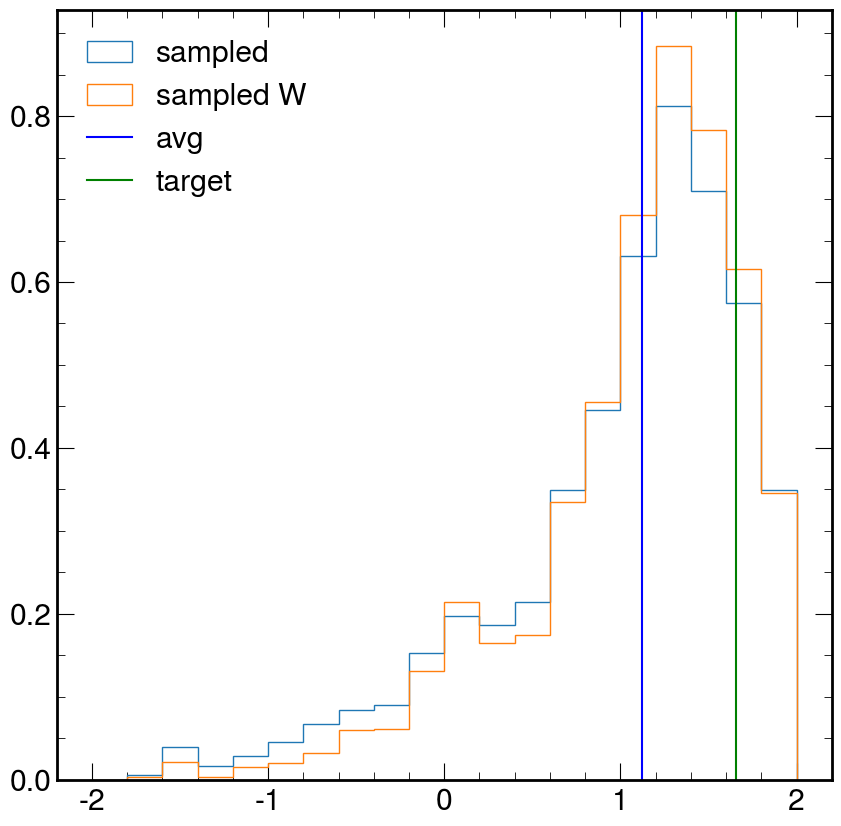

In [30]:
plt.hist(Hs.eta[8,:], bins=20, range=(-2,2), histtype="step", label="sampled", density=True)
plt.hist(Hs.eta[8,:], bins=20, weights=W.cpu().numpy()[:, 8], range=(-2,2), histtype="step", label="sampled W", density=True)

plt.axvline(ak.mean(Hs.eta[8,:]),  label="avg", c="b")
plt.axvline(H.eta[8], c="g", label="target")
plt.legend()

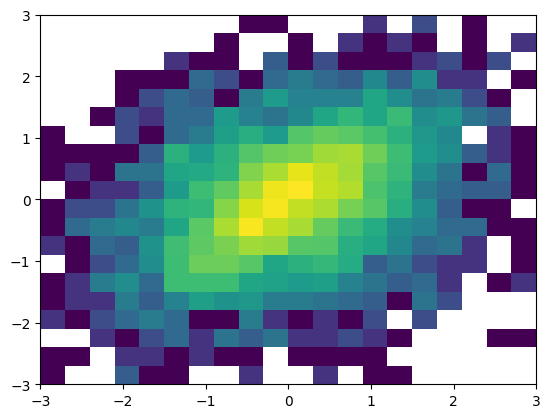

In [26]:
plt.hist2d(H.eta.to_numpy(), Hs.eta[:,1].to_numpy(), 
           bins=20, range=((-3,3),(-3,3)), norm=LogNorm());

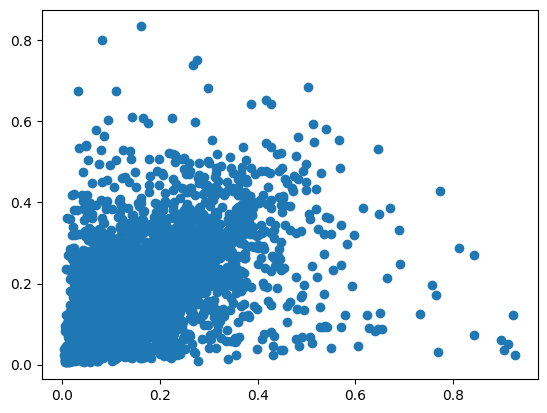

In [47]:
plt.scatter(x2pp.mean(1).cpu().numpy(), x2.cpu().numpy())

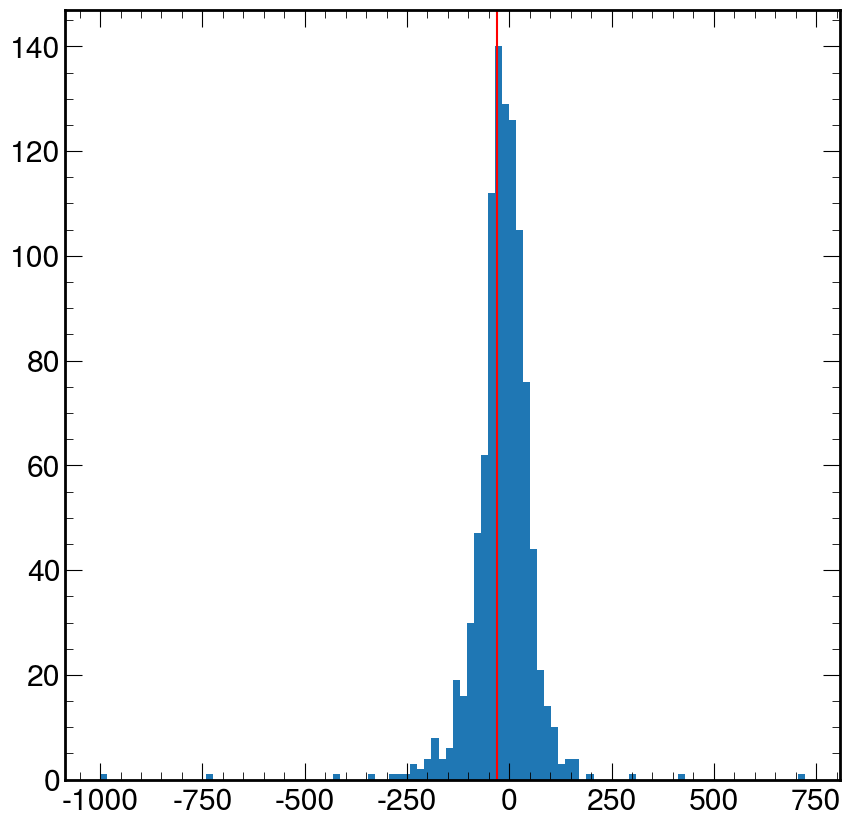

In [31]:
plt.hist(momenta_original[0, :, 3, 3].cpu(), bins=100);
plt.axvline(parton_cartesian[0, 0,3].cpu(), c="red")

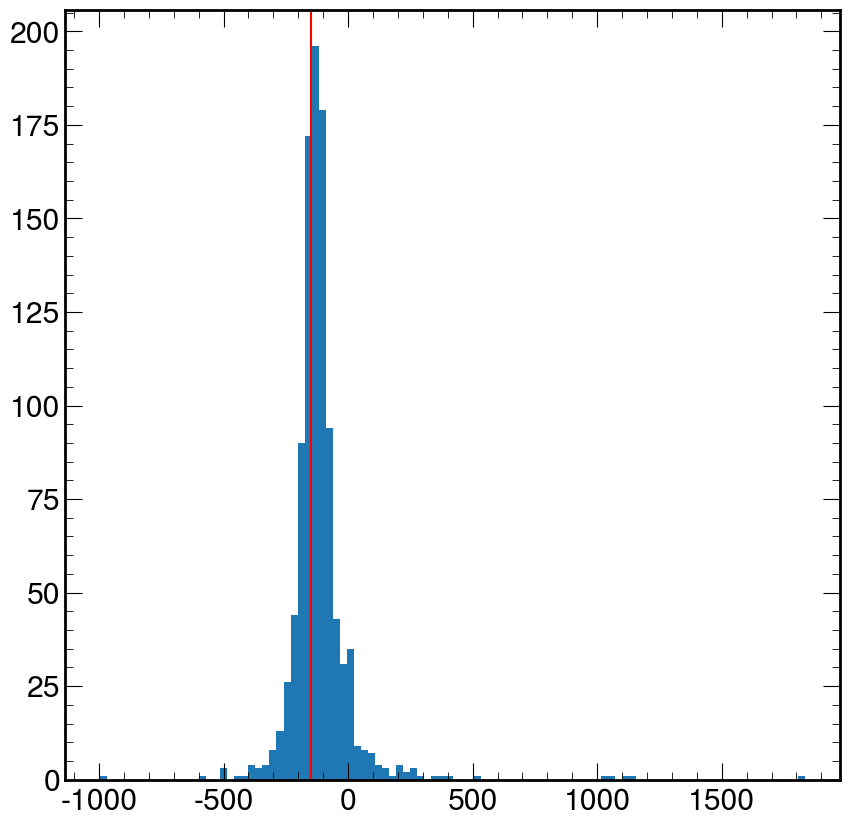

In [32]:
plt.hist(momenta_original[1, :, 3, 3].cpu(), bins=100);
plt.axvline(parton_cartesian[1, 1,3].cpu(), c="red")

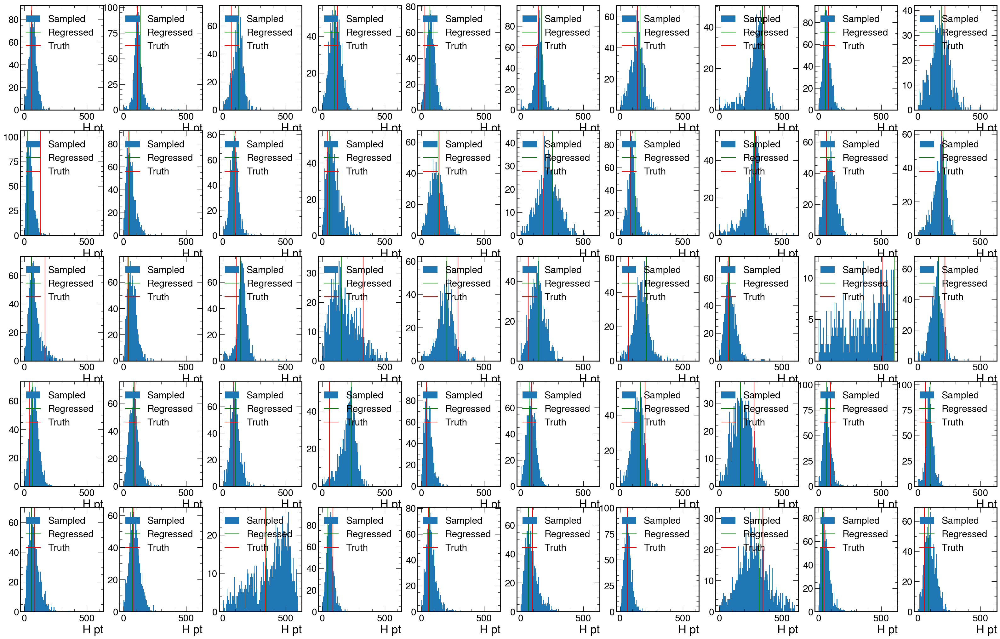

In [33]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))


for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].pt, bins=100, range=(0, 600), label="Sampled");
        axs[i][j].axvline(Hr[n].pt, c="green", label="Regressed")
        axs[i][j].axvline(H[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("H pt")
        axs[i][j].legend()

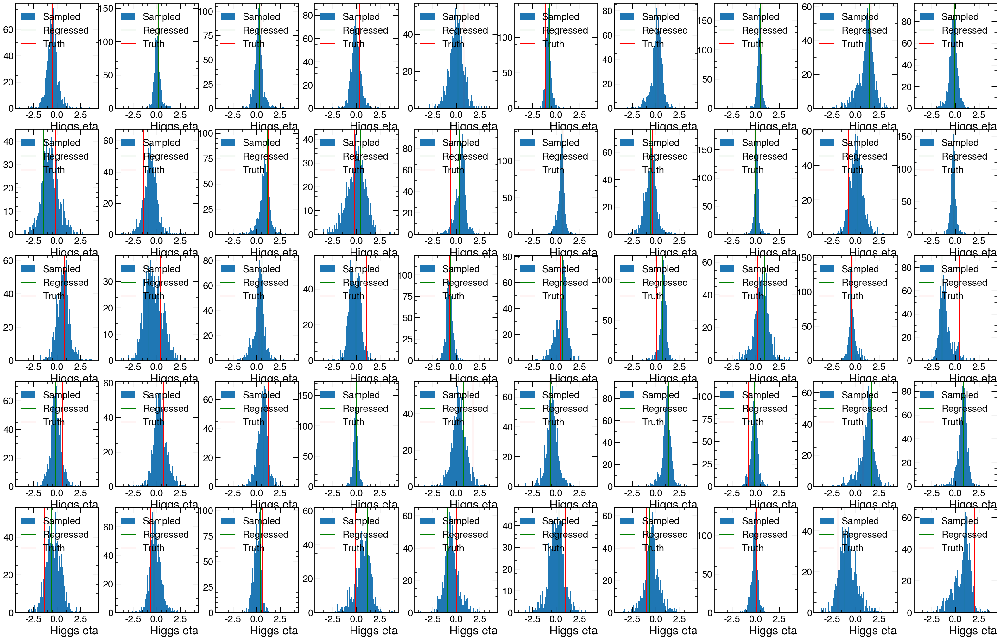

In [34]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].eta, bins=100,  range=(-4,4), label="Sampled");
        axs[i][j].axvline(Hr[n].eta, c="green",label="Regressed")
        axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs eta")
        axs[i][j].legend()

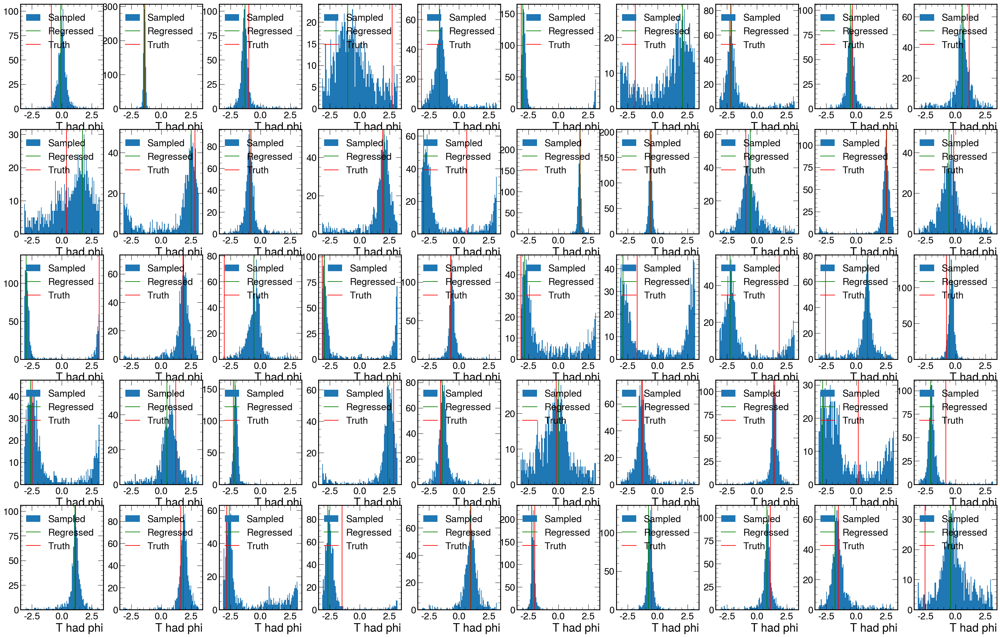

In [35]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t1s[n].phi, bins=100,  range=(-np.pi,np.pi), label="Sampled");
        axs[i][j].axvline(t1r[n].phi, c="green",label="Regressed")
        axs[i][j].axvline(t1[n].phi, c="red", label="Truth")
        axs[i][j].set_xlabel("T had phi")
        axs[i][j].legend()

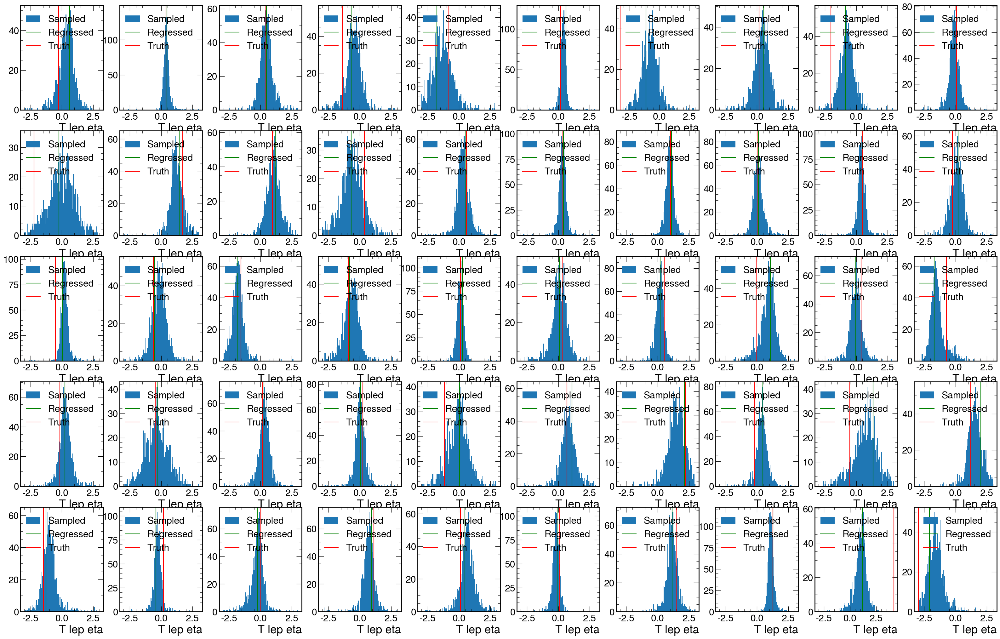

In [36]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t2s[n].eta, bins=100,  range=(-3,3), label="Sampled");
        axs[i][j].axvline(t2r[n].eta, c="green",label="Regressed")
        axs[i][j].axvline(t2[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("T lep eta")
        axs[i][j].legend()

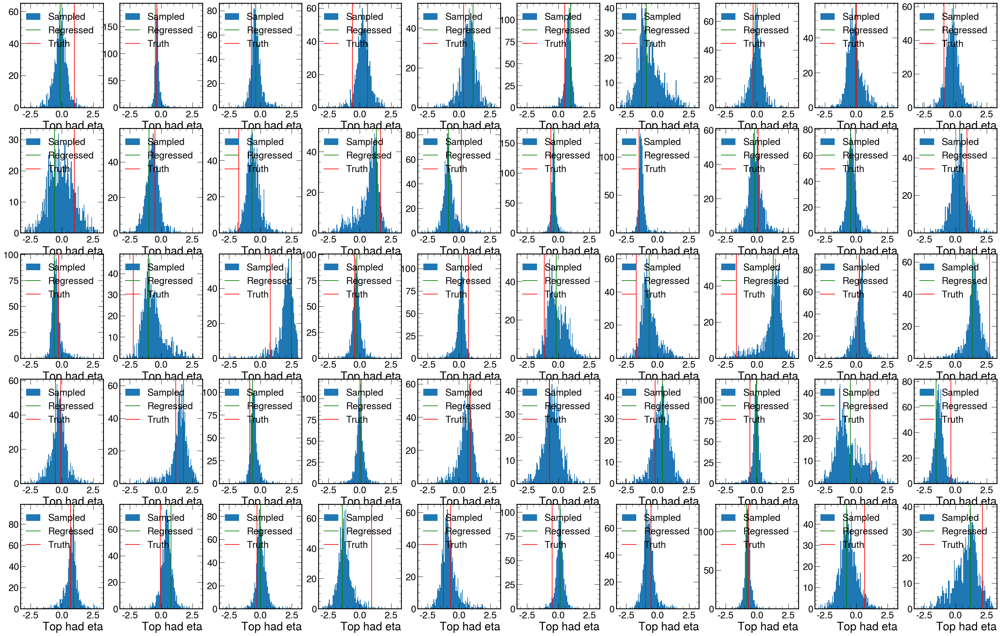

In [37]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t1s[n].eta, bins=100,  range=(-3,3), label="Sampled");
        axs[i][j].axvline(t1r[n].eta, c="green",label="Regressed")
        axs[i][j].axvline(t1[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had eta")
        axs[i][j].legend()

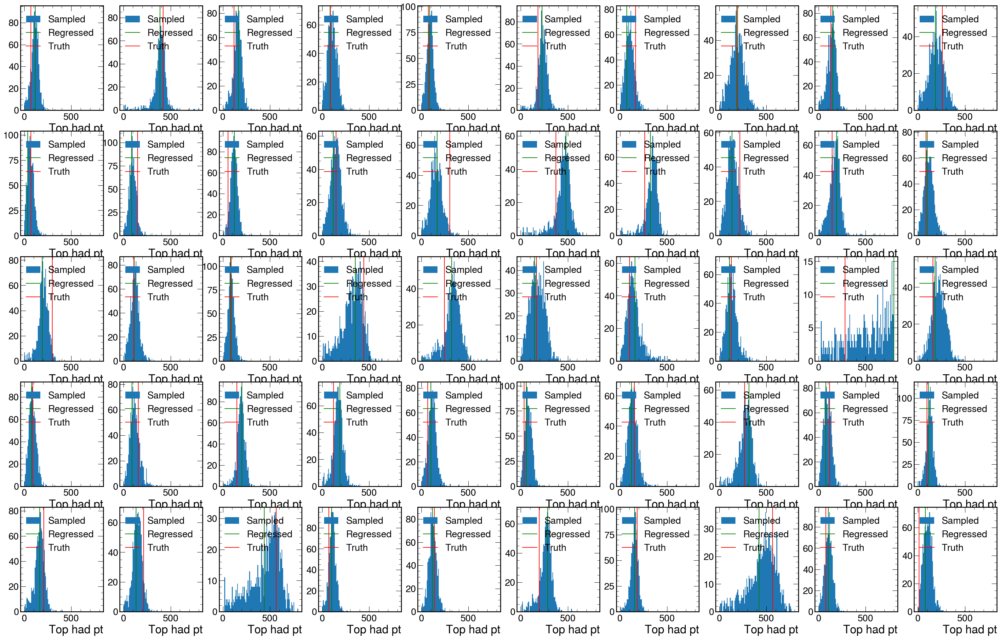

In [38]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(t1s[n].pt, bins=100,  range=(0,800), label="Sampled");
        axs[i][j].axvline(t1r[n].pt, c="green",label="Regressed")
        axs[i][j].axvline(t1[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had pt")
        axs[i][j].legend()

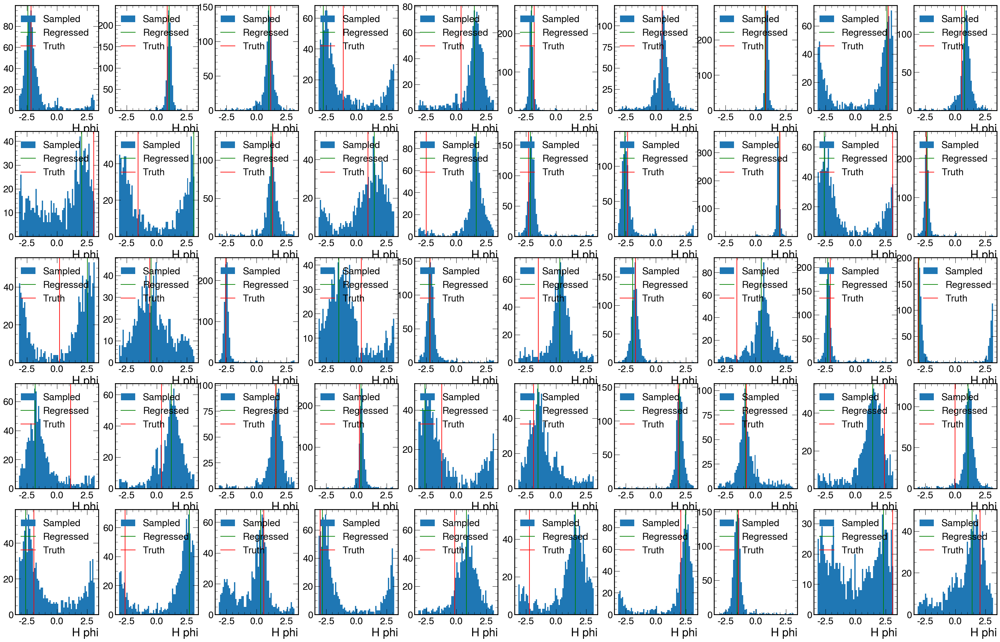

In [39]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].phi, bins=60, range=(-np.pi, np.pi), label="Sampled");
        axs[i][j].axvline(Hr[n].phi, c="green", label="Regressed")
        axs[i][j].axvline(H[n].phi, c="red", label="Truth")
        axs[i][j].set_xlabel("H phi")
        axs[i][j].legend()

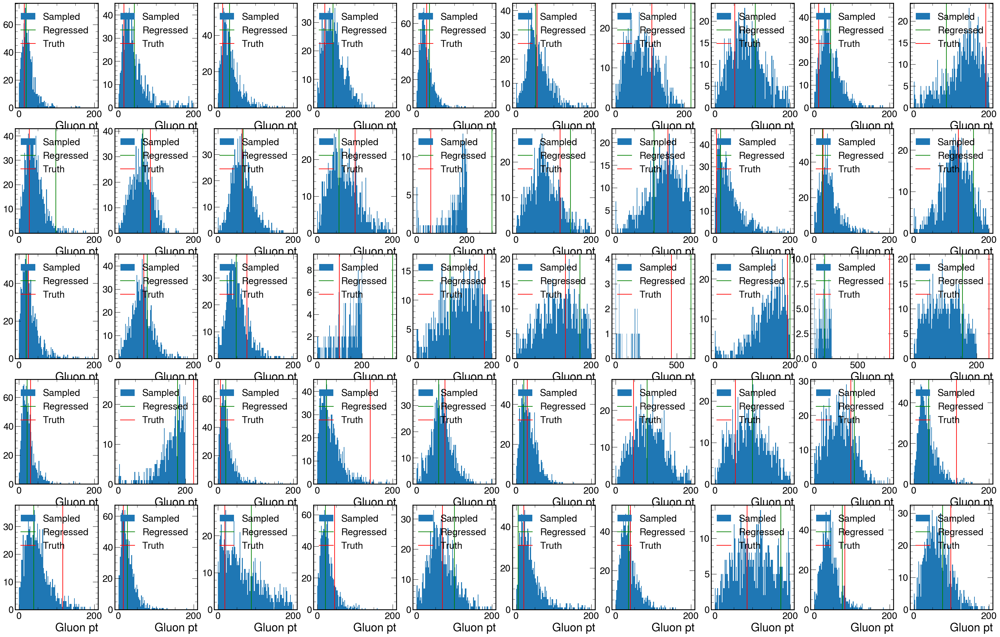

In [40]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(isrs[n].pt, bins=100,  range=(0,200), label="Sampled");
        axs[i][j].axvline(isrr[n].pt, c="green",label="Regressed")
        axs[i][j].axvline(isr[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon pt")
        axs[i][j].legend()

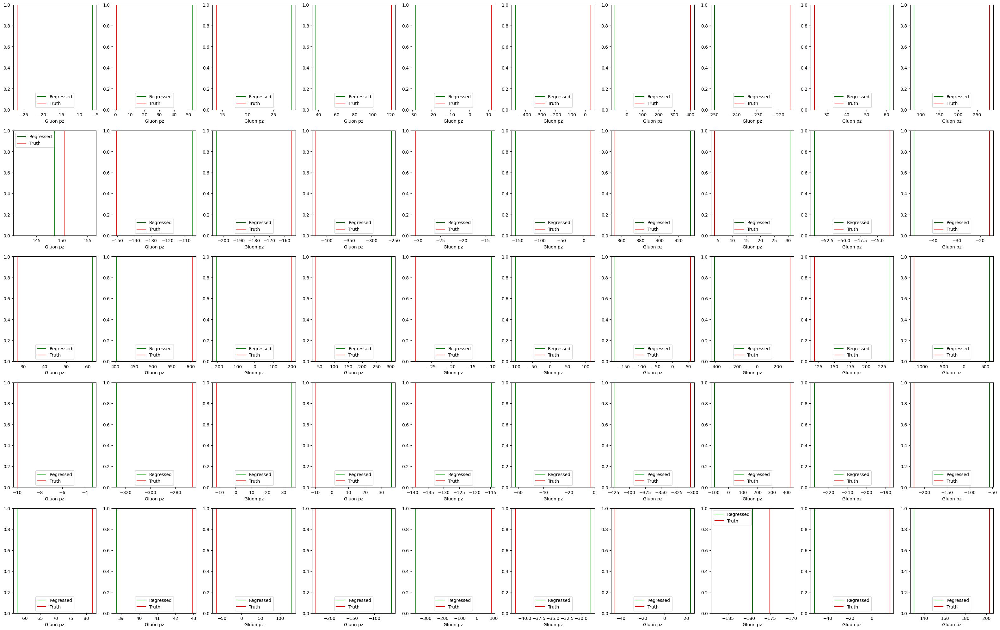

In [54]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].axvline(isrr[n].pz, c="green",label="Regressed")
        axs[i][j].axvline(isr[n].pz, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon pz")
        axs[i][j].legend()

In [39]:
x1pp.shape

torch.Size([50, 3000])

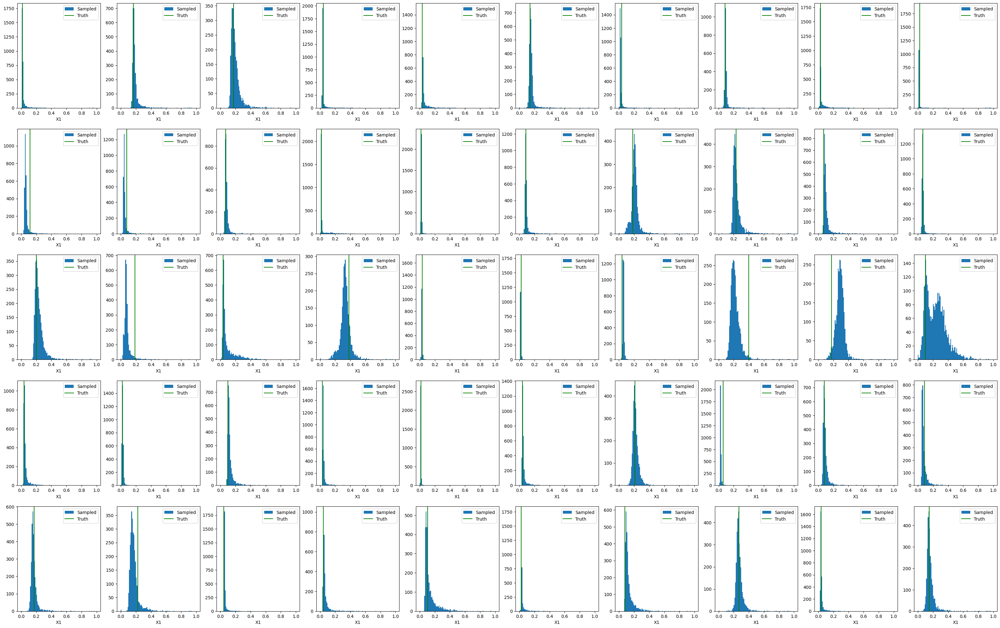

In [42]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(x1pp[n].cpu().numpy(), bins=100, range=(0,1), label="Sampled")
        axs[i][j].axvline(x1[n].cpu(), c="green",label="Truth")
        axs[i][j].set_xlabel("X1")
        axs[i][j].legend()

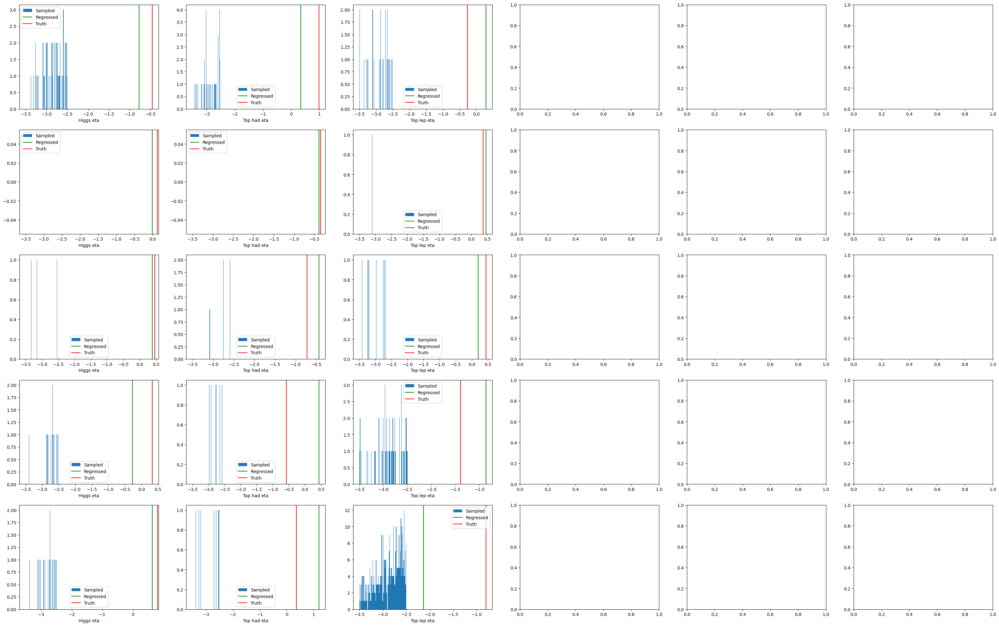

In [48]:
f, axs = plt.subplots(5, 6, figsize=(40, 25))
for i in range(5):
    axs[i][0].hist(Hs[i].eta, bins=100, range=(-3,-3), label="Sampled")
    axs[i][0].axvline(Hr[i].eta, c="green", label="Regressed")
    axs[i][0].axvline(H[i].eta, c="red", label="Truth")
    axs[i][0].set_xlabel("Higgs eta")
    axs[i][0].legend()

    axs[i][1].hist(t1s[i].eta, bins=100, range=(-3,-3), label="Sampled")
    axs[i][1].axvline(t1r[i].eta, c="green", label="Regressed")
    axs[i][1].axvline(t1[i].eta, c="red", label="Truth")
    axs[i][1].set_xlabel("Top had eta")
    axs[i][1].legend()

    axs[i][2].hist(t2s[i].eta, bins=100, range=(-3,-3), label="Sampled")
    axs[i][2].axvline(t2r[i].eta, c="green", label="Regressed")
    axs[i][2].axvline(t2[i].eta, c="red", label="Truth")
    axs[i][2].set_xlabel("Top lep eta")
    axs[i][2].legend()

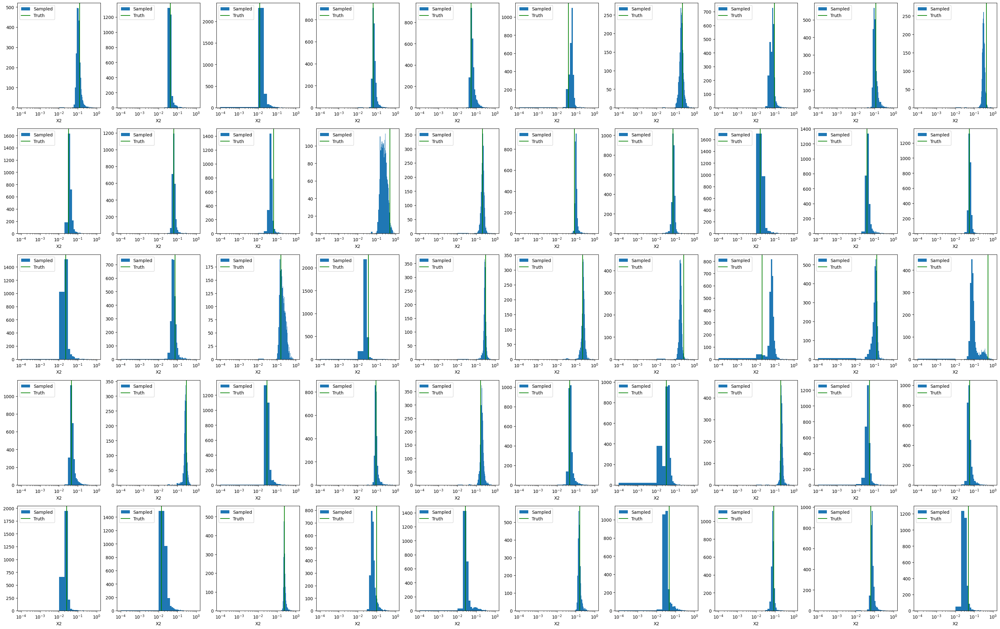

In [45]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(x2pp[n].cpu().numpy(), bins=100, range=(1e-4,1), label="Sampled")
        axs[i][j].axvline(x2[n].cpu(), c="green",label="Truth")
        axs[i][j].set_xlabel("X2")
        axs[i][j].set_xscale("log")
        axs[i][j].legend()

# Load presaved output with large samples

In [211]:
import h5py

df = h5py.File(f"{basedir_flow}/samples_30k_50events.hdf5")

In [212]:
ps_samples = torch.from_numpy(df["flow_samples"][()]).to("cuda")
ps_samples.shape

torch.Size([50, 30000, 10])

In [214]:
ps_unscaled = torch.sigmoid(ps_samples*scale_ps + mean_ps)
ps_new_flat = ps_unscaled.flatten(0, 1)
momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_new_flat)
x1pp = x1pp.reshape(-1, ps_unscaled.shape[1]).transpose(1,0)
x2pp = x2pp.reshape(-1, ps_unscaled.shape[1]).transpose(1,0)
momenta = momenta.reshape(-1,ps_unscaled.shape[1], 6, 4)#.transpose(1, 0)

Nevents= ps_samples.shape[0]
H, t1, t2, isr = get_particle_awkward(parton_cartesian[0:Nevents].cpu())

Hs, t1s, t2s, isrs = get_particle_awkward_samples(momenta.cpu())

data_regressed_cm = torch.from_numpy(df["part_CM_Epxpypz"][()] )
Hr, t1r, t2r, isrr = get_particle_awkward(data_regressed_cm[0:Nevents].cpu())


x1 = (boost_parton[:Nevents,0,0]+boost_parton[:Nevents,0,3])/E_CM
x2 = (boost_parton[:Nevents,0,0]-boost_parton[:Nevents,0,3])/E_CM

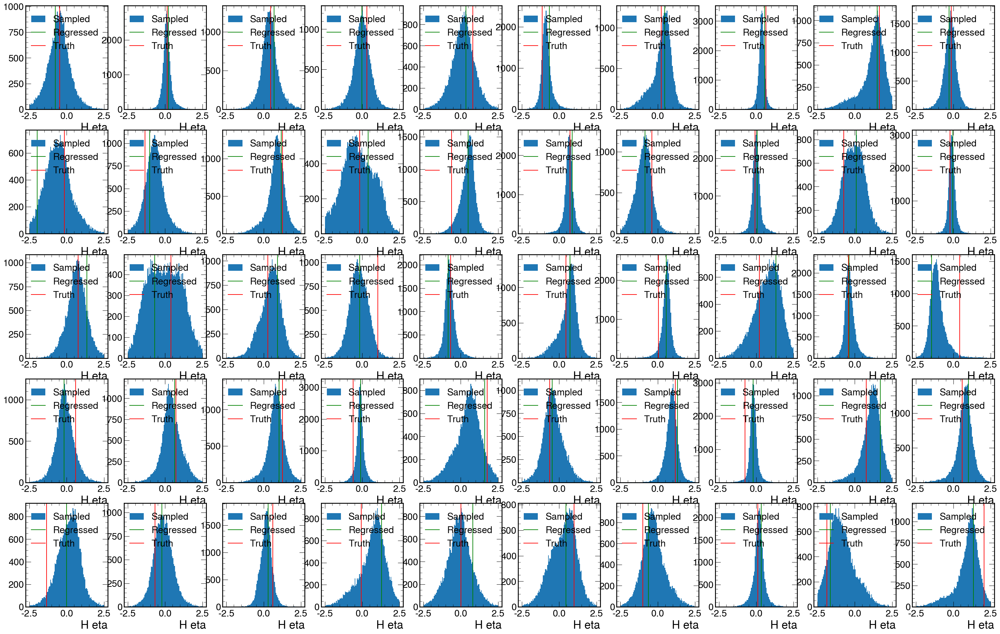

In [215]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].eta, bins=100, range=(-2.5, 2.5), label="Sampled");
        axs[i][j].axvline(Hr[n].eta, c="green", label="Regressed")
        axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("H eta")
        axs[i][j].legend()

ValueError: the truth value of an array whose length is not 1 is ambiguous; use ak.any() or ak.all()

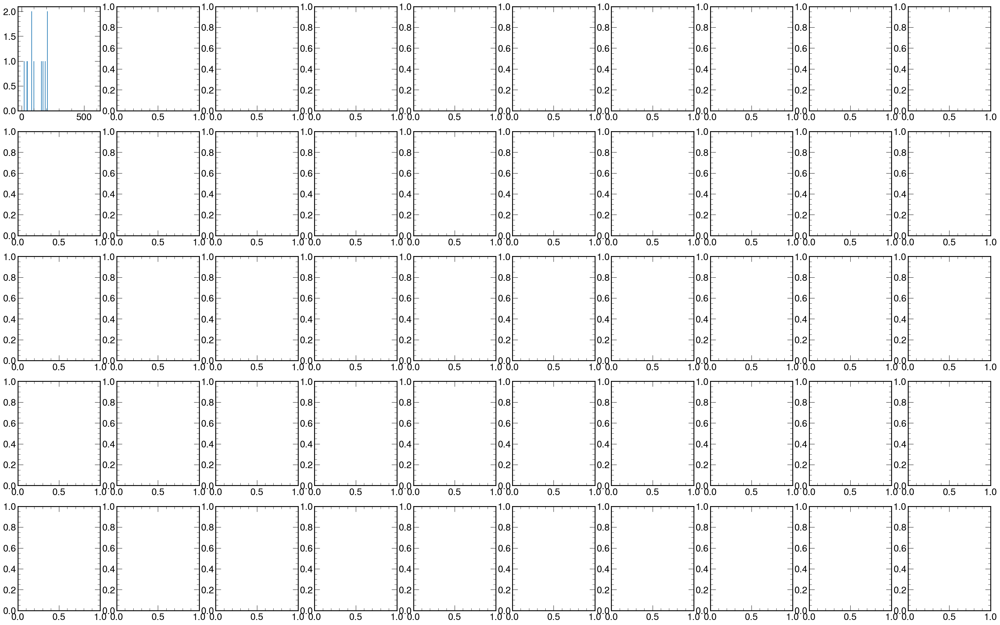

In [203]:
f, axs = plt.subplots(5, 10, figsize=(40, 25))

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist(Hs[n].pt, bins=100, range=(0, 600), label="Sampled");
        axs[i][j].axvline(Hr[n].pt, c="green", label="Regressed")
        axs[i][j].axvline(H[n].pt, c="red", label="Truth")
        axs[i][j].set_xlabel("H pt")
        axs[i][j].legend()

In [224]:
hep.cms.label?

Signature: hep.cms.label(label=None, **kwargs)
Docstring:
A convenience wrapper combining ``<exp>.text`` and ``lumitext`` providing for
the most common use cases.
Parameters
----------
    loc : int, optional
        Label position of ``exp_text`` label:
        - 0 : Above axes, left aligned
        - 1 : Top left corner
        - 2 : Top left corner, multiline
        - 3 : Split EXP above axes, rest of label in top left corner"
        - 4 : (1) Top left corner, but align "rlabel" underneath
    ax : matplotlib.axes.Axes, optional
        Axes object (if None, last one is fetched)
    data : bool, optional
        Prevents prepending "Simulation" to experiment label. Default ``False``.
    label : str, optional
        Text to append after <exp> (Simulation) <label>. Typically "Preliminary"
        "Supplementary", "Private Work" or "Work in Progress"
    year : int, optional
        Year when data was collected
    lumi : float, optional
        Aggregate luminosity shown. Should r

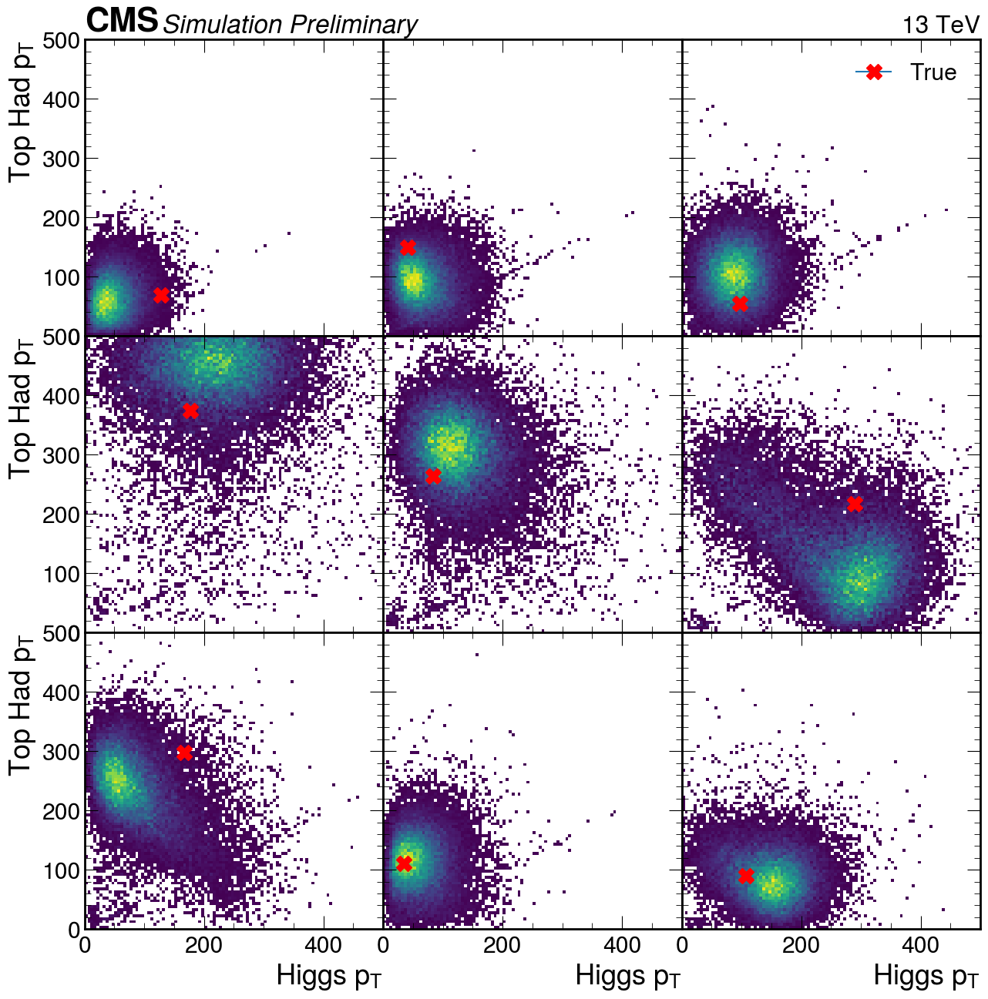

In [238]:
f, axs = plt.subplots(3, 3, figsize=(15, 15),dpi=100, sharex="col", sharey="row")
plt.subplots_adjust(wspace=0, hspace=0)

offset = 10

for i in range(3):
    for j in range(3):
        n = i*5 + j + offset
        axs[i][j].hist2d(Hs[n].pt.to_numpy(), t1s[n].pt.to_numpy(), range=((0,500),(0,500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].pt, t1[n].pt, marker="X", markersize=15,  markeredgecolor="red", markerfacecolor="red", label="True")
        #axs[i][j].plot(Hr[n].pt, t1r[n].pt, marker="X", markersize=15, markeredgecolor="yellow", markerfacecolor="yellow", label="Regressed")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $p_T$")
        if i==0 and j==0:
            hep.cms.label(rlabel="", llabel="Simulation Preliminary", loc=0, ax=axs[i][j],fontsize=24)
        if i==0 and j==2:
            hep.cms.label(rlabel="13 TeV", llabel="", loc=0, ax=axs[i][j],fontsize=24, exp="")
            axs[i][j].legend()
        if j == 0:
            axs[i][j].set_ylabel("Top Had $p_T$")
        

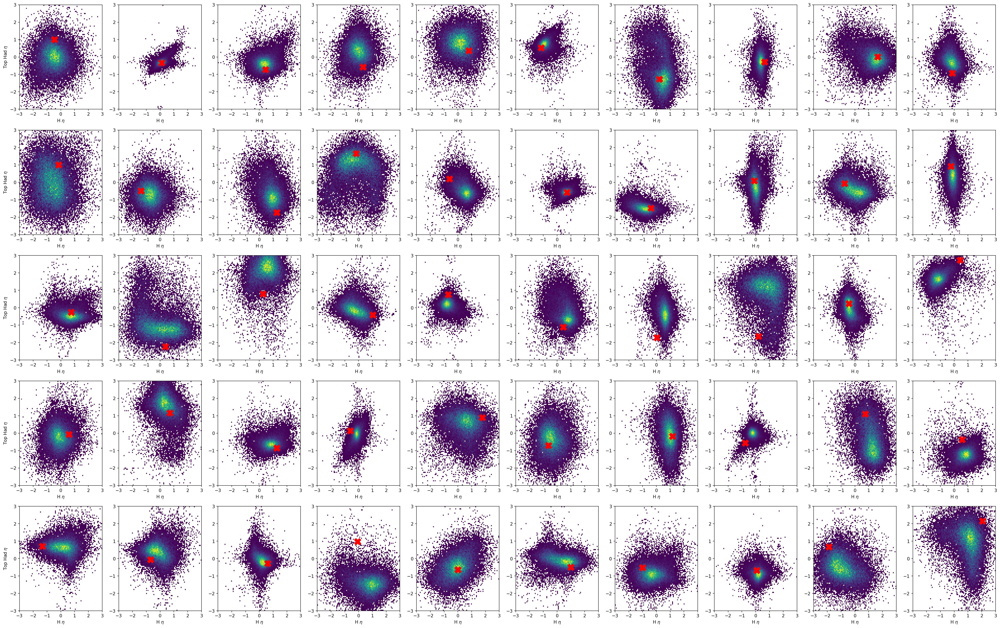

In [21]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].eta.to_numpy(), t1s[n].eta.to_numpy(), range=((-3,3),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].eta, t1[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("H $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top Had $\eta$")
        

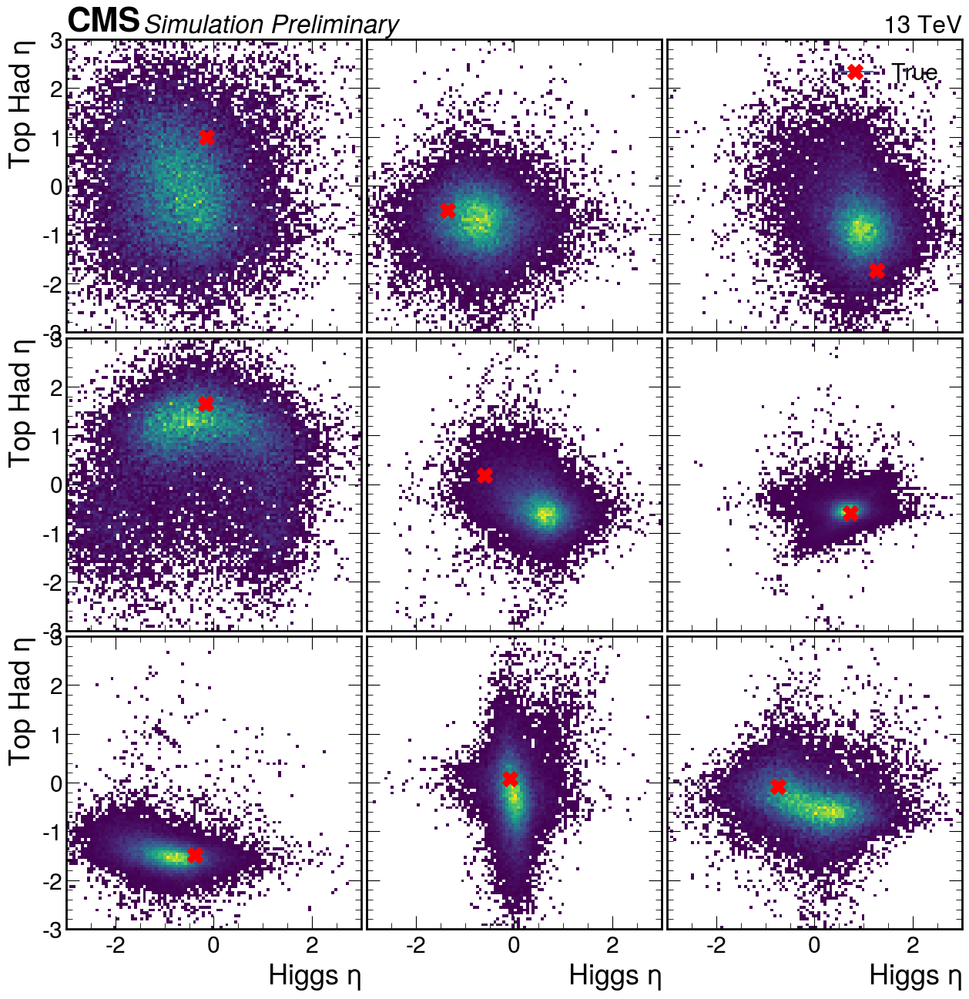

In [246]:
f, axs = plt.subplots(3, 3, figsize=(15, 15),dpi=100, sharex="col", sharey="row")
plt.subplots_adjust(wspace=0.02, hspace=0.02)

offset =10

for i in range(3):
    for j in range(3):
        n = i*3 + j + offset
        axs[i][j].hist2d(Hs[n].eta.to_numpy(), t1s[n].eta.to_numpy(), range=((-3,3),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].eta, t1[n].eta, marker="X", markersize=15,  markeredgecolor="red", markerfacecolor="red", label="True")
        #axs[i][j].plot(Hr[n].eta, t1r[n].eta, marker="X", markersize=15, markeredgecolor="yellow", markerfacecolor="yellow", label="Regressed")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $\eta$")
        if i==0 and j==0:
            hep.cms.label(rlabel="", llabel="Simulation Preliminary", loc=0, ax=axs[i][j],fontsize=24)
        if i==0 and j==2:
            hep.cms.label(rlabel="13 TeV", llabel="", loc=0, ax=axs[i][j],fontsize=24, exp="")
            axs[i][j].legend()
        if j == 0:
            axs[i][j].set_ylabel("Top Had $\eta$")
        
plt.savefig(f"{output}/tophad_eta_higgs_eta.pdf")
plt.savefig(f"{output}/tophad_eta_higgs_eta.png")

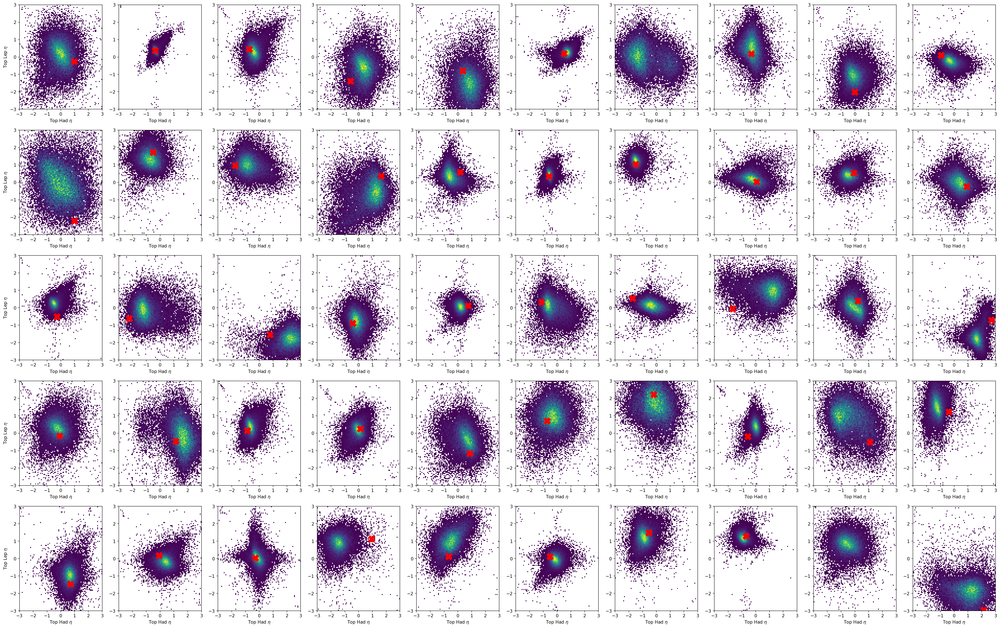

In [22]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t1s[n].eta.to_numpy(), t2s[n].eta.to_numpy(), range=((-3,3),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t1[n].eta, t2[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top Had $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top Lep $\eta$")
        

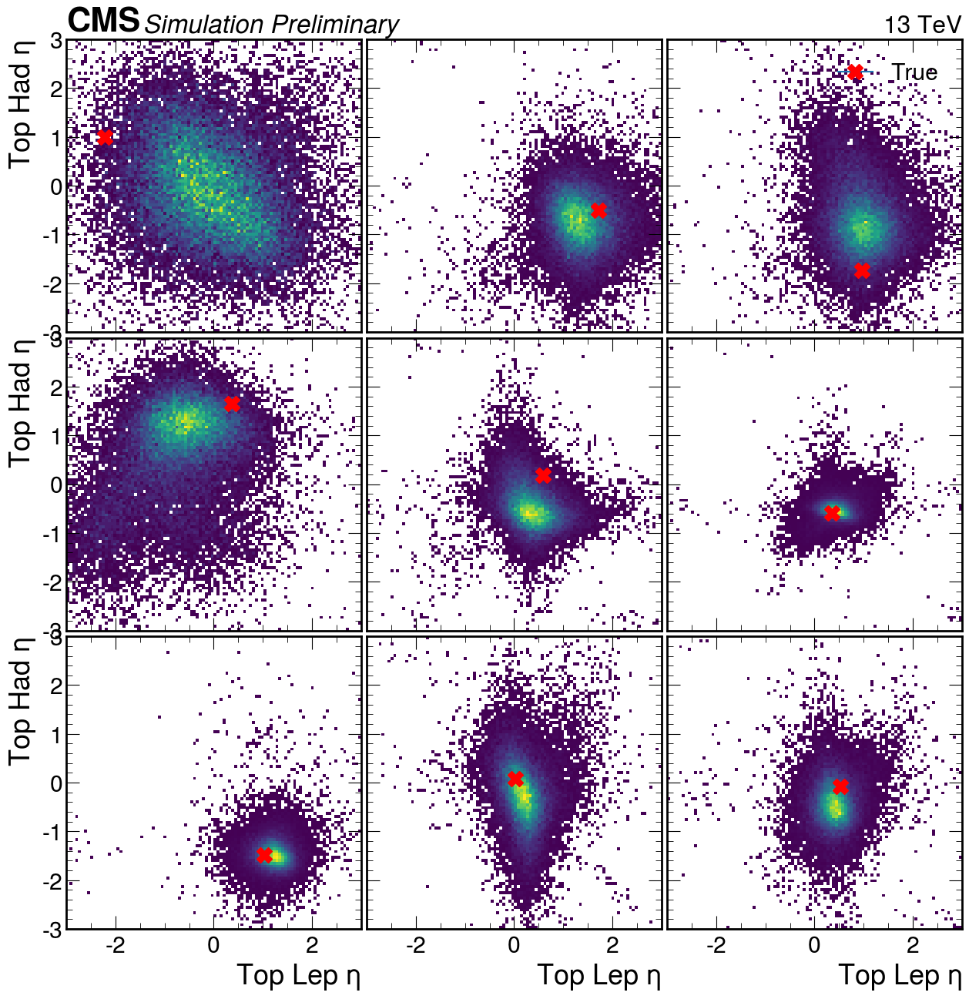

In [245]:
f, axs = plt.subplots(3, 3, figsize=(15, 15),dpi=100, sharex="col", sharey="row")
plt.subplots_adjust(wspace=0.02, hspace=0.02)

offset =10

for i in range(3):
    for j in range(3):
        n = i*3 + j + offset
        axs[i][j].hist2d(t2s[n].eta.to_numpy(), t1s[n].eta.to_numpy(), range=((-3,3),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t2[n].eta, t1[n].eta, marker="X", markersize=15,  markeredgecolor="red", markerfacecolor="red", label="True")
        #axs[i][j].plot(Hr[n].eta, t1r[n].eta, marker="X", markersize=15, markeredgecolor="yellow", markerfacecolor="yellow", label="Regressed")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top Lep $\eta$")
        if i==0 and j==0:
            hep.cms.label(rlabel="", llabel="Simulation Preliminary", loc=0, ax=axs[i][j],fontsize=24)
        if i==0 and j==2:
            hep.cms.label(rlabel="13 TeV", llabel="", loc=0, ax=axs[i][j],fontsize=24, exp="")
            axs[i][j].legend()
        if j == 0:
            axs[i][j].set_ylabel("Top Had $\eta$")
        
plt.savefig(f"{output}/tophad_eta_toplep_eta.pdf")
plt.savefig(f"{output}/tophad_eta_toplep_eta.png")

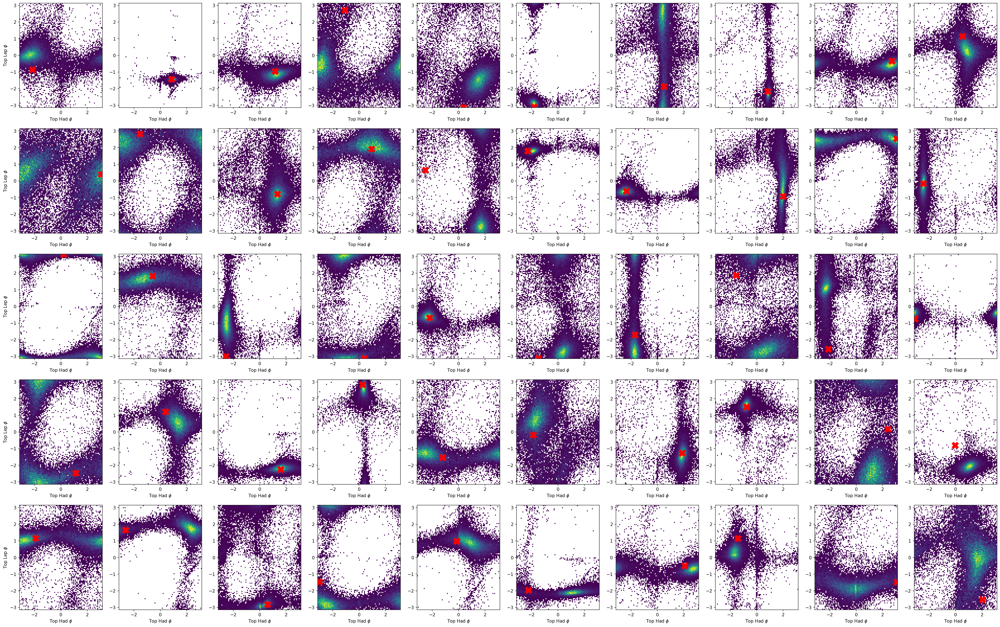

In [23]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].phi.to_numpy(), t1s[n].phi.to_numpy(), range=((-pi,pi),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].phi, t1[n].phi, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top Had $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Top Lep $\phi$")
        

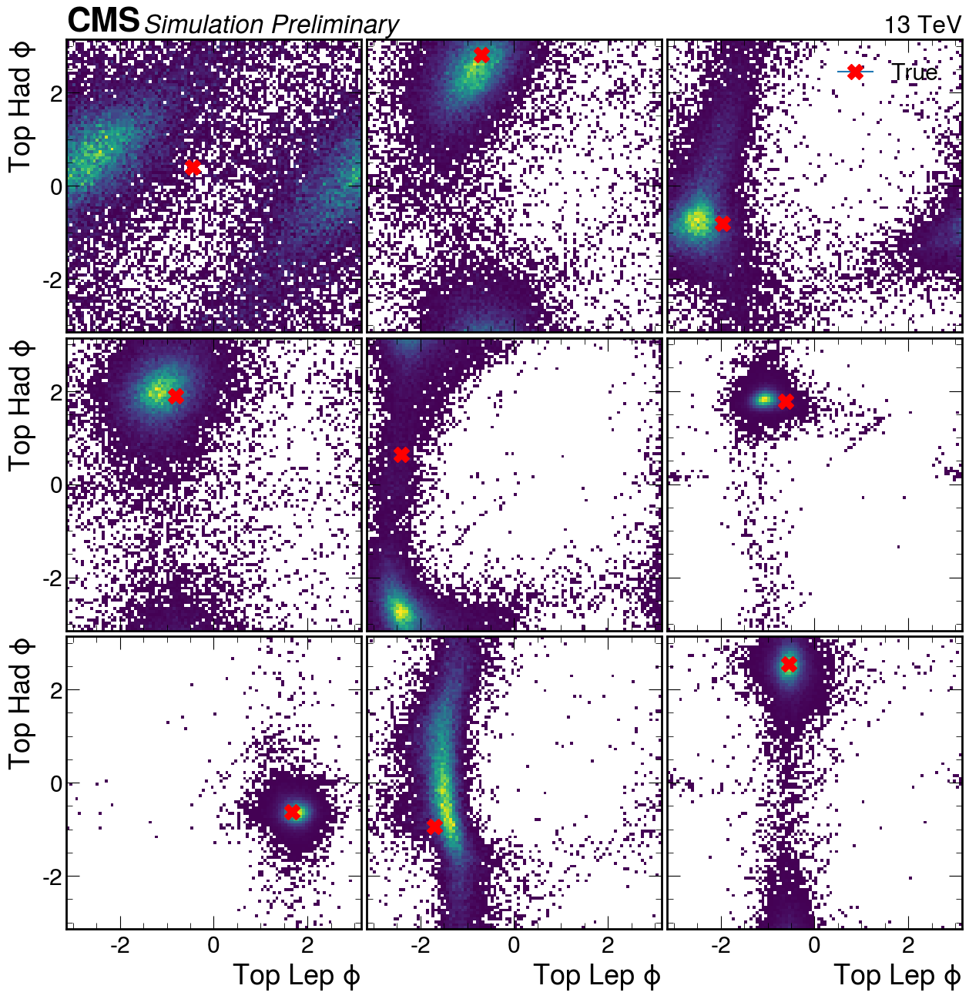

In [244]:
f, axs = plt.subplots(3, 3, figsize=(15, 15),dpi=100, sharex="col", sharey="row")
plt.subplots_adjust(wspace=0.02, hspace=0.02)

offset =10

for i in range(3):
    for j in range(3):
        n = i*3 + j + offset
        axs[i][j].hist2d(t2s[n].phi.to_numpy(), t1s[n].phi.to_numpy(), range=((-pi,pi),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t2[n].phi, t1[n].phi, marker="X", markersize=15,  markeredgecolor="red", markerfacecolor="red", label="True")
        #axs[i][j].plot(Hr[n].eta, t1r[n].eta, marker="X", markersize=15, markeredgecolor="yellow", markerfacecolor="yellow", label="Regressed")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top Lep $\phi$")
        if i==0 and j==0:
            hep.cms.label(rlabel="", llabel="Simulation Preliminary", loc=0, ax=axs[i][j],fontsize=24)
        if i==0 and j==2:
            hep.cms.label(rlabel="13 TeV", llabel="", loc=0, ax=axs[i][j],fontsize=24, exp="")
            axs[i][j].legend()
        if j == 0:
            axs[i][j].set_ylabel("Top Had $\phi$")
        
plt.savefig(f"{output}/tophad_phi_toplep_phi.pdf")
plt.savefig(f"{output}/tophad_phi_toplep_phi.png")

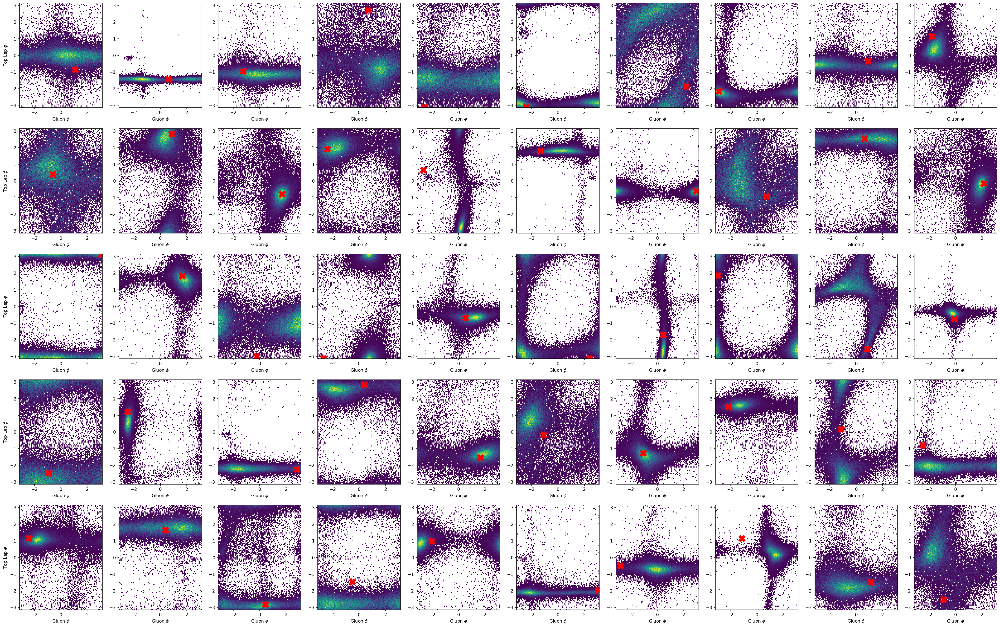

In [24]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(isrs[n].phi.to_numpy(), t1s[n].phi.to_numpy(), range=((-pi,pi),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(isr[n].phi, t1[n].phi, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Top Lep $\phi$")
        

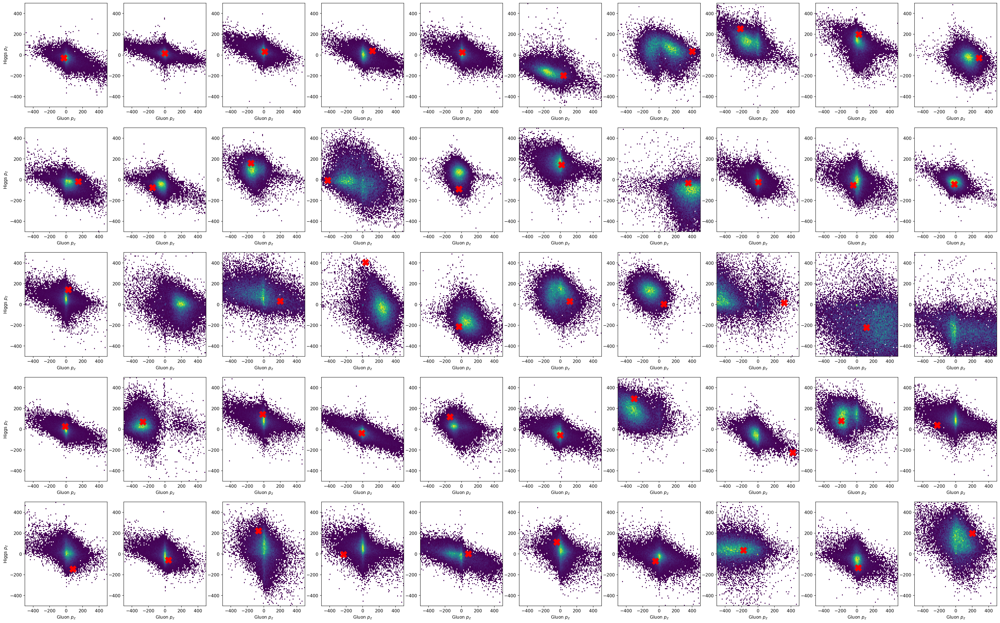

In [25]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(isrs[n].pz.to_numpy(), Hs[n].pz.to_numpy(), range=((-500,500),(-500,500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(isr[n].pz, H[n].pz, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon $p_z$")
        if j == 0:
            axs[i][j].set_ylabel("Higgs $p_z$")
        

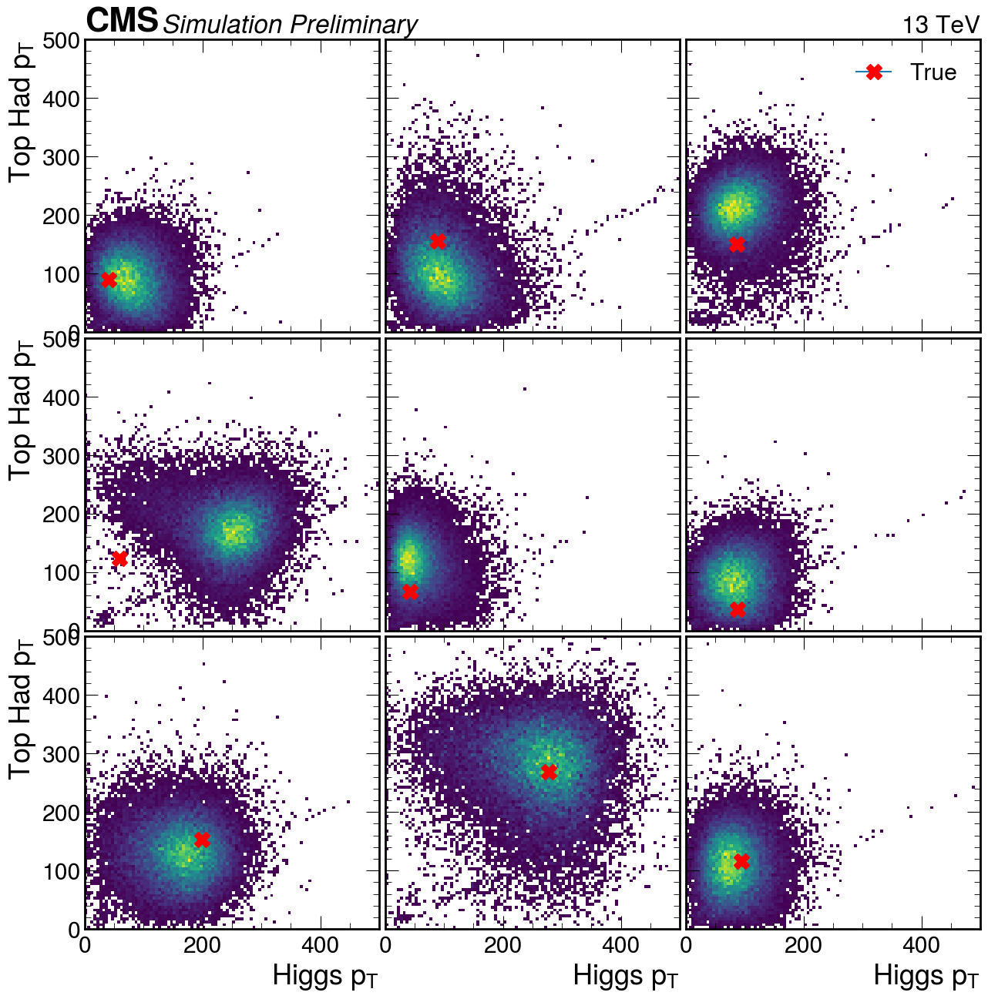

In [250]:
f, axs = plt.subplots(3, 3, figsize=(15, 15),dpi=100, sharex="col", sharey="row")
plt.subplots_adjust(wspace=0.02, hspace=0.02)

offset =30

for i in range(3):
    for j in range(3):
        n = i*3 + j + offset
        axs[i][j].hist2d(Hs[n].pt.to_numpy(), t1s[n].pt.to_numpy(), range=((0,500),(0,500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].pt, t1[n].pt, marker="X", markersize=15,  markeredgecolor="red", markerfacecolor="red", label="True")
        #axs[i][j].plot(Hr[n].eta, t1r[n].eta, marker="X", markersize=15, markeredgecolor="yellow", markerfacecolor="yellow", label="Regressed")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $p_T$")
        if i==0 and j==0:
            hep.cms.label(rlabel="", llabel="Simulation Preliminary", loc=0, ax=axs[i][j],fontsize=24)
        if i==0 and j==2:
            hep.cms.label(rlabel="13 TeV", llabel="", loc=0, ax=axs[i][j],fontsize=24, exp="")
            axs[i][j].legend()
        if j == 0:
            axs[i][j].set_ylabel("Top Had $p_T$")
        
plt.savefig(f"{output}/tophad_pt_higgs_pt.pdf")
plt.savefig(f"{output}/tophad_pt_higgs_pt.png")

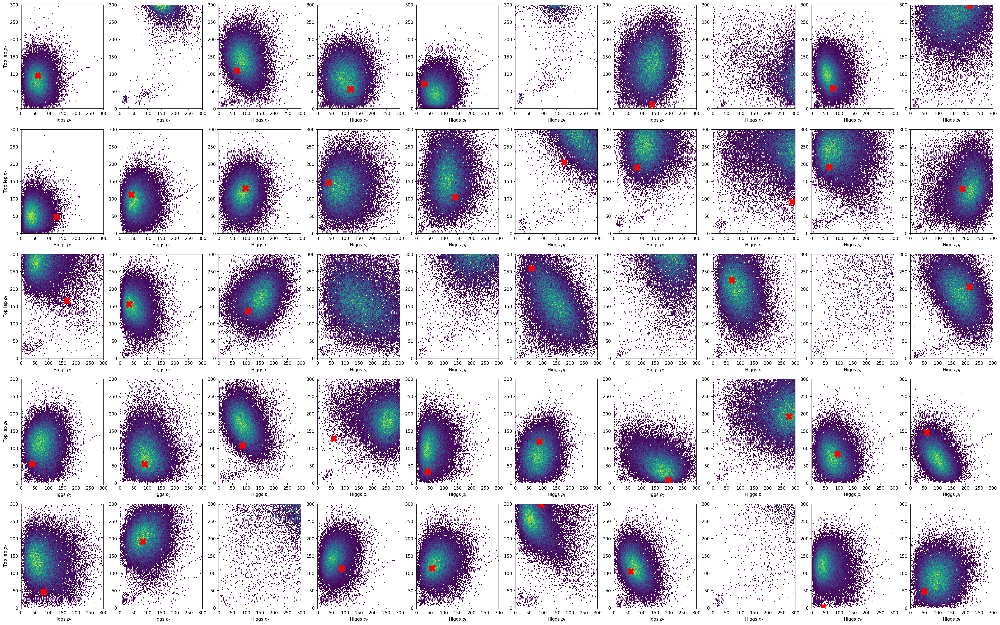

In [26]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].pt.to_numpy(), t2s[n].pt.to_numpy(), range=((0,300),(0,300)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].pt, t2[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $p_t$")
        if j == 0:
            axs[i][j].set_ylabel("Top lep $p_t$")
        

# Scatter singola particella

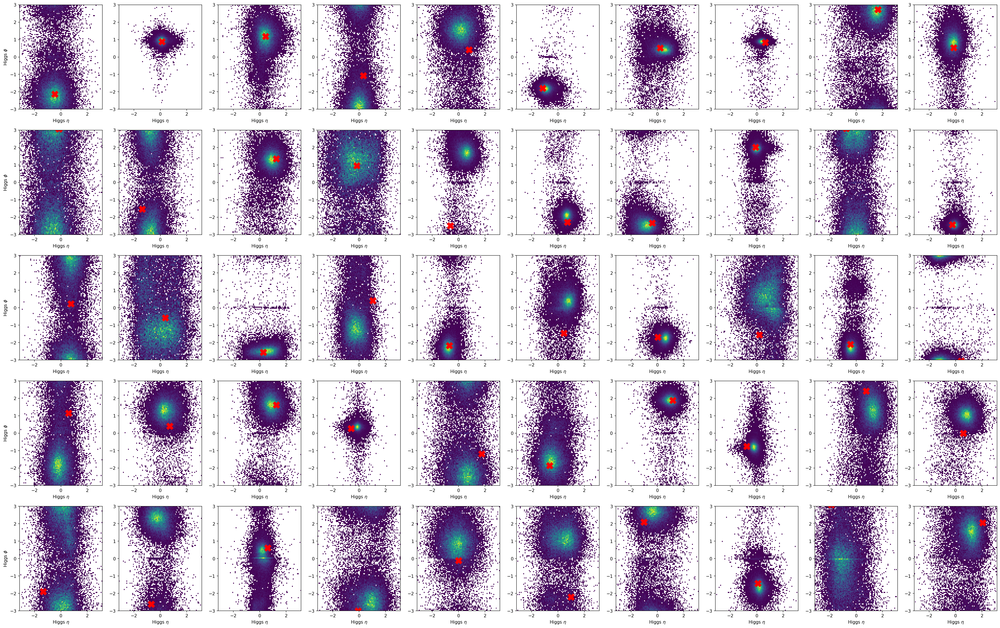

In [34]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].eta.to_numpy(), Hs[n].phi.to_numpy(), range=((-pi,pi),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].eta, H[n].phi, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Higgs $\phi$")
        

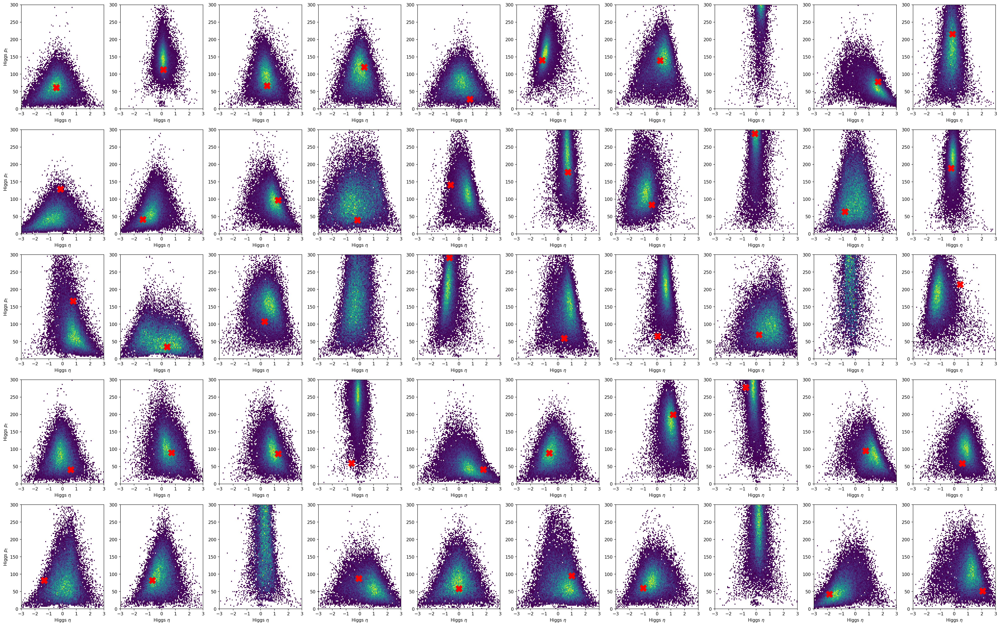

In [28]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(Hs[n].eta.to_numpy(), Hs[n].pt.to_numpy(), range=((-3,3),(0, 300)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(H[n].eta, H[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Higgs $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Higgs $p_t$")
        

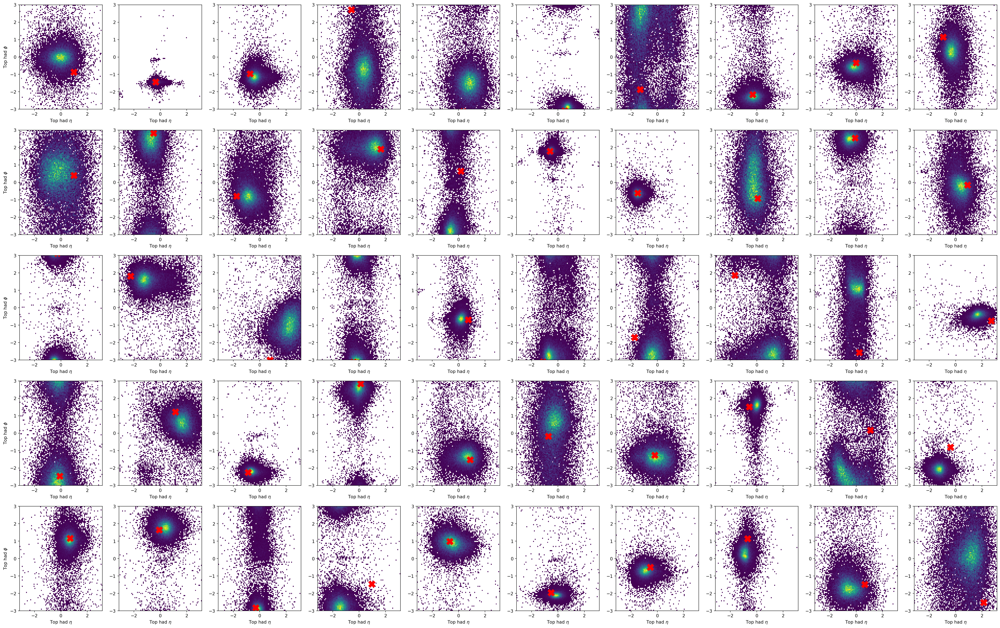

In [35]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t1s[n].eta.to_numpy(), t1s[n].phi.to_numpy(), range=((-pi,pi),(-3,3)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t1[n].eta, t1[n].phi, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].phi, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top had $\phi$")
        

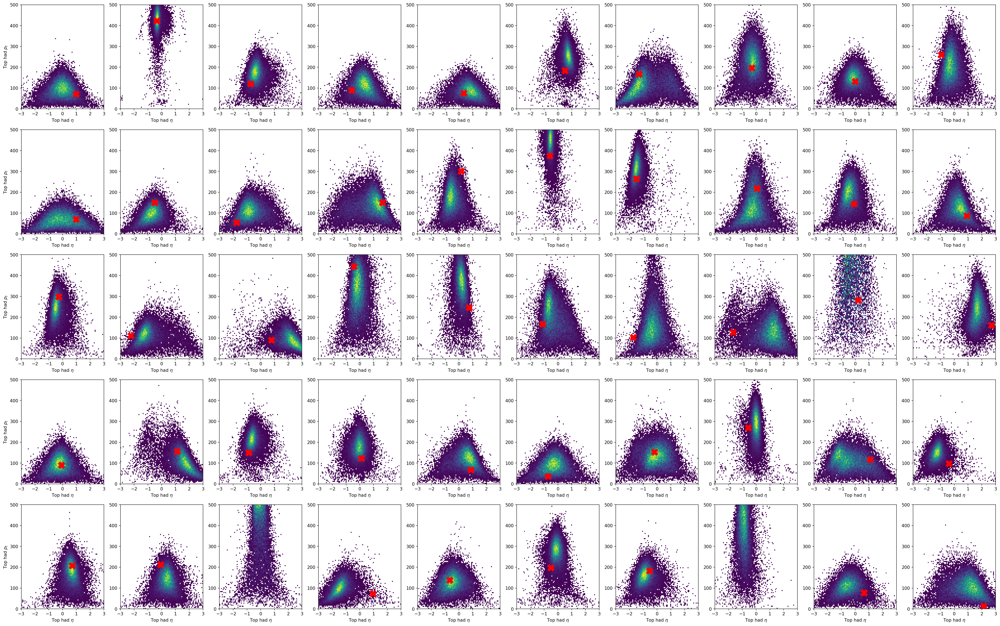

In [30]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t1s[n].eta.to_numpy(), t1s[n].pt.to_numpy(), range=((-3,3),(0, 500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t1[n].eta, t1[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top had $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top had $p_t$")
        

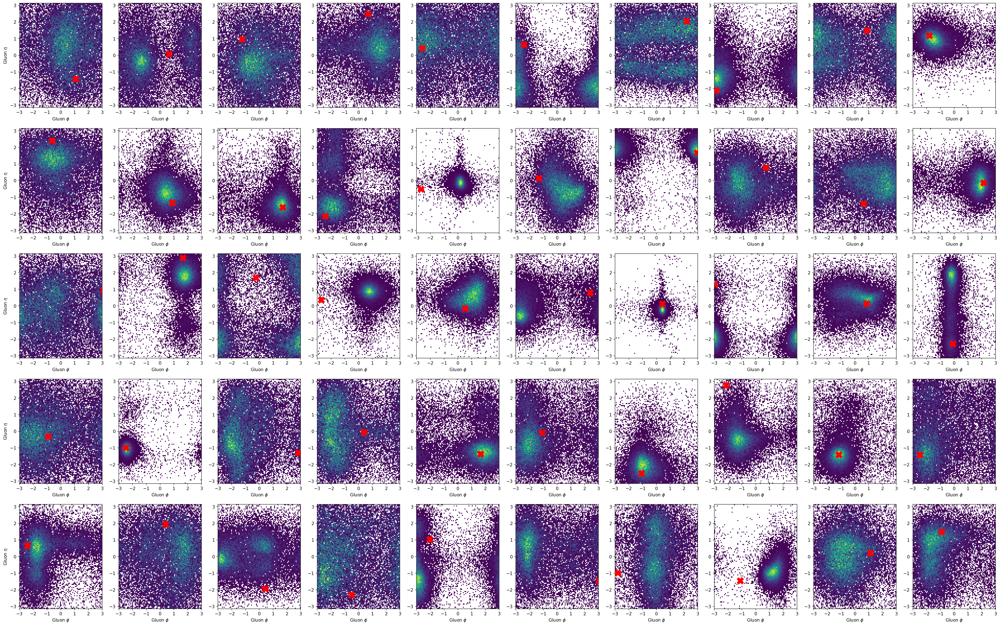

In [31]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(isrs[n].phi.to_numpy(), isrs[n].eta.to_numpy(), range=((-3,3),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(isr[n].phi, isr[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Gluon $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Gluon $\eta$")
        

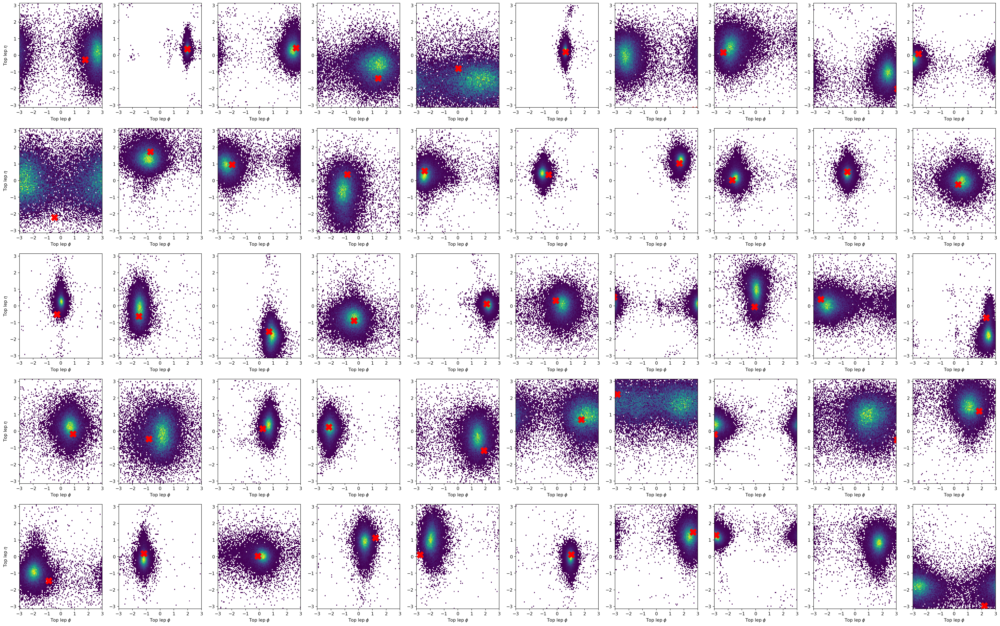

In [32]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t2s[n].phi.to_numpy(), t2s[n].eta.to_numpy(), range=((-3,3),(-pi,pi)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t2[n].phi, t2[n].eta, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top lep $\phi$")
        if j == 0:
            axs[i][j].set_ylabel("Top lep $\eta$")
        

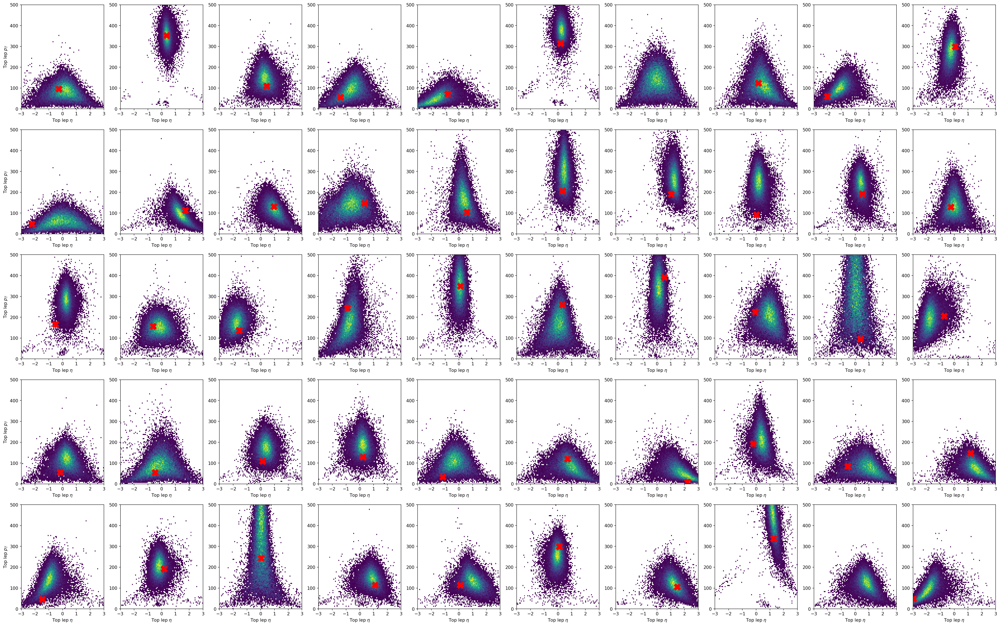

In [33]:
f, axs = plt.subplots(5, 10, figsize=(40, 25),dpi=150)

for i in range(5):
    for j in range(10):
        n = i*10 + j
        axs[i][j].hist2d(t2s[n].eta.to_numpy(), t2s[n].pt.to_numpy(), range=((-3,3),(0,500)), bins=100, cmin=1, cmap="viridis");
        axs[i][j].plot(t2[n].eta, t2[n].pt, marker="X", markersize=15, markeredgecolor="red", markerfacecolor="red")
        #axs[i][j].axvline(H[n].eta, c="red", label="Truth")
        axs[i][j].set_xlabel("Top lep $\eta$")
        if j == 0:
            axs[i][j].set_ylabel("Top lep $p_T$")
        

# Regression after the flow

In [33]:
basedir_flow

'/work/dvalsecc/MEM/models_archive/flow_labframe_sampling/best/best_flow_sampling_v3f/'

In [10]:
import h5py
df = h5py.File(f"{basedir_flow}/samples_30_allevents.hdf5")

In [11]:
df.keys()

<KeysViewHDF5 ['boost', 'flow_samples', 'logprob', 'part_CM_Epxpypz', 'part_lab_ptetaphi', 'ps']>

In [12]:
(higgs_regr_CM, thad_regr_CM, tlep_regr_CM, isr_regr_CM) = get_particle_awkward(torch.from_numpy(df["part_CM_Epxpypz"][()] )) # it is in the CM
boost_regr = torch.from_numpy(df['boost'][()])
boost_regr = boost_regr*log_std_boost.to("cpu") + log_mean_boost.to("cpu") 
boost_regr[:,0] = torch.exp(boost_regr[:,0]) - 1

In [13]:
# Need to unscale the particle in the lab
partons_lab = torch.from_numpy(df["part_lab_ptetaphi"][()])
partons_lab = partons_lab*log_std_parton_lab.to("cpu")  + log_mean_parton_lab.to("cpu") 
partons_lab[:,:,0] = torch.exp(partons_lab[:,:, 0]) - 1
(higgs_regr_lab, thad_regr_lab, tlep_regr_lab, isr_regr_lab) = get_particle_awkward_ptetaphi(partons_lab)

In [38]:
delta_pt = higgs_regr_CM.pt - higgsCorrect.pt

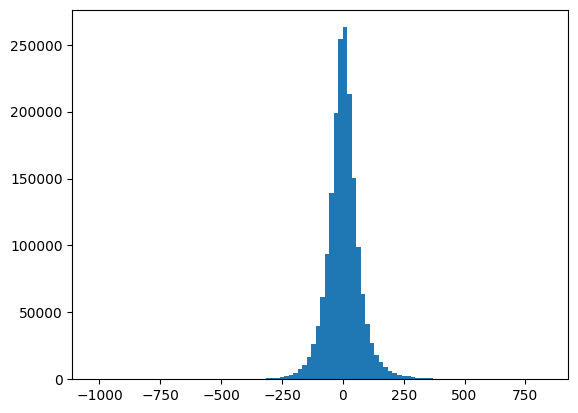

In [39]:
plt.hist(delta_pt, bins=100);

In [25]:
delta_pt.to_numpy()

array([  -9.81899587,   24.79756265,   12.37453488, ...,   16.84044091,
        -96.53572661, -127.50057696])

## Higgs

Text(0.5, 1.0, 'ISR')

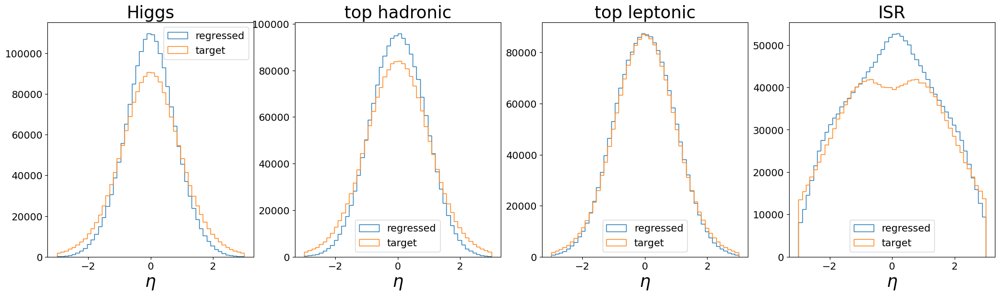

In [14]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(higgs_regr_CM.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[0].hist(higgsCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$\eta$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(thad_regr_CM.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[1].hist(thadCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$\eta$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(tlep_regr_CM.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[2].hist(tlepCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$\eta$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isr_regr_lab.eta, bins=50, range=(-3,3), histtype="step", label="regressed");
axs[3].hist(glISRCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$\eta$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

Text(0.5, 1.0, 'ISR')

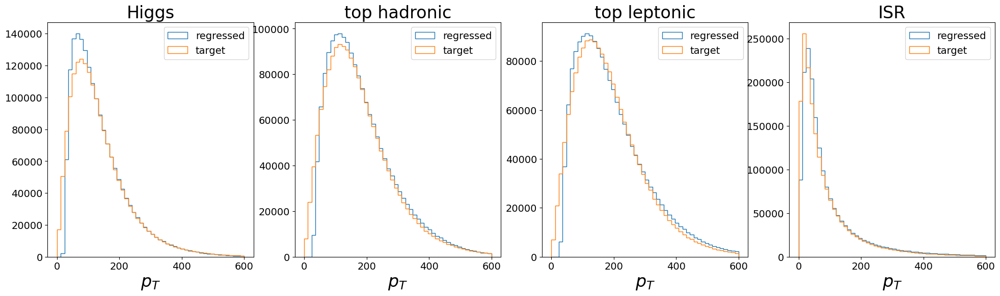

In [15]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(higgs_regr_CM.pt, bins=50, range=(0, 600), histtype="step", label="regressed");
axs[0].hist(higgsCorrect.pt, bins=50, range=(0, 600), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$p_T$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(thad_regr_CM.pt, bins=50, range=(0, 600), histtype="step", label="regressed");
axs[1].hist(thadCorrect.pt, bins=50, range=(0, 600), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$p_T$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(tlep_regr_CM.pt, bins=50, range=(0, 600), histtype="step", label="regressed");
axs[2].hist(tlepCorrect.pt, bins=50, range=(0, 600), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$p_T$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isr_regr_lab.pt, bins=50, range=(0, 600), histtype="step", label="regressed");
axs[3].hist(glISRCorrect.pt, bins=50, range=(0, 600), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$p_T$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

Text(0.5, 1.0, 'ISR')

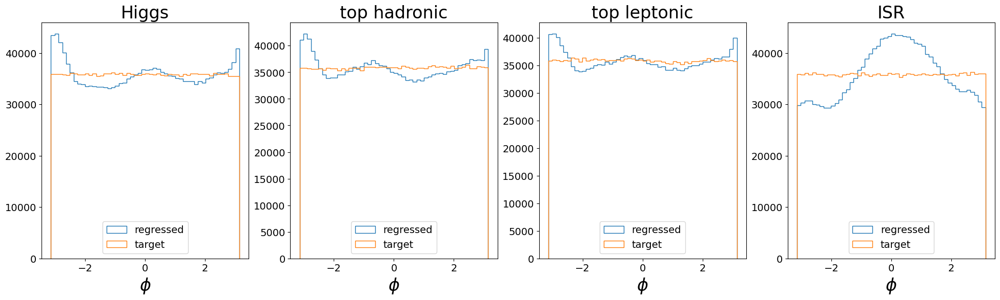

In [16]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(higgs_regr_CM.phi, bins=50, range=(-pi, pi), histtype="step", label="regressed");
axs[0].hist(higgsCorrect.phi, bins=50, range=(-pi, pi), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$\phi$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(thad_regr_CM.phi, bins=50, range=(-pi, pi), histtype="step", label="regressed");
axs[1].hist(thadCorrect.phi, bins=50, range=(-pi, pi), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$\phi$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(tlep_regr_CM.phi, bins=50, range=(-pi, pi), histtype="step", label="regressed");
axs[2].hist(tlepCorrect.phi, bins=50, range=(-pi, pi), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$\phi$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isr_regr_lab.phi, bins=50, range=(-pi, pi), histtype="step", label="regressed");
axs[3].hist(glISRCorrect.phi, bins=50, range=(-pi, pi), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$\phi$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

In [17]:
from numba import jit
@jit(nopython=True)
def get_central_smallest_interval(array, xrange, nbins, Ntrial=10000, perc=0.68):
    H = np.histogram(array, bins=nbins, range=xrange)
        # trying to smooth out noisy histo

    xmax_l = H[1][np.argmax(H[0])-5]
    xmax_h = H[1][np.argmax(H[0])+5]
    xmax = np.mean(array[(array>xmax_l)&(array<xmax_h)])
    
    deltax = (xrange[1]-xrange[0])/(2*Ntrial)

    absmax = np.quantile(array, 0.995)
    absmin = np.quantile(array, 0.005)
    
    N = array.shape[0]
    xd = xmax-deltax
    xu = xmax+deltax
    for i in range(Ntrial):
        q = np.sum((array>xd) &(array<xu))/ N
        if q>=perc: 
            break
        if xd > absmin:
            xd = xd-deltax
        if xu < absmax:
            xu = xu+deltax
    return xmax, xd, xu

In [18]:
import mplhep as hep
plt.style.use(hep.style.CMS)

def plot_diff_mode_quantile(Y, X, cat_var, bins,
                      xlabel='', ylabel='', title='', debug=False,
                    xlim=None, ylim=None, nbins_mode=100, output_file=None):
    
    Y_mode  = []
    X_avg = []
    quantile_right_list = []
    quantile_left_list = []
    quantile_right_list_95 = []
    quantile_left_list_95 = []

    for i in range(len(bins)-1):
        mask = ((cat_var >= bins[i])&(cat_var< bins[i+1]))
        Ymask = Y[mask]
        X_avg.append(np.mean(X[mask]))

        #print((np.min(Ymask), np.max(Ymask)))
        mode, left, right = get_central_smallest_interval(Ymask, xrange=(np.quantile(Ymask, 0.03), np.quantile(Ymask, 0.97)),
                                      nbins=Ymask.size//nbins_mode, Ntrial=2000, perc=0.68)

        _, left95, right95 = get_central_smallest_interval(Ymask, xrange=(np.quantile(Ymask, 0.03), np.quantile(Ymask, 0.97)),
                                      nbins=Ymask.size//nbins_mode, Ntrial=2000, perc=0.95)

        if debug:
            f = plt.figure()
            plt.hist(Ymask, range=(np.quantile(Ymask, 0.03), np.quantile(Ymask, 0.97)),   bins=Ymask.size//100, histtype="step")
            plt.axvline(left, c='r', label="0.68")
            plt.axvline(right, c='r')
            plt.axvline(left95, c='orange', label="0.95")
            plt.axvline(right95, c='orange')
            plt.axvline(mode, label="mode", c="green")
            plt.title(f"Bins {bins[i]:.2f}-{bins[i+1]:.2}")
            plt.legend()
            plt.show()

        
        Y_mode.append(mode)
        quantile_left_list.append(left)
        quantile_right_list.append(right)
        quantile_left_list_95.append(left95)
        quantile_right_list_95.append(right95)
        #print(Y_mode, left, right)

    offset_left = np.array(Y_mode) - np.array(quantile_left_list) # need offset
    offset_right = np.array(quantile_right_list) - np.array(Y_mode)
    
    offset_left_95 = np.array(Y_mode) - np.array(np.array(quantile_left_list_95)) # need offset
    offset_right_95 = np.array(quantile_right_list_95) - np.array(Y_mode)

    plt.tight_layout()
    f  = plt.figure(figsize=(7,6), dpi=150)
    ax = plt.gca()
    
    ax.plot(X_avg, Y_mode, linestyle='-', marker='o', color='k', label="mode")
    ax.grid(axis="y")
        
    ax.fill_between(X_avg, Y_mode - offset_left, Y_mode + offset_right,
                     color='r', alpha=0.2, label='68% CL')
    ax.fill_between(X_avg, Y_mode - offset_left_95, Y_mode + offset_right_95,
                     color='b', alpha=0.15, label='95% CL')
    ax.legend(facecolor='white',framealpha=1, fontsize=16 )
    ax.set_xlabel(xlabel, fontsize=17)
    ax.set_ylabel(ylabel, fontsize=17)
    ax.tick_params(axis='both', which='major', labelsize=15)
    if xlim:
        ax.set_xlim(*xlim)
    if ylim:
        ax.set_ylim(*ylim)
    ax.text(0.2, 0.9, title, fontsize=22, transform=ax.transAxes)
    hep.cms.label(rlabel="13 TeV",  llabel="Simulation Preliminary", loc=0, ax=ax,fontsize=20)
    if output_file:
        plt.savefig(output_file +".png")
        plt.savefig(output_file +".pdf")

In [85]:
hep.cms.label?

Signature: hep.cms.label(label=None, **kwargs)
Docstring:
A convenience wrapper combining ``<exp>.text`` and ``lumitext`` providing for
the most common use cases.
Parameters
----------
    loc : int, optional
        Label position of ``exp_text`` label:
        - 0 : Above axes, left aligned
        - 1 : Top left corner
        - 2 : Top left corner, multiline
        - 3 : Split EXP above axes, rest of label in top left corner"
        - 4 : (1) Top left corner, but align "rlabel" underneath
    ax : matplotlib.axes.Axes, optional
        Axes object (if None, last one is fetched)
    data : bool, optional
        Prevents prepending "Simulation" to experiment label. Default ``False``.
    label : str, optional
        Text to append after <exp> (Simulation) <label>. Typically "Preliminary"
        "Supplementary", "Private Work" or "Work in Progress"
    year : int, optional
        Year when data was collected
    lumi : float, optional
        Aggregate luminosity shown. Should r

In [20]:
output = "plots/v9-sampling-regr"
os.makedirs(output, exist_ok=True)

<Figure size 1000x1000 with 0 Axes>

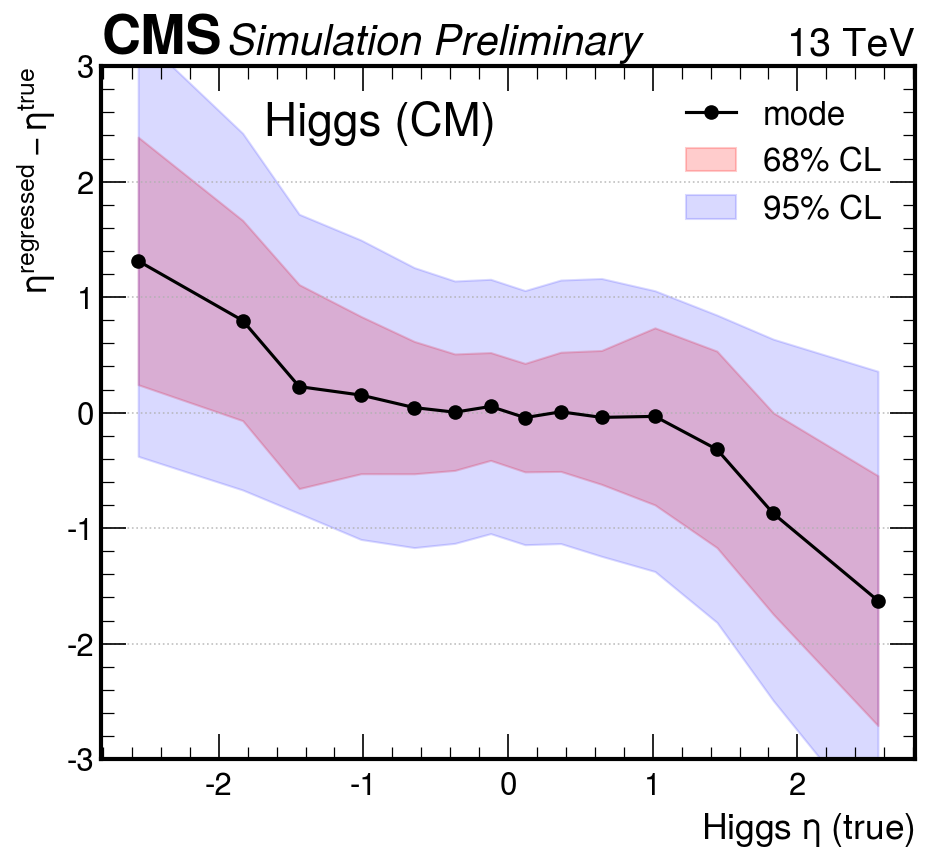

In [21]:
plot_diff_mode_quantile((higgs_regr_CM.eta - higgsCorrect.eta ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Higgs (CM)',nbins_mode=50,
                        output_file=output+"/Higgs_regression_CM_deltaEta_byEta")

<Figure size 1000x1000 with 0 Axes>

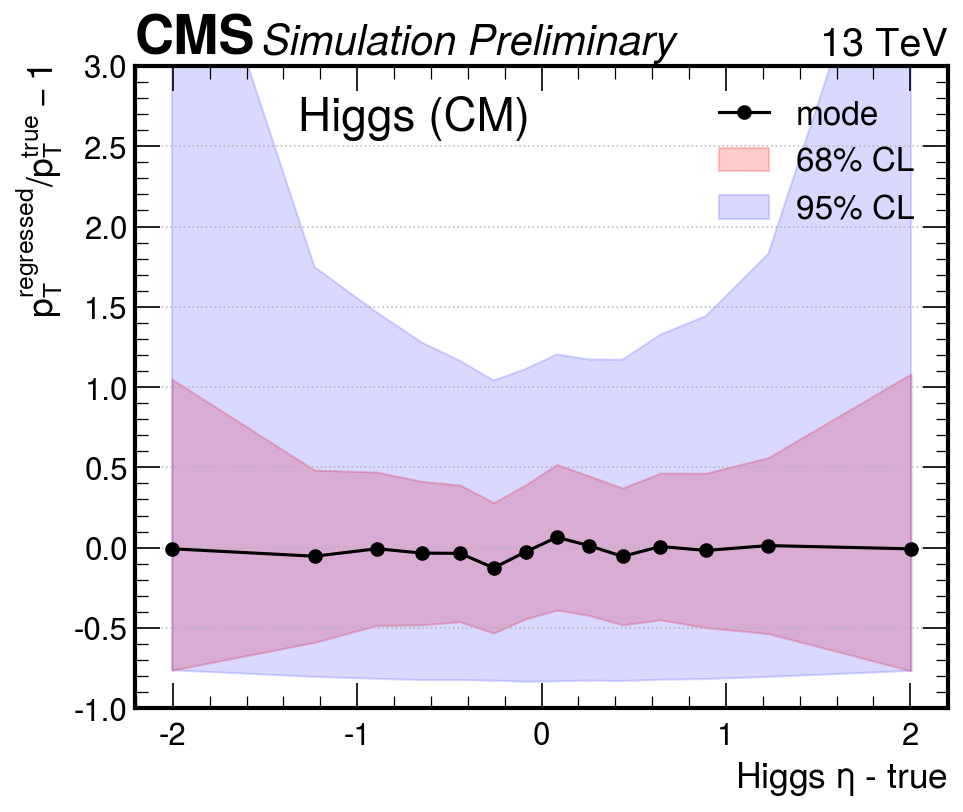

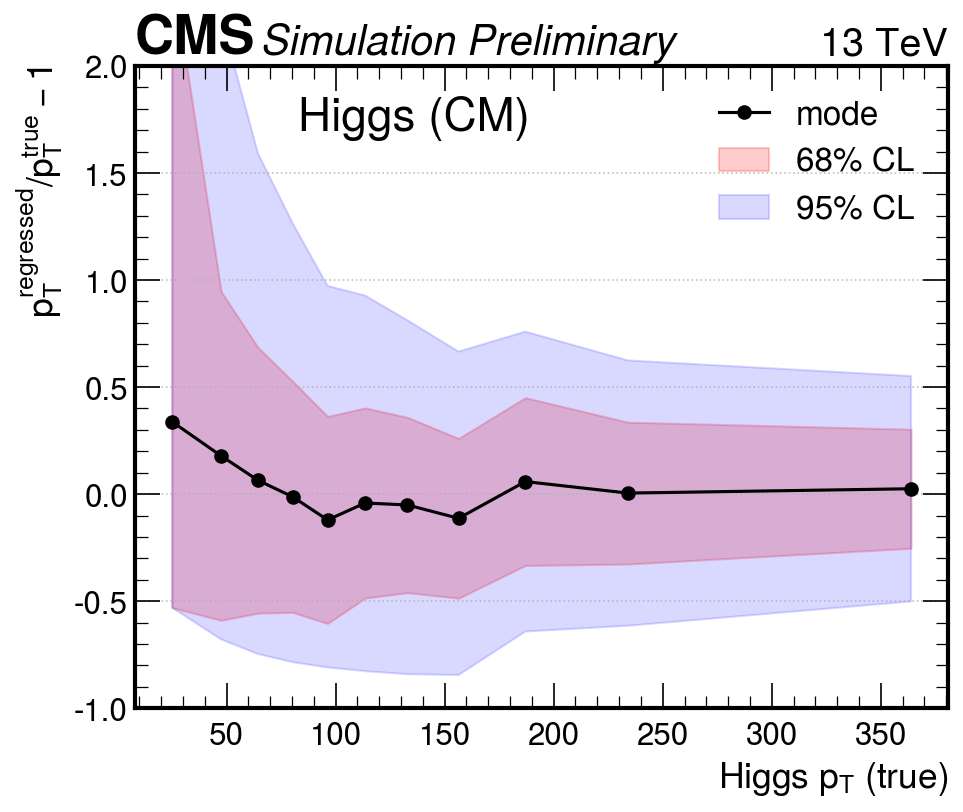

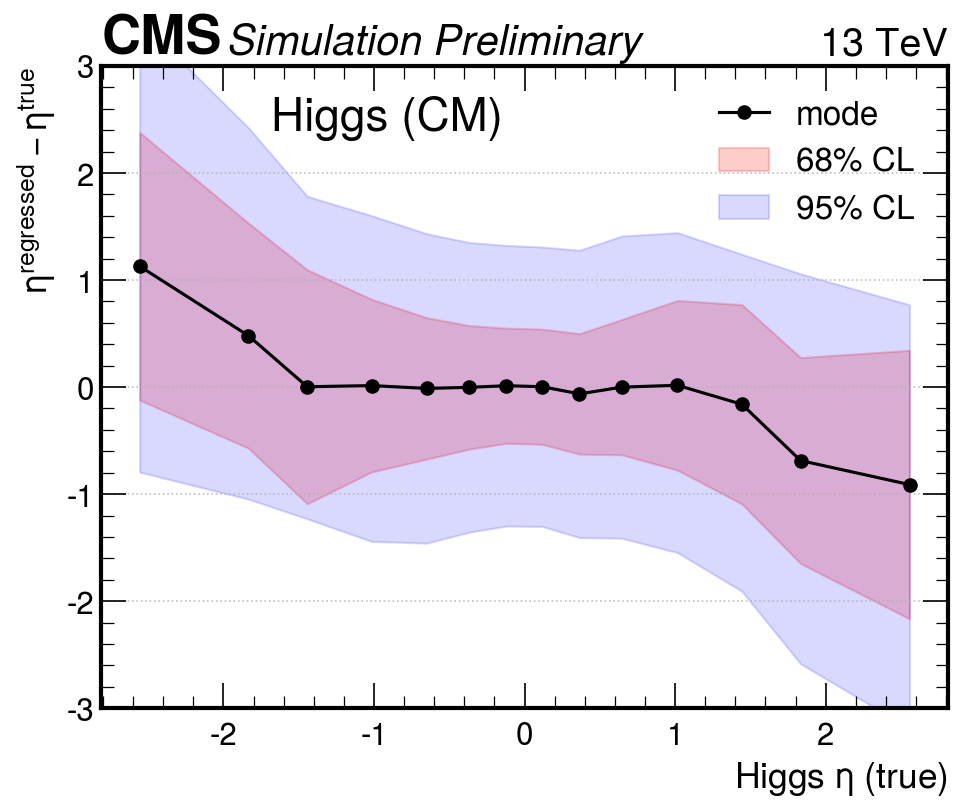

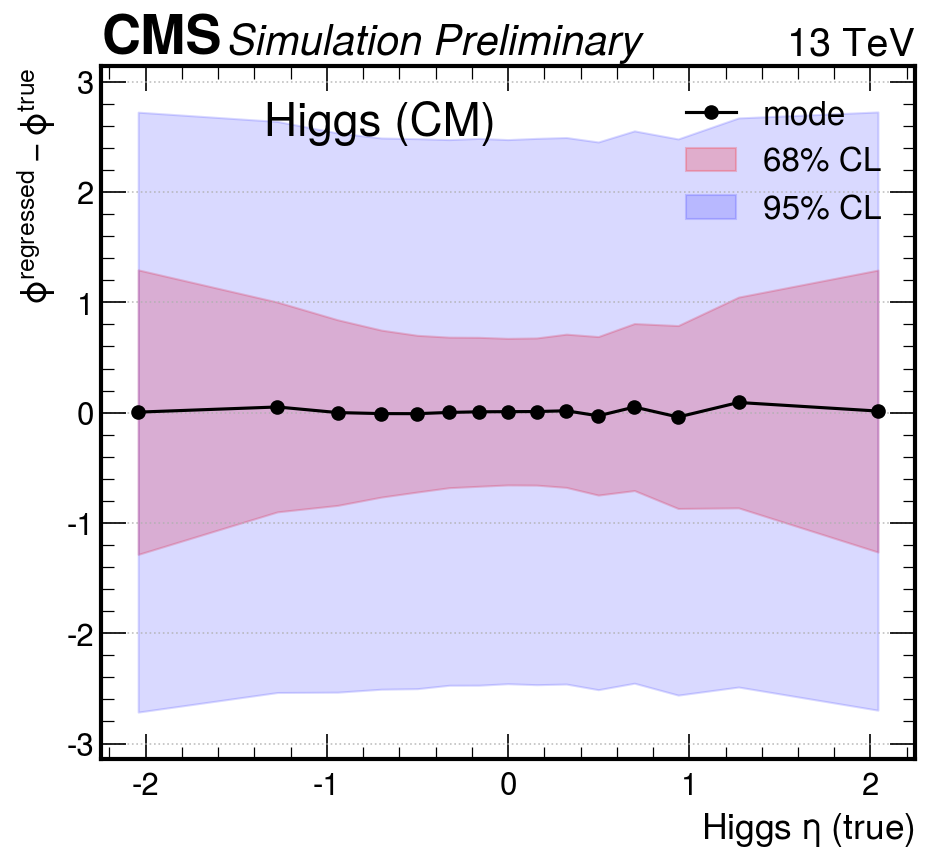

In [172]:
plot_diff_mode_quantile((higgs_regr_CM.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Higgs $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Higgs (CM)',
                       output_file=output+"/Higgs_regression_CM_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((higgs_regr_CM.pt/ higgsCorrect.pt  -1 ).to_numpy(), 
                        X=higgsCorrect.pt.to_numpy(),  
                        cat_var=higgsCorrect.pt.to_numpy(), 
                        bins=np.quantile(higgsCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Higgs $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Higgs (CM)',nbins_mode=100,
                        output_file=output+"/Higgs_regression_CM_deltaPt_byPt")

plot_diff_mode_quantile((higgs_regr_CM.eta - higgsCorrect.eta ).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Higgs (CM)',nbins_mode=50,
                        output_file=output+"/Higgs_regression_CM_deltaEta_byEta")

plot_diff_mode_quantile(higgs_regr_CM.deltaphi(higgsCorrect).to_numpy(), 
                        X=higgsCorrect.eta.to_numpy(),  
                        cat_var=higgsCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect.eta.to_numpy(), np.linspace(0,1,16)),nbins_mode=100,
                        xlabel='Higgs $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Higgs (CM)',
                        output_file=output+"/Higgs_regression_CM_deltaPhi_byEta")

<Figure size 1000x1000 with 0 Axes>

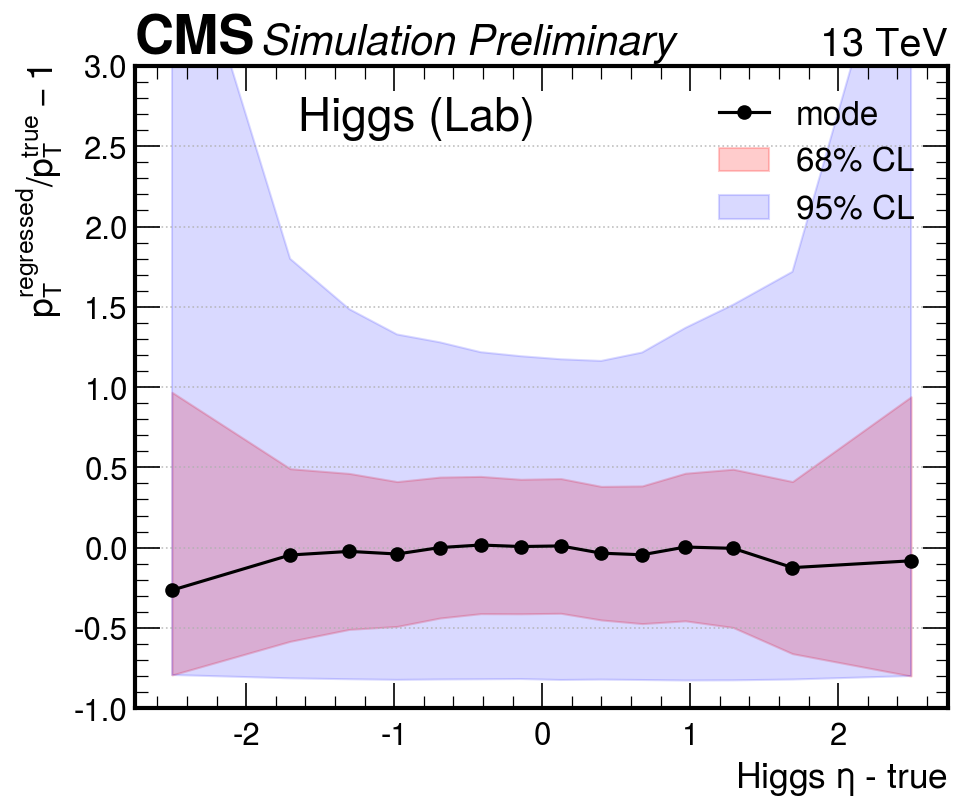

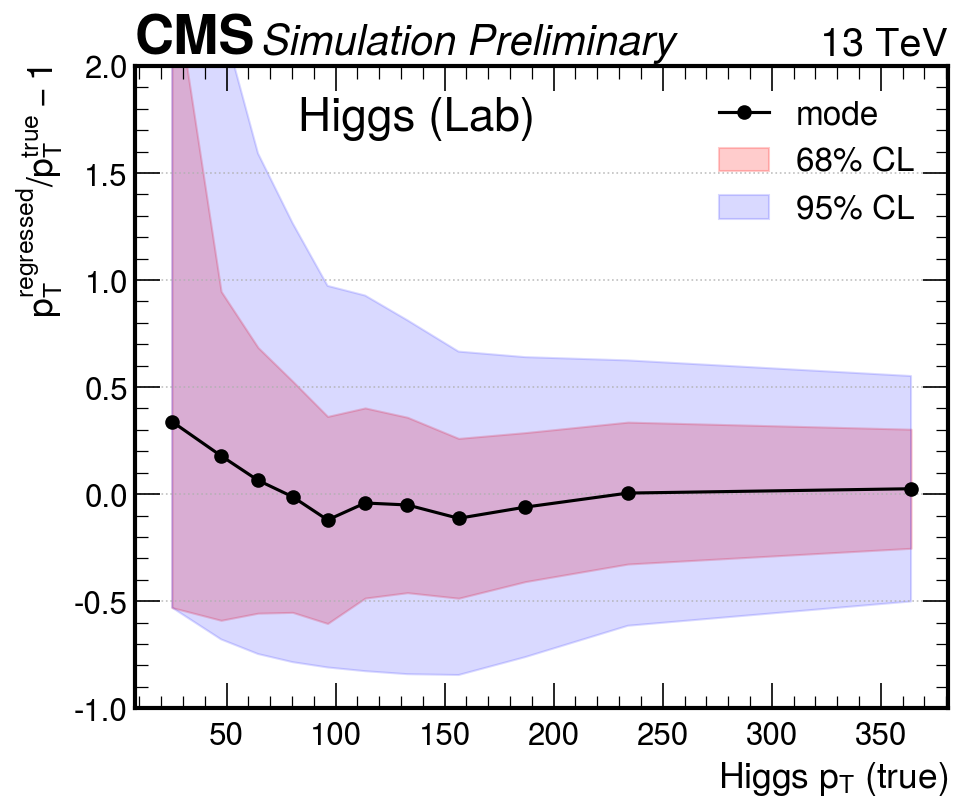

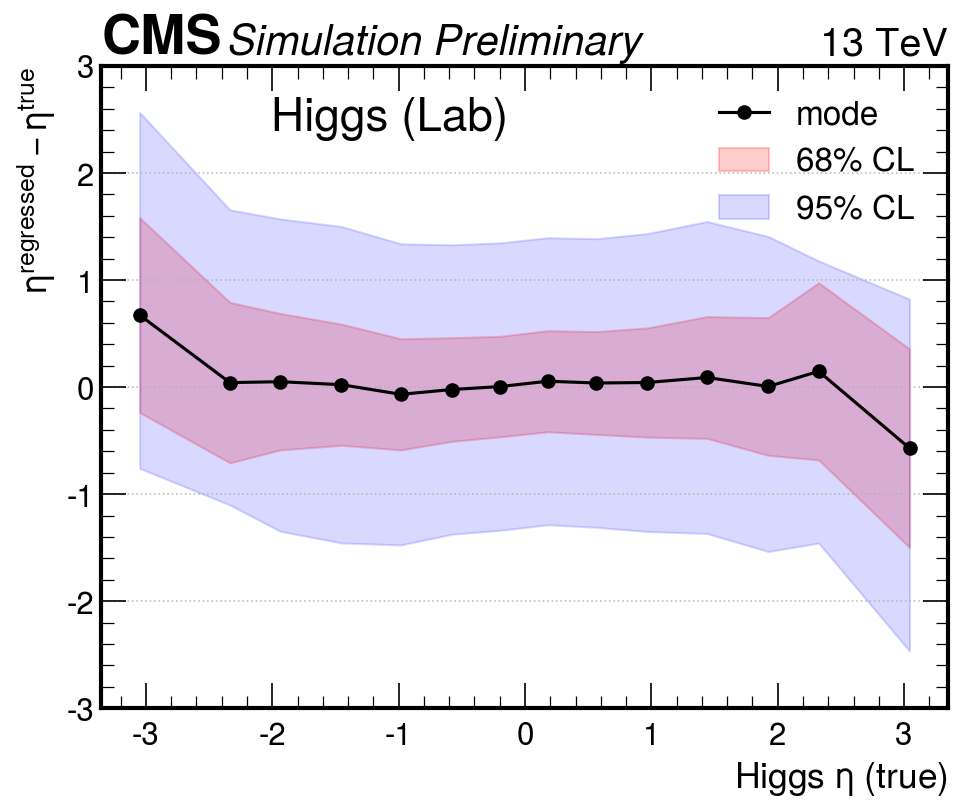

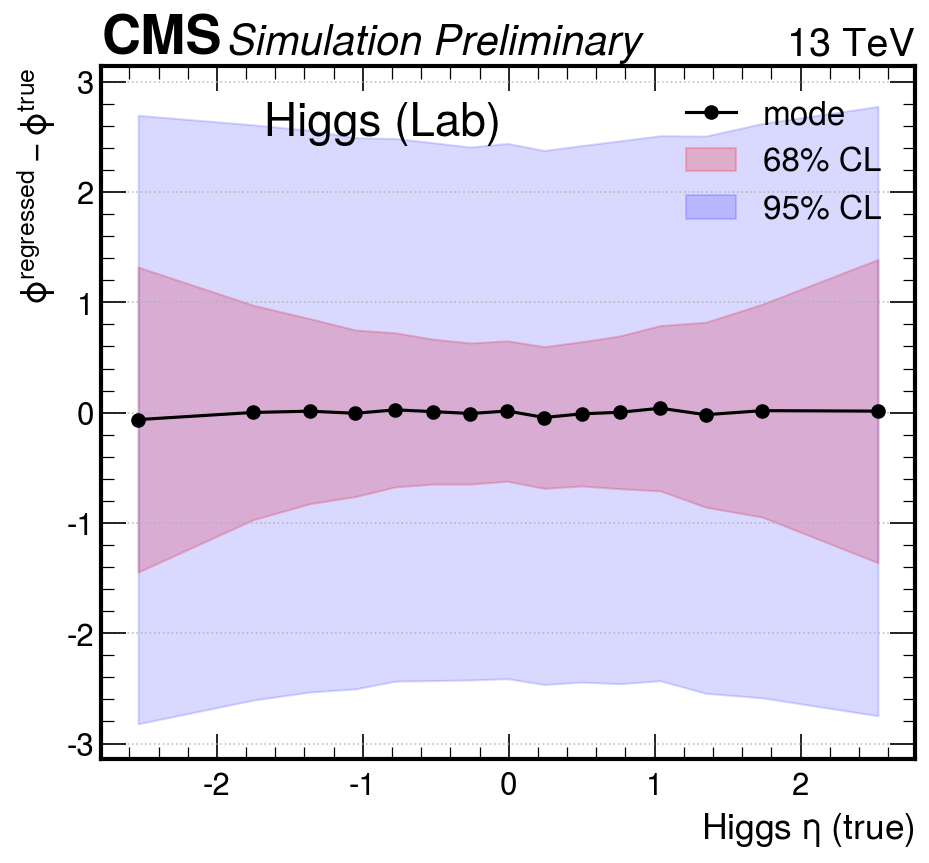

In [123]:
plot_diff_mode_quantile((higgs_regr_lab.pt/ higgsCorrect_lab.pt  -1 ).to_numpy(), 
                        X=higgsCorrect_lab.eta.to_numpy(),  
                        cat_var=higgsCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect_lab.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Higgs $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Higgs (Lab)',nbins_mode=500,
                       output_file=output+"/Higgs_regression_Lab_deltaPt_byEta")

plot_diff_mode_quantile((higgs_regr_lab.pt/ higgsCorrect_lab.pt  -1 ).to_numpy(), 
                        X=higgsCorrect_lab.pt.to_numpy(),  
                        cat_var=higgsCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(higgsCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Higgs $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Higgs (Lab)',nbins_mode=100,
                        output_file=output+"/Higgs_regression_Lab_deltaPt_byPt")

plot_diff_mode_quantile((higgs_regr_lab.eta - higgsCorrect_lab.eta ).to_numpy(), 
                        X=higgsCorrect_lab.eta.to_numpy(),  
                        cat_var=higgsCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(higgsCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Higgs (Lab)',nbins_mode=50,
                        output_file=output+"/Higgs_regression_Lab_deltaEta_byEta")

plot_diff_mode_quantile(higgs_regr_lab.deltaphi(higgsCorrect_lab).to_numpy(), 
                        X=higgsCorrect_lab.eta.to_numpy(),  
                        cat_var=higgsCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(higgsCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),
                        xlabel='Higgs $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Higgs (Lab)',
                        output_file=output+"/Higgs_regression_Lab_deltaPhi_byEta")

In [48]:
np.quantile(higgsCorrect.eta.to_numpy(), [0,0.02, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.98, 1.])

array([-7.99701446e+00, -2.16244597e+00, -1.66514879e+00, -1.26289345e+00,
       -8.09765483e-01, -5.00052501e-01, -2.41238014e-01, -1.58979843e-03,
        2.38014859e-01,  4.96829534e-01,  8.08347648e-01,  1.26217023e+00,
        1.66564313e+00,  2.15776079e+00,  7.95132417e+00])

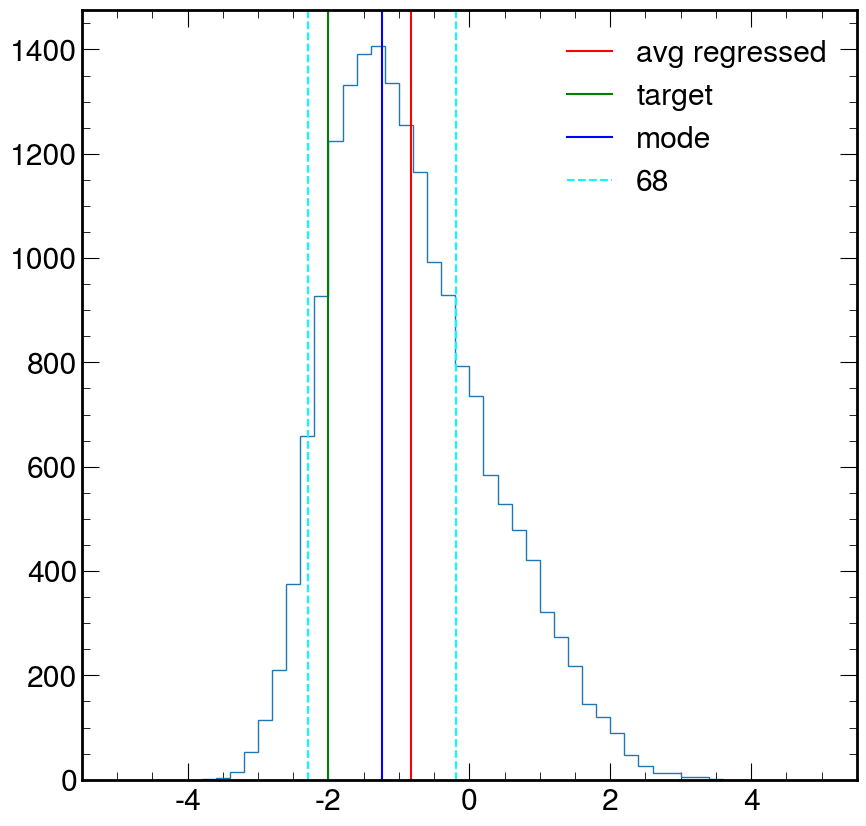

In [124]:
target = -2
mask = ((higgsCorrect.eta>(target-0.1))&(higgsCorrect.eta<(target+0.1))).to_numpy()

X = higgs_regr_CM[mask].eta.to_numpy()
mode, left, right = get_central_smallest_interval(X, 
                xrange=(np.quantile(X, 0.03), np.quantile(X, 0.97)),
                    nbins=X.size//100, Ntrial=1000, perc=0.68)
plt.hist(X, bins=50, range=(-5,5), histtype="step");
plt.axvline(np.mean(X), c='r', label="avg regressed")
plt.axvline(target, c='g', label="target")
plt.axvline(mode, c='b', label="mode")
plt.axvline(left, c='cyan',  linestyle="dashed", label="68")
plt.axvline(right, c='cyan',  linestyle="dashed",)
plt.legend()
#plt.axvline( torch.quantile(data_regressed[mask, 0, 1]), c='r')

## Thad

<Figure size 1000x1000 with 0 Axes>

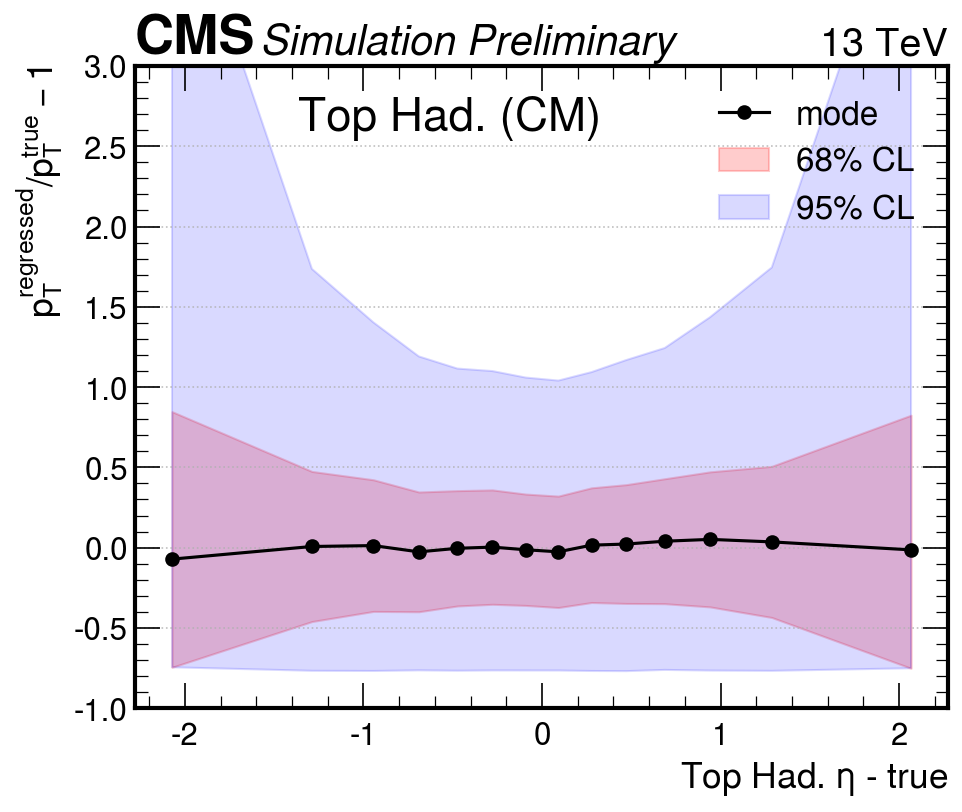

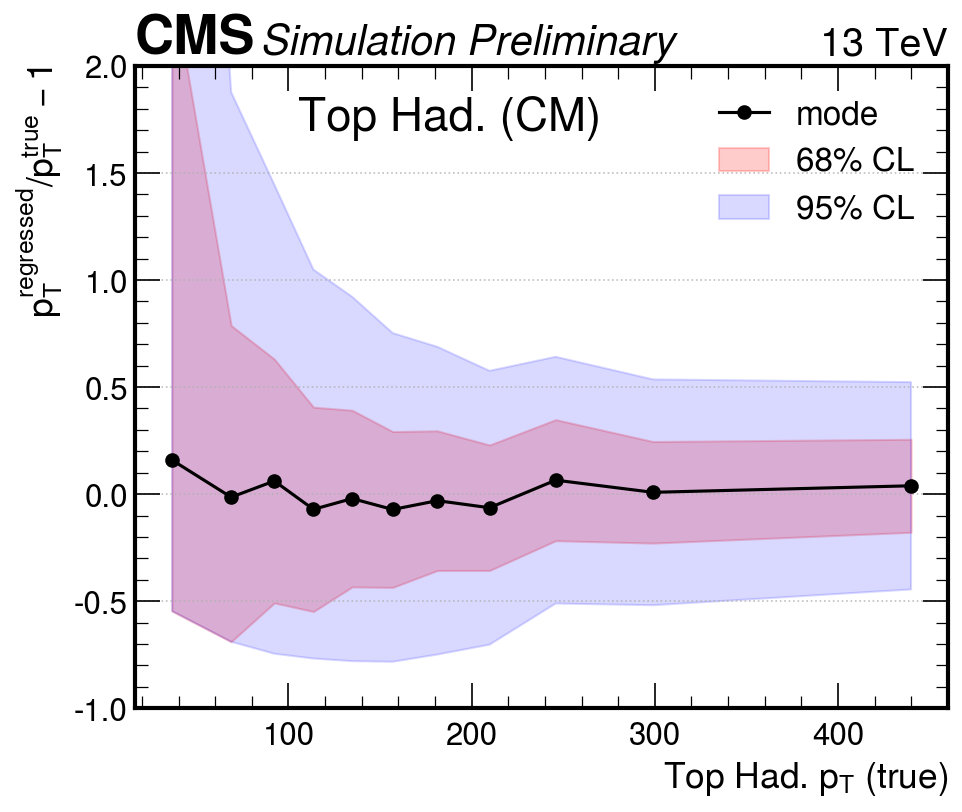

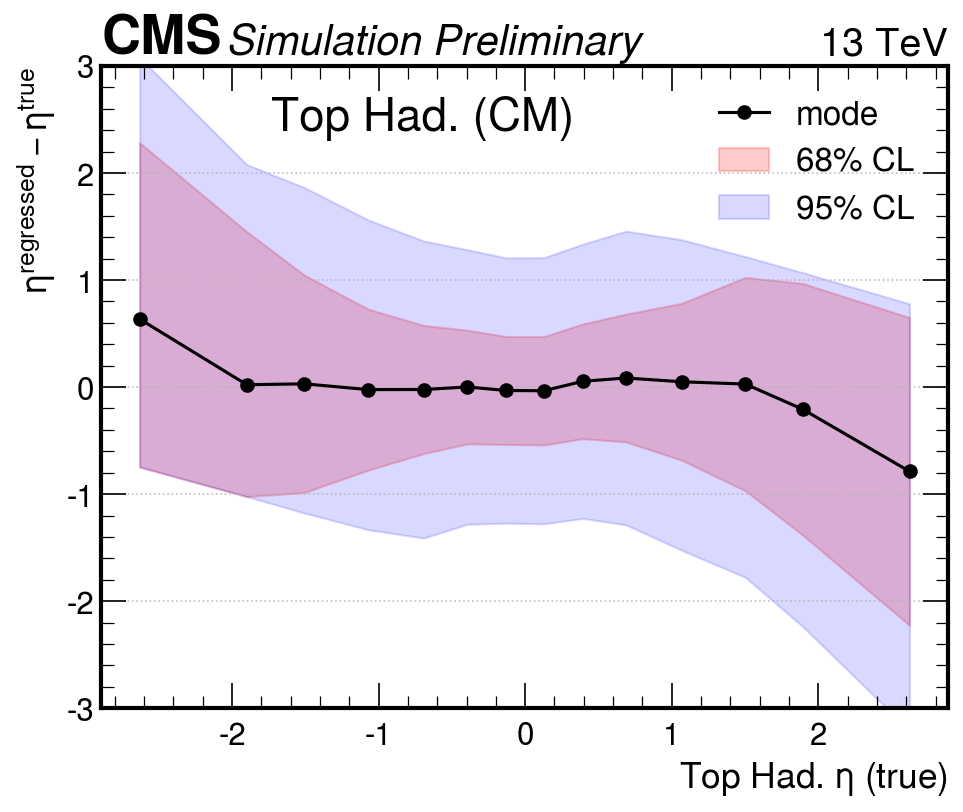

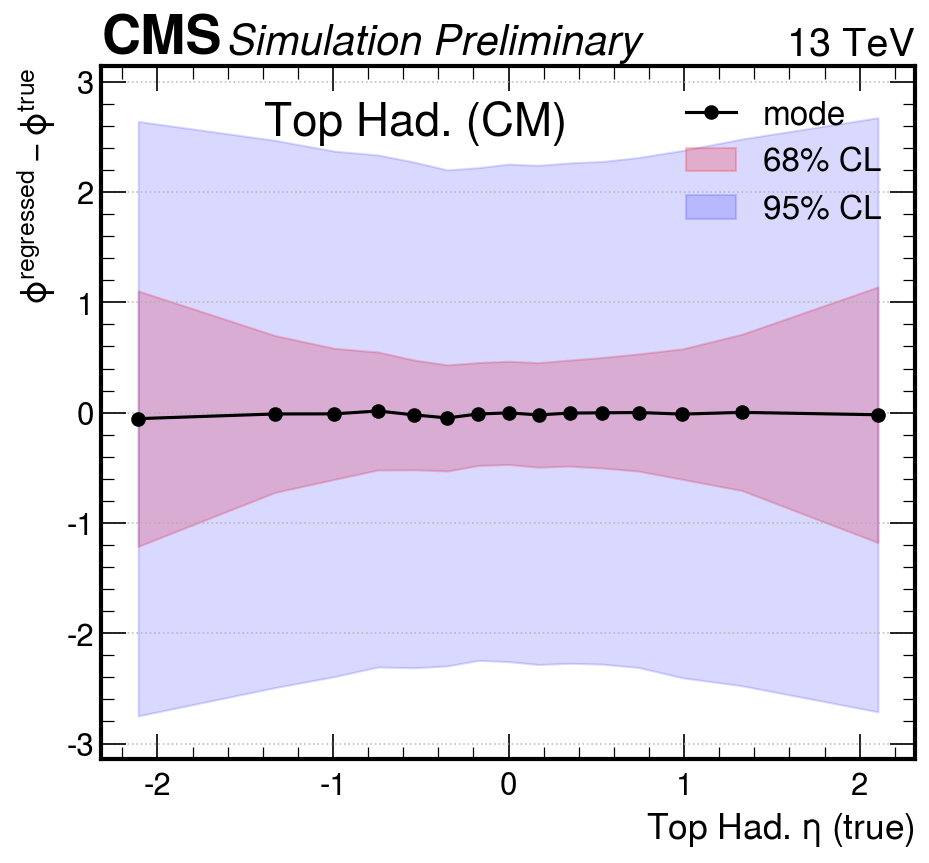

In [136]:
plot_diff_mode_quantile((thad_regr_CM.pt/ thadCorrect.pt  -1 ).to_numpy(), 
                        X=thadCorrect.eta.to_numpy(),  
                        cat_var=thadCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Top Had. $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Had. (CM)',
                       output_file=output+"/TopHad_regression_CM_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((thad_regr_CM.pt/ thadCorrect.pt  -1 ).to_numpy(), 
                        X=thadCorrect.pt.to_numpy(),  
                        cat_var=thadCorrect.pt.to_numpy(), 
                        bins=np.quantile(thadCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Had. $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Had. (CM)',nbins_mode=100,
                        output_file=output+"/TopHad_regression_CM_deltaPt_byPt")

plot_diff_mode_quantile((thad_regr_CM.eta - thadCorrect.eta ).to_numpy(), 
                        X=thadCorrect.eta.to_numpy(),  
                        cat_var=thadCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(thadCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Had. $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Top Had. (CM)',nbins_mode=50,
                        output_file=output+"/TopHad_regression_CM_deltaEta_byEta")

plot_diff_mode_quantile(thad_regr_CM.deltaphi(thadCorrect).to_numpy(), 
                        X=thadCorrect.eta.to_numpy(),  
                        cat_var=thadCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect.eta.to_numpy(), np.linspace(0,1,16)),nbins_mode=100,
                        xlabel='Top Had. $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Top Had. (CM)',
                        output_file=output+"/TopHad_regression_CM_deltaPhi_byEta")

<Figure size 1000x1000 with 0 Axes>

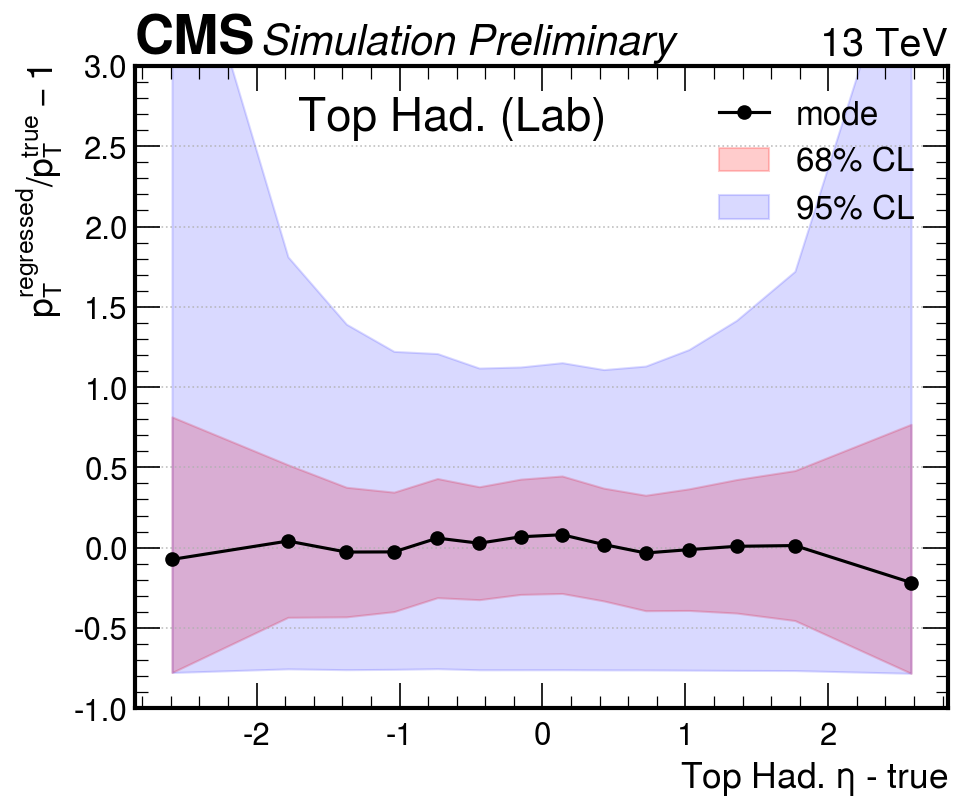

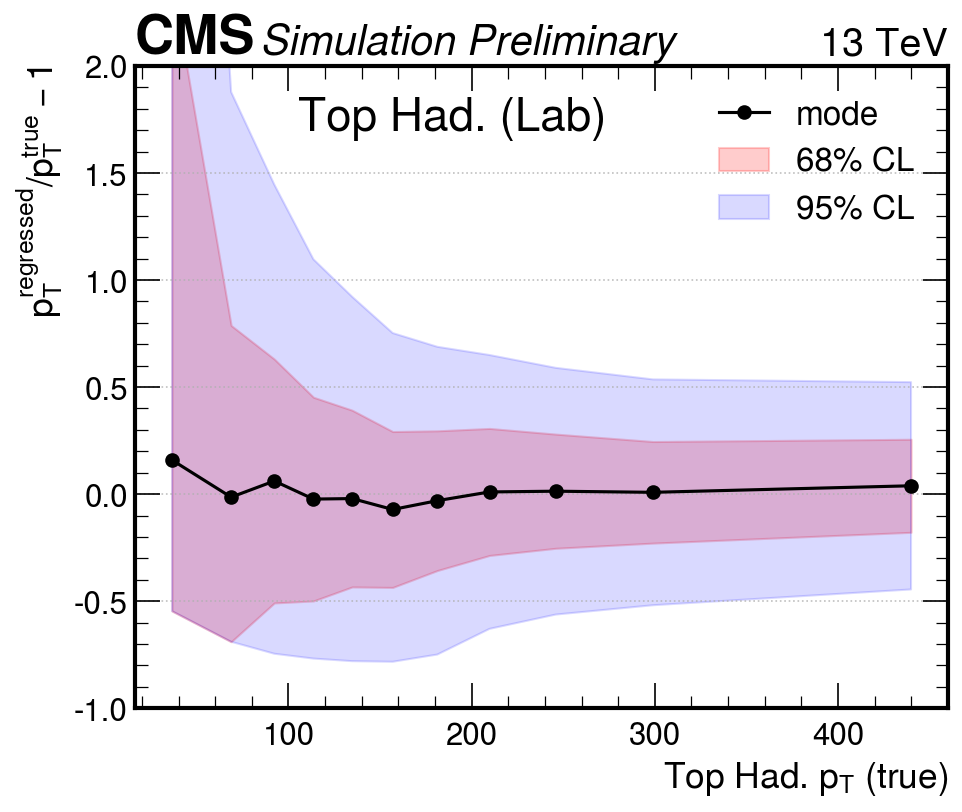

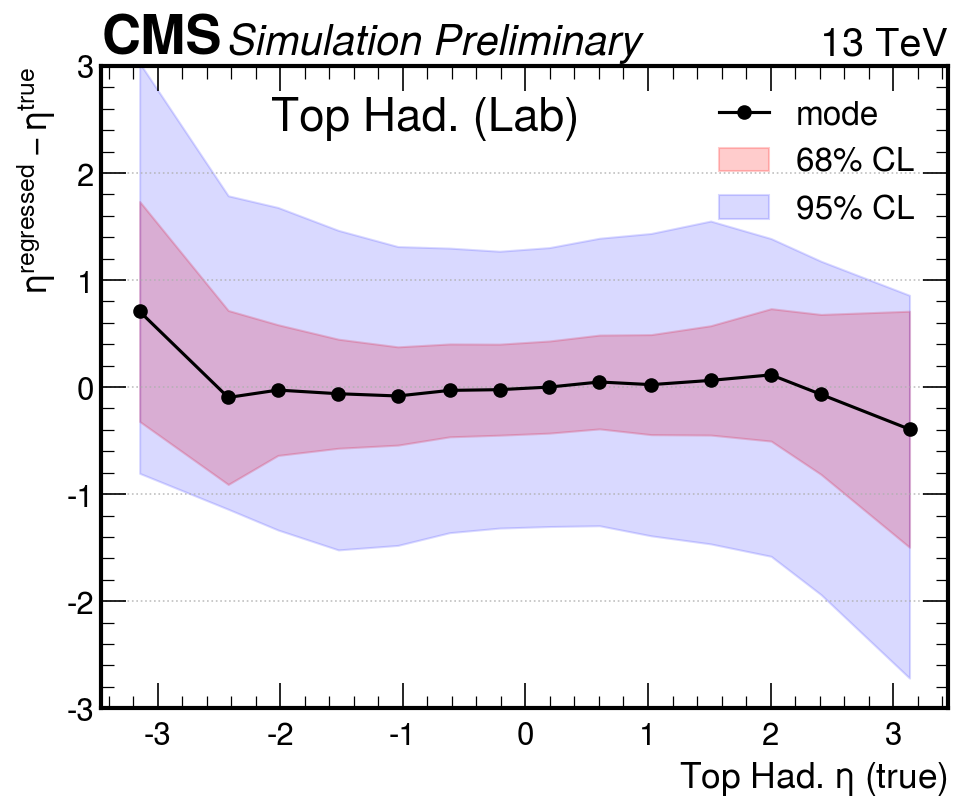

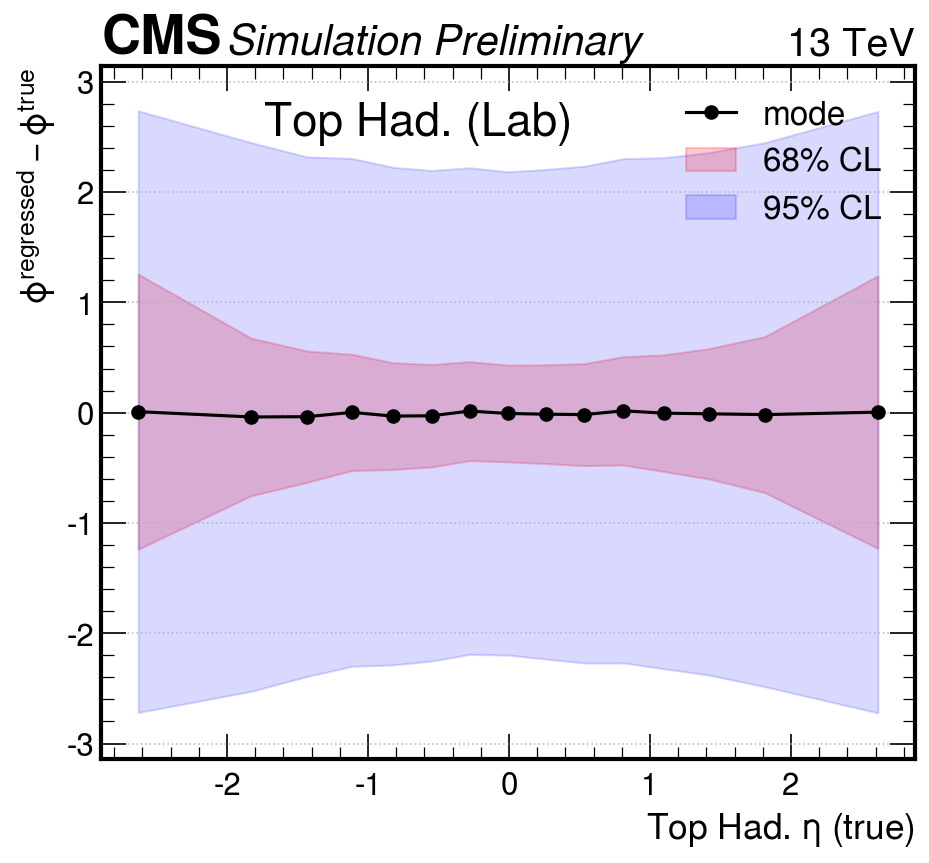

In [137]:
plot_diff_mode_quantile((thad_regr_lab.pt/ thadCorrect_lab.pt  -1 ).to_numpy(), 
                        X=thadCorrect_lab.eta.to_numpy(),  
                        cat_var=thadCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect_lab.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Top Had. $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Had. (Lab)',
                       output_file=output+"/TopHad_regression_Lab_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((thad_regr_lab.pt/ thadCorrect_lab.pt  -1 ).to_numpy(), 
                        X=thadCorrect_lab.pt.to_numpy(),  
                        cat_var=thadCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(thadCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Had. $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Had. (Lab)',nbins_mode=100,
                        output_file=output+"/TopHad_regression_Lab_deltaPt_byPt")

plot_diff_mode_quantile((thad_regr_lab.eta - thadCorrect_lab.eta ).to_numpy(), 
                        X=thadCorrect_lab.eta.to_numpy(),  
                        cat_var=thadCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(thadCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Had. $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Top Had. (Lab)',nbins_mode=50,
                        output_file=output+"/TopHad_regression_Lab_deltaEta_byEta")

plot_diff_mode_quantile(thad_regr_lab.deltaphi(thadCorrect_lab).to_numpy(), 
                        X=thadCorrect_lab.eta.to_numpy(),  
                        cat_var=thadCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(thadCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),nbins_mode=100,
                        xlabel='Top Had. $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Top Had. (Lab)',
                        output_file=output+"/TopHad_regression_Lab_deltaPhi_byEta")

## T lep

<Figure size 1000x1000 with 0 Axes>

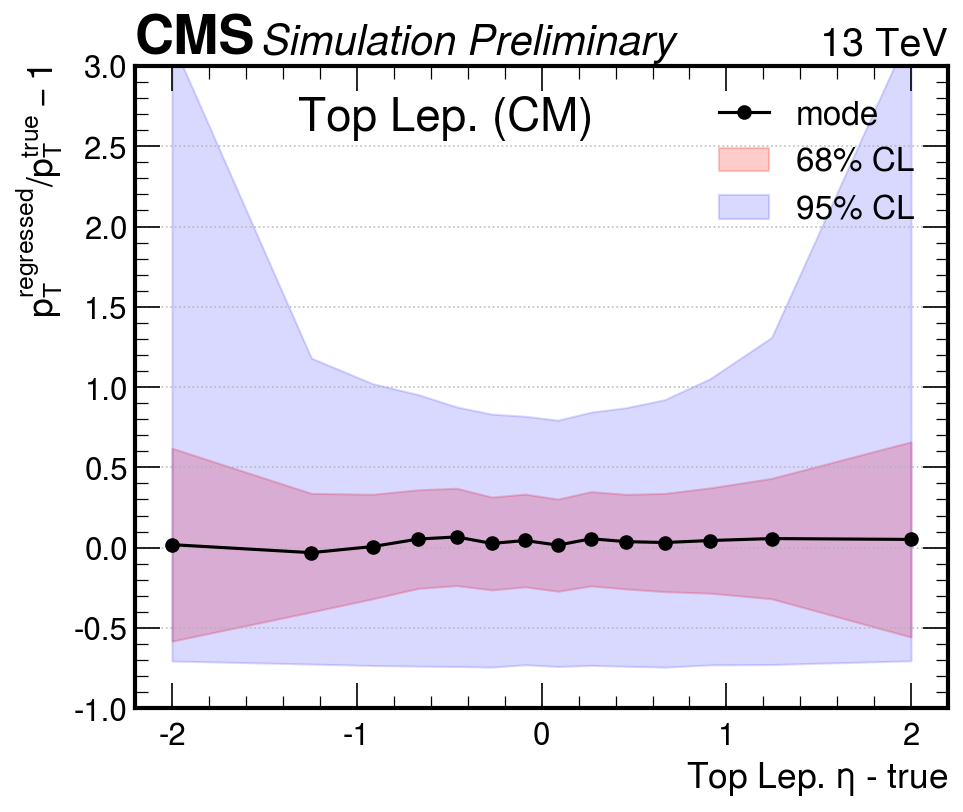

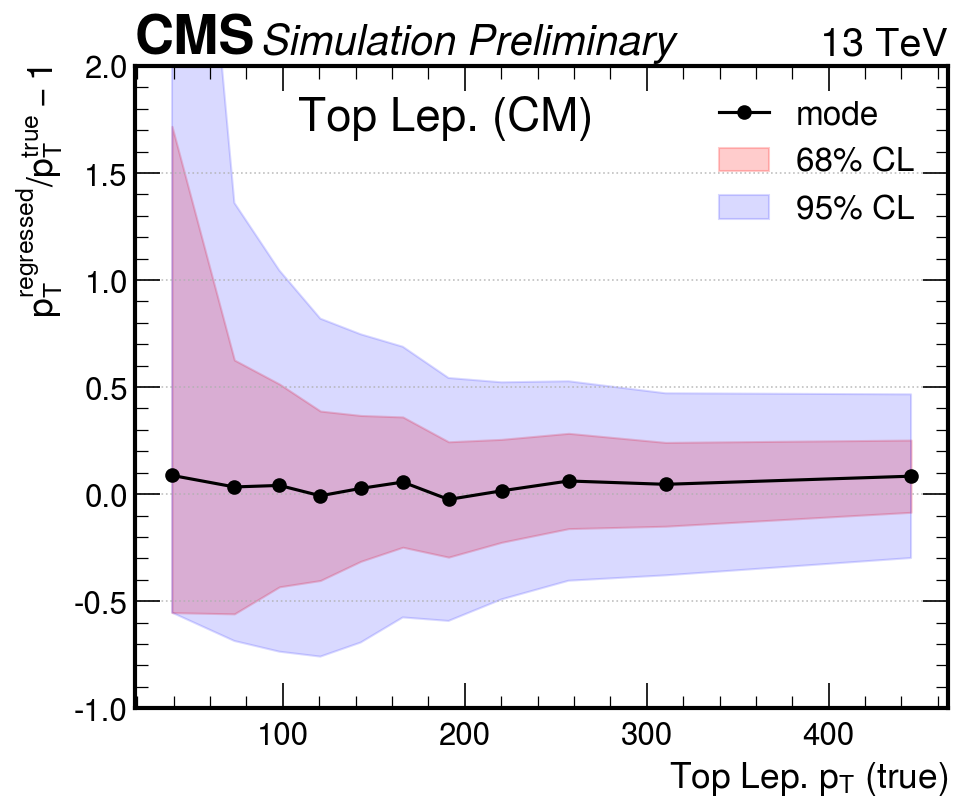

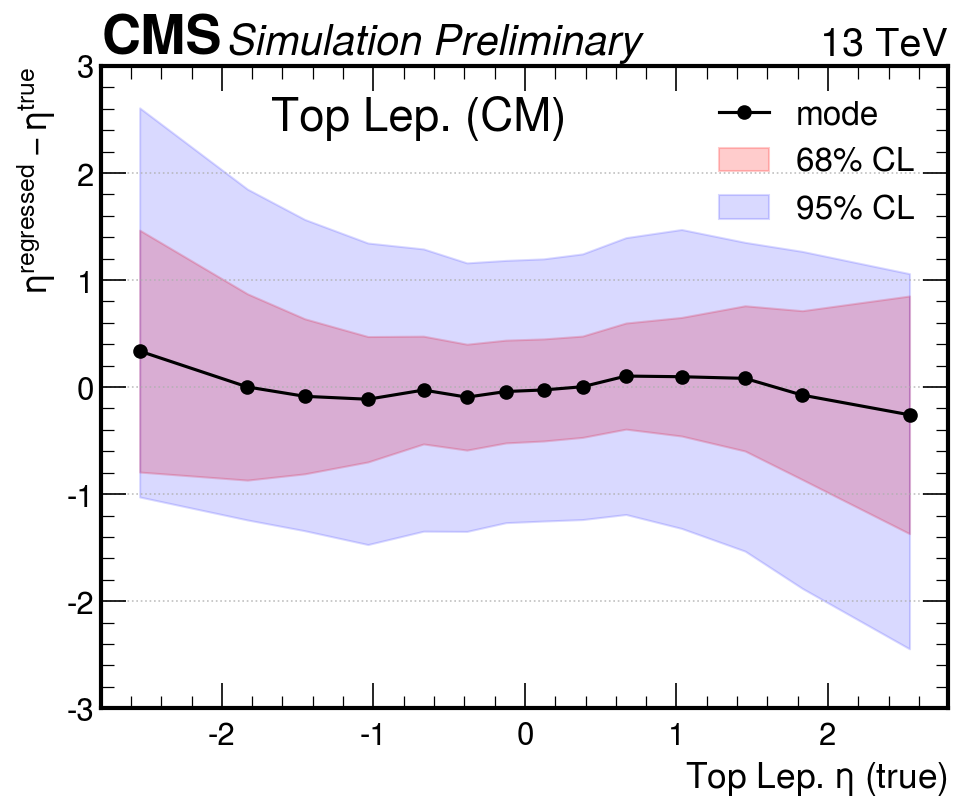

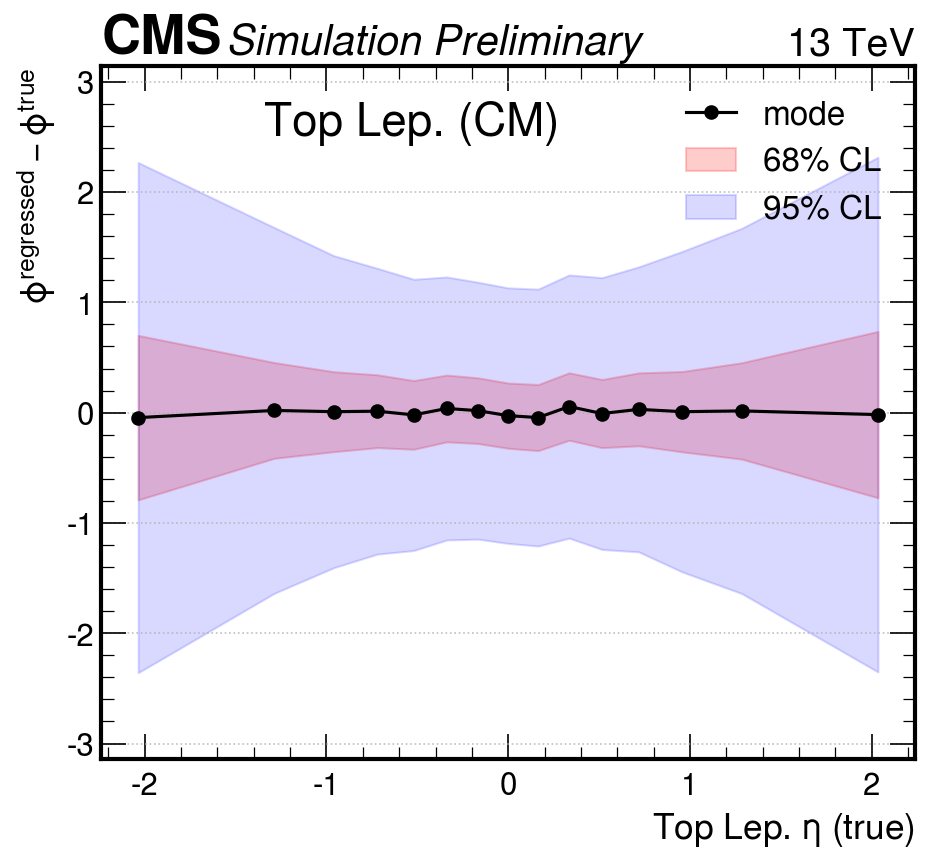

In [138]:
plot_diff_mode_quantile((tlep_regr_CM.pt/ tlepCorrect.pt  -1 ).to_numpy(), 
                        X=tlepCorrect.eta.to_numpy(),  
                        cat_var=tlepCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Top Lep. $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Lep. (CM)',
                       output_file=output+"/TopLep_regression_CM_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((tlep_regr_CM.pt/ tlepCorrect.pt  -1 ).to_numpy(), 
                        X=tlepCorrect.pt.to_numpy(),  
                        cat_var=tlepCorrect.pt.to_numpy(), 
                        bins=np.quantile(tlepCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Lep. $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Lep. (CM)',nbins_mode=100,
                        output_file=output+"/TopLep_regression_CM_deltaPt_byPt")

plot_diff_mode_quantile((tlep_regr_CM.eta - tlepCorrect.eta ).to_numpy(), 
                        X=tlepCorrect.eta.to_numpy(),  difference
                        cat_var=tlepCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(tlepCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Lep. $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Top Lep. (CM)',nbins_mode=50,
                        output_file=output+"/TopLep_regression_CM_deltaEta_byEta")

plot_diff_mode_quantile(tlep_regr_CM.deltaphi(tlepCorrect).to_numpy(), 
                        X=tlepCorrect.eta.to_numpy(),  
                        cat_var=tlepCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect.eta.to_numpy(), np.linspace(0,1,16)),nbins_mode=100,
                        xlabel='Top Lep. $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Top Lep. (CM)',
                        output_file=output+"/TopLep_regression_CM_deltaPhi_byEta")

<Figure size 1000x1000 with 0 Axes>

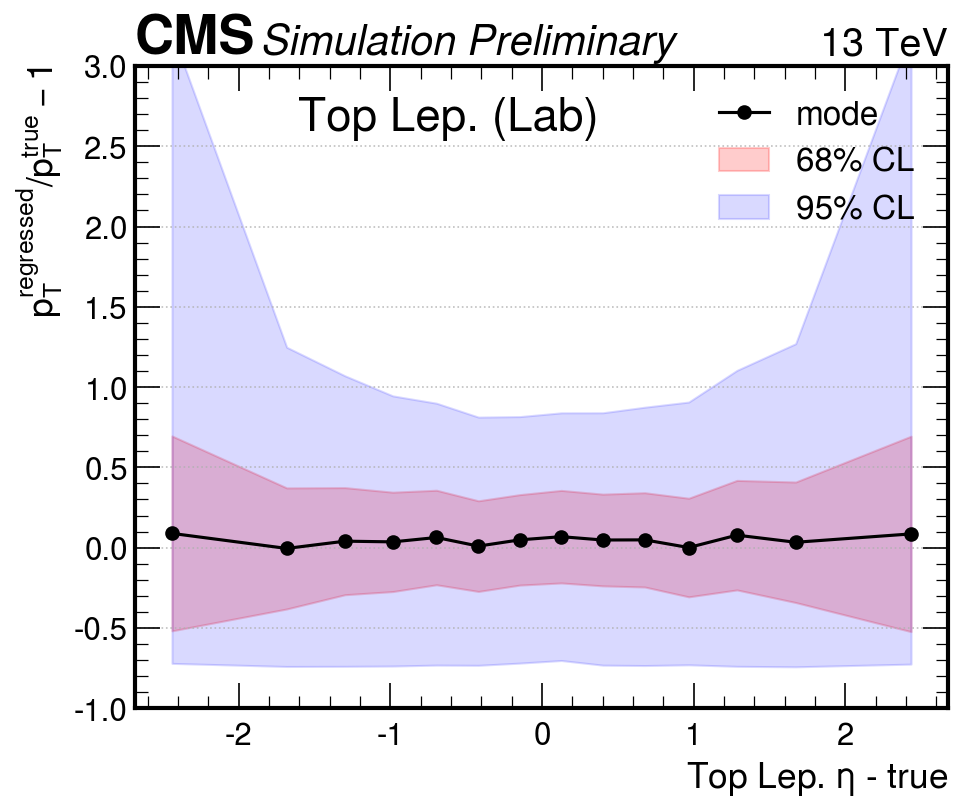

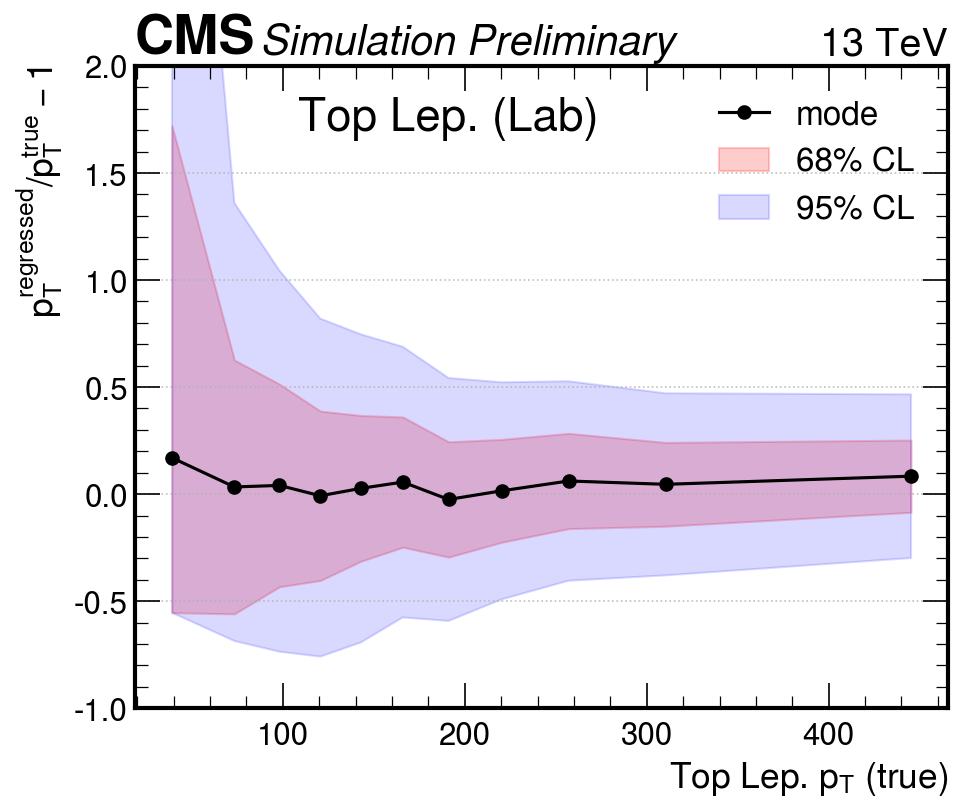

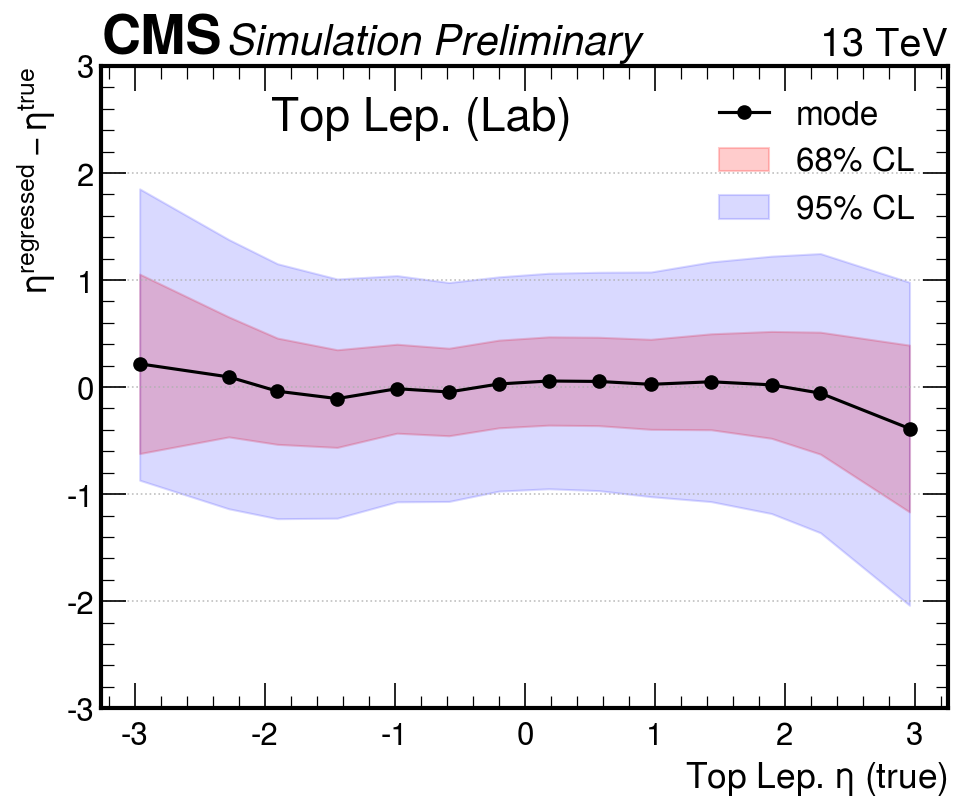

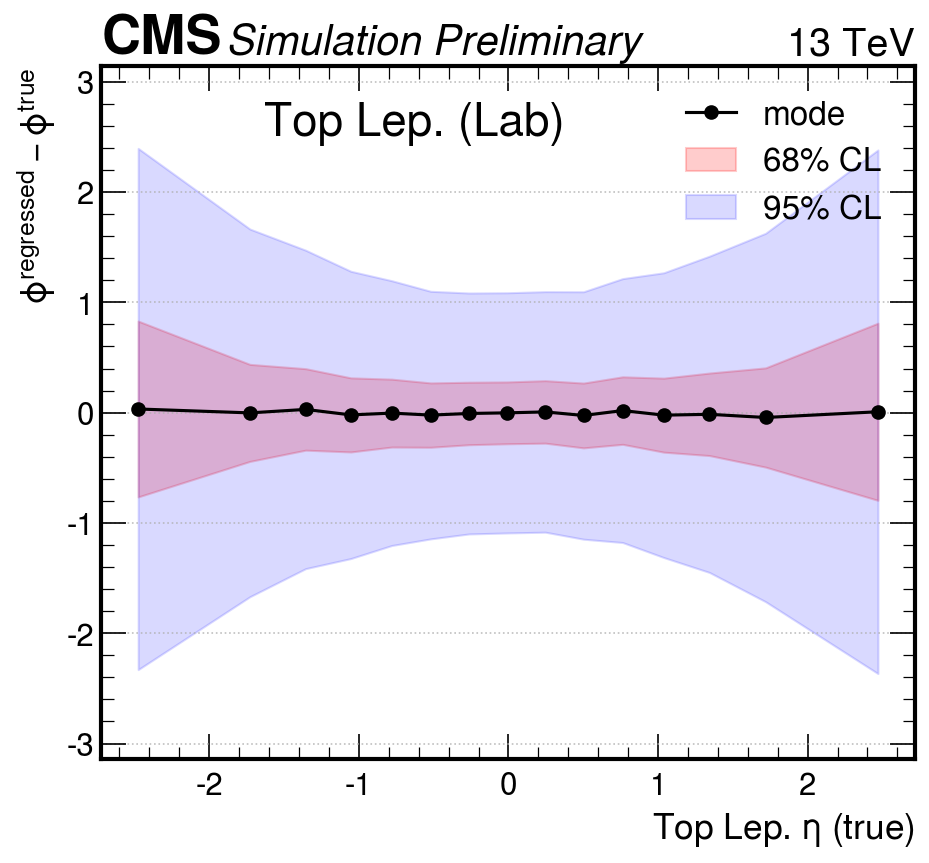

In [139]:
plot_diff_mode_quantile((tlep_regr_lab.pt/ tlepCorrect_lab.pt  -1 ).to_numpy(), 
                        X=tlepCorrect_lab.eta.to_numpy(),  
                        cat_var=tlepCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect_lab.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Top Lep. $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Lep. (Lab)',
                       output_file=output+"/TopLep_regression_Lab_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((tlep_regr_lab.pt/ tlepCorrect_lab.pt  -1 ).to_numpy(), 
                        X=tlepCorrect_lab.pt.to_numpy(),  
                        cat_var=tlepCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(tlepCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Top Lep. $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Top Lep. (Lab)',nbins_mode=100,
                        output_file=output+"/TopLep_regression_Lab_deltaPt_byPt")

plot_diff_mode_quantile((tlep_regr_lab.eta - tlepCorrect_lab.eta ).to_numpy(), 
                        X=tlepCorrect_lab.eta.to_numpy(),  
                        cat_var=tlepCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(tlepCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Top Lep. $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Top Lep. (Lab)',nbins_mode=50,
                        output_file=output+"/TopLep_regression_Lab_deltaEta_byEta")

plot_diff_mode_quantile(tlep_regr_lab.deltaphi(tlepCorrect_lab).to_numpy(), 
                        X=tlepCorrect_lab.eta.to_numpy(),  
                        cat_var=tlepCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(tlepCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),nbins_mode=100,
                        xlabel='Top Lep. $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Top Lep. (Lab)',
                        output_file=output+"/TopLep_regression_Lab_deltaPhi_byEta")

## Gluon

<Figure size 1000x1000 with 0 Axes>

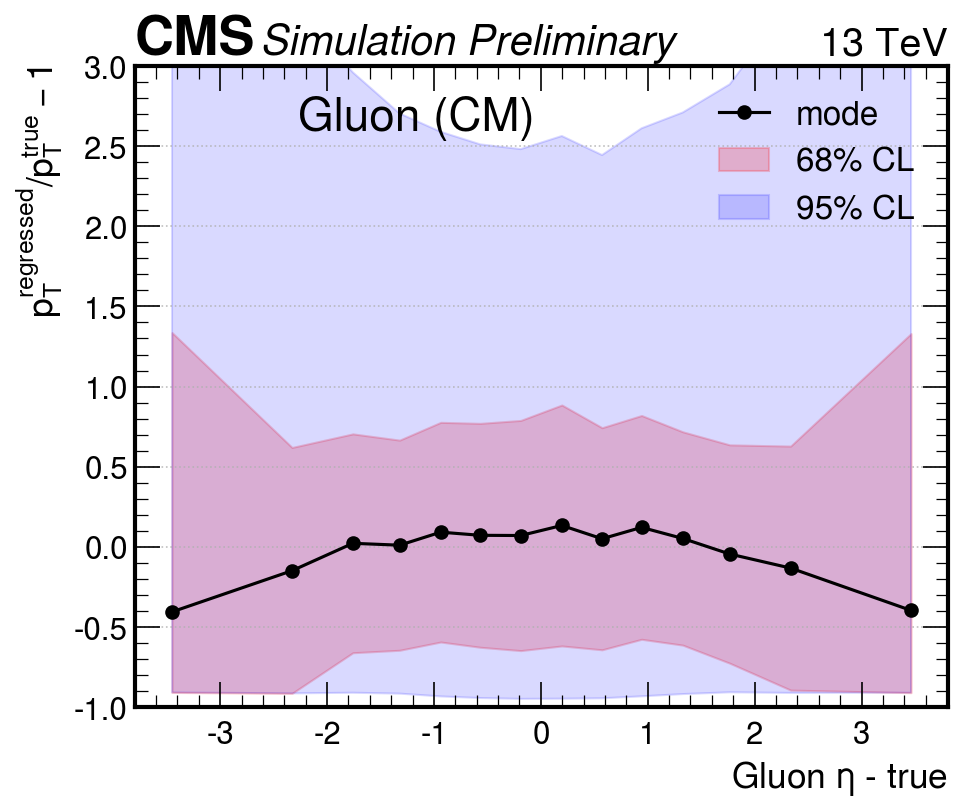

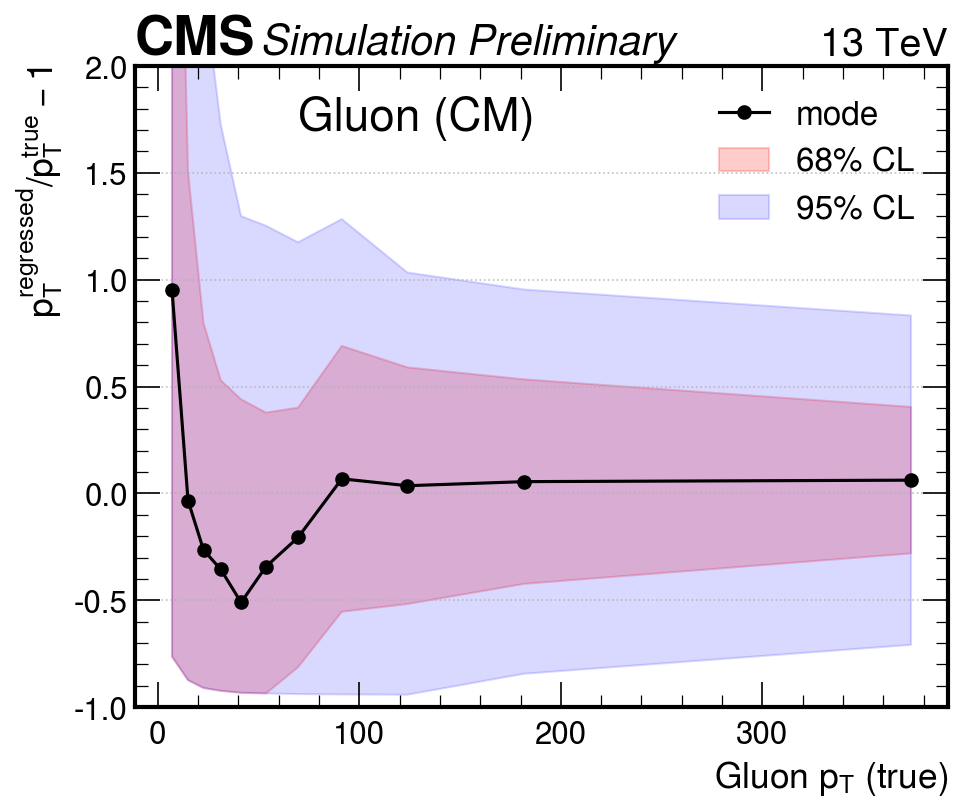

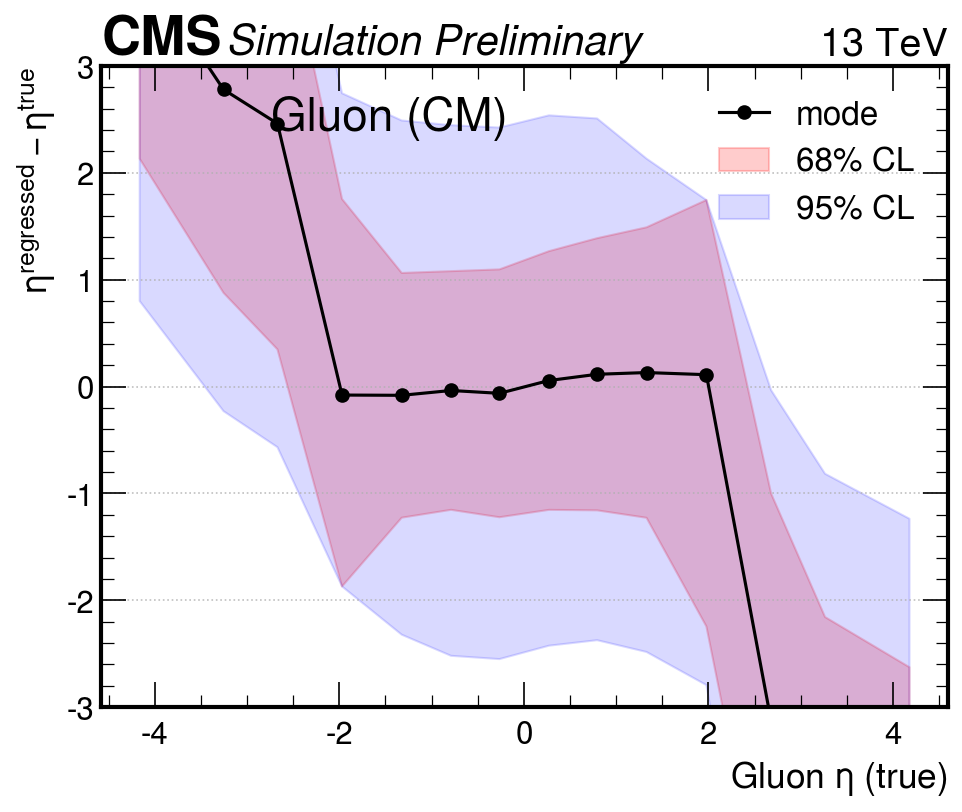

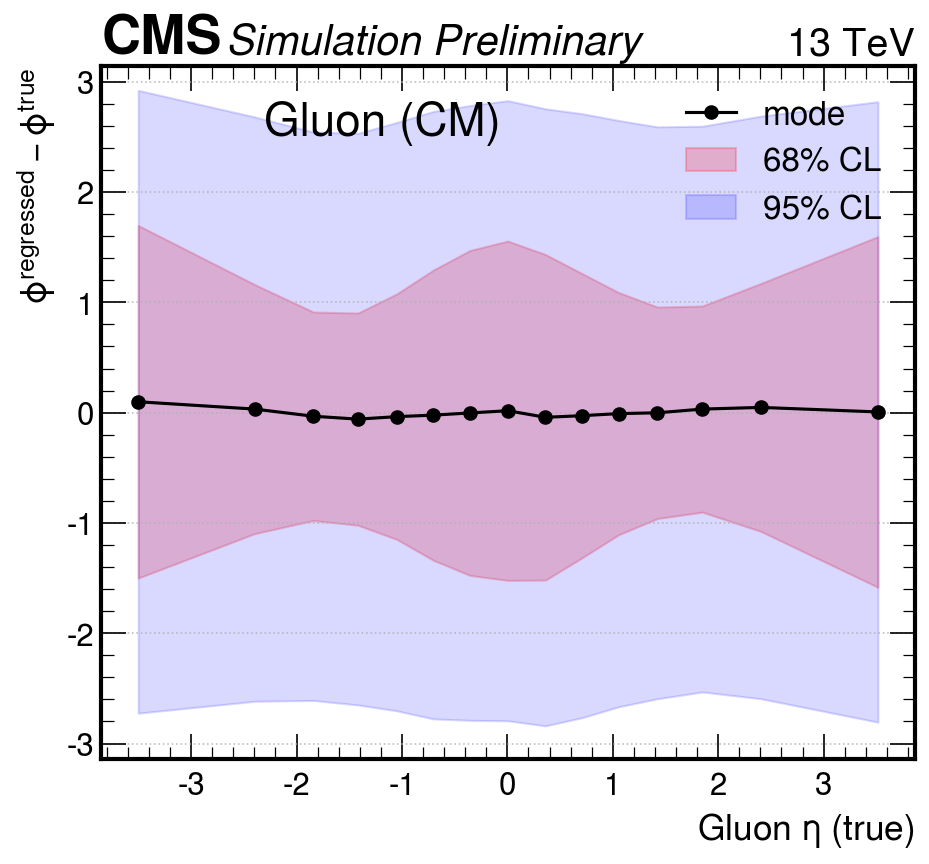

In [160]:
plot_diff_mode_quantile((isr_regr_CM.pt/ glISRCorrect.pt  -1 ).to_numpy(), 
                        X=glISRCorrect.eta.to_numpy(),  
                        cat_var=glISRCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Gluon $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Gluon (CM)',
                       output_file=output+"/Gluon_regression_CM_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((isr_regr_CM.pt/ glISRCorrect.pt  -1 ).to_numpy(), 
                        X=glISRCorrect.pt.to_numpy(),  
                        cat_var=glISRCorrect.pt.to_numpy(), 
                        bins=np.quantile(glISRCorrect.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Gluon $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Gluon (CM)',nbins_mode=100,
                        output_file=output+"/Gluon_regression_CM_deltaPt_byPt")

plot_diff_mode_quantile((isr_regr_CM.eta - glISRCorrect.eta ).to_numpy(), 
                        X=glISRCorrect.eta.to_numpy(),  
                        cat_var=glISRCorrect.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(glISRCorrect.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Gluon $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Gluon (CM)',nbins_mode=50,
                        output_file=output+"/Gluon_regression_CM_deltaEta_byEta")

plot_diff_mode_quantile(isr_regr_CM.deltaphi(glISRCorrect).to_numpy(), 
                        X=glISRCorrect.eta.to_numpy(),  
                        cat_var=glISRCorrect.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect.eta.to_numpy(), np.linspace(0,1,16)),nbins_mode=100,
                        xlabel='Gluon $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Gluon (CM)',
                        output_file=output+"/Gluon_regression_CM_deltaPhi_byEta")

<Figure size 1000x1000 with 0 Axes>

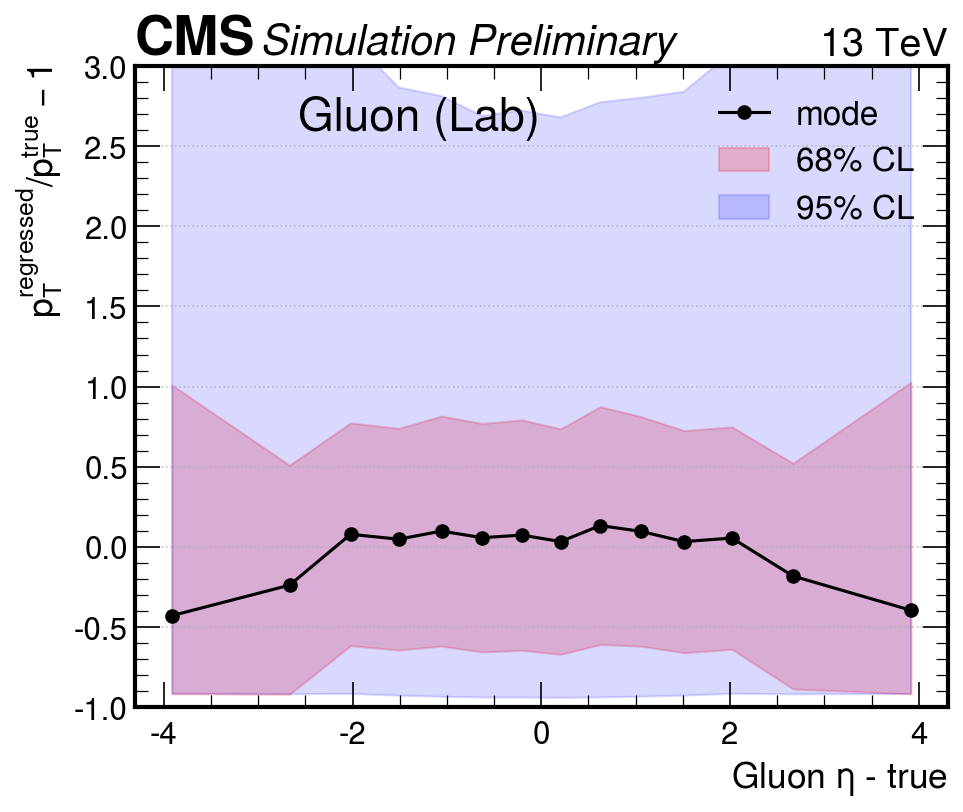

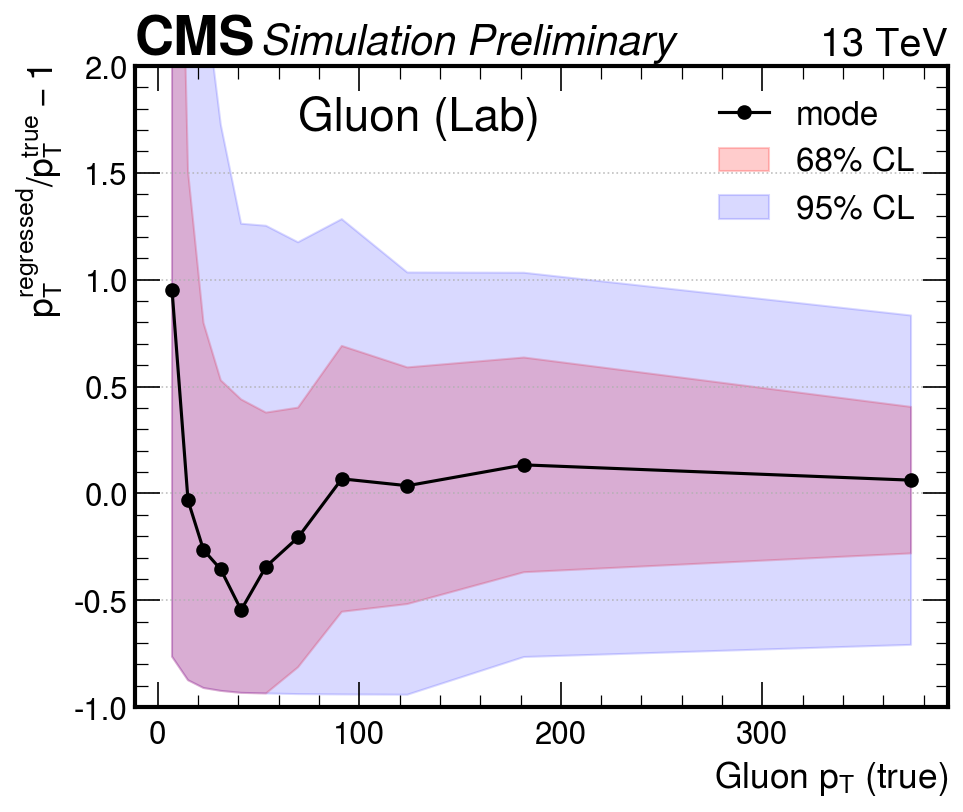

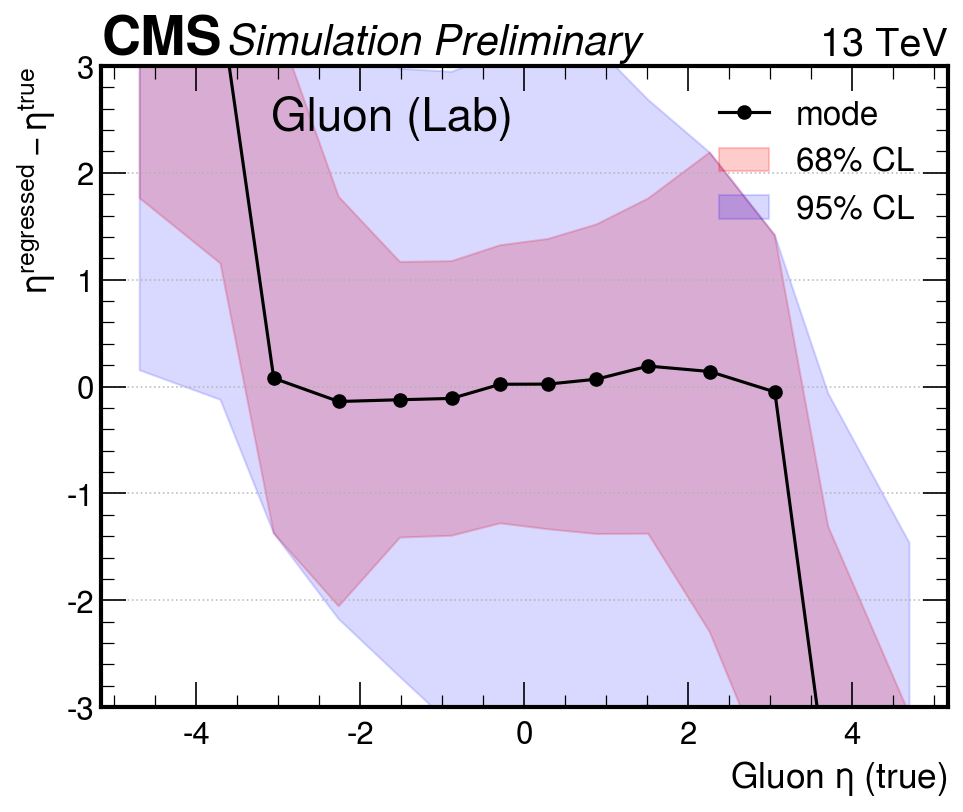

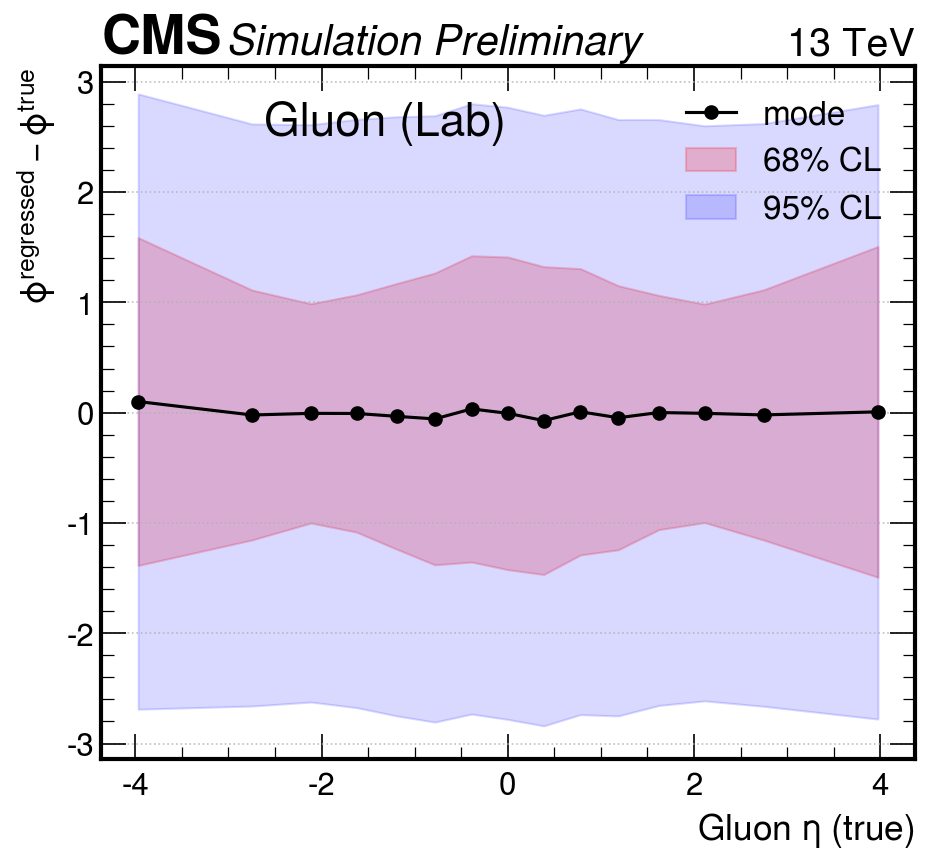

In [159]:
plot_diff_mode_quantile((isr_regr_lab.pt/ glISRCorrect_lab.pt  -1 ).to_numpy(), 
                        X=glISRCorrect_lab.eta.to_numpy(),  
                        cat_var=glISRCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect_lab.eta.to_numpy(), np.linspace(0,1,15)),
                        xlabel='Gluon $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Gluon (Lab)',
                       output_file=output+"/Gluon_regression_Lab_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((isr_regr_lab.pt/ glISRCorrect_lab.pt  -1 ).to_numpy(), 
                        X=glISRCorrect_lab.pt.to_numpy(),  
                        cat_var=glISRCorrect_lab.pt.to_numpy(), 
                        bins=np.quantile(glISRCorrect_lab.pt.to_numpy(), np.linspace(0,1,12)),
                        xlabel='Gluon $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{regressed}/p_T^{true} -1 $', title='Gluon (Lab)',nbins_mode=100,
                        output_file=output+"/Gluon_regression_Lab_deltaPt_byPt")

plot_diff_mode_quantile((isr_regr_lab.eta - glISRCorrect_lab.eta ).to_numpy(), 
                        X=glISRCorrect_lab.eta.to_numpy(),  
                        cat_var=glISRCorrect_lab.eta.to_numpy(), 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                        bins=np.quantile(glISRCorrect_lab.eta.to_numpy(), [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Gluon $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{regressed} - \eta^{true}$', title='Gluon (Lab)',nbins_mode=50,
                        output_file=output+"/Gluon_regression_Lab_deltaEta_byEta")

plot_diff_mode_quantile(isr_regr_lab.deltaphi(glISRCorrect_lab).to_numpy(), 
                        X=glISRCorrect_lab.eta.to_numpy(),  
                        cat_var=glISRCorrect_lab.eta.to_numpy(), 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(glISRCorrect_lab.eta.to_numpy(), np.linspace(0,1,16)),nbins_mode=100,
                        xlabel='Gluon $\eta$ (true)', ylim=(-pi,pi),
                    ylabel='$\phi^{regressed} - \phi^{true}$', title='Gluon (Lab)',
                        output_file=output+"/Gluon_regression_Lab_deltaPhi_byEta")

## Boost

In [144]:
boost_regr

tensor([[ 860.2443, -658.2746],
        [1474.9980,  949.2159],
        [1453.6350, 1250.0747],
        ...,
        [1897.1353, -638.9467],
        [2438.0165, 1338.4487],
        [1610.5788,  561.3750]])

In [149]:
boost_parton

tensor([[[ 921.6995,    0.0000,    0.0000, -717.5827]],

        [[1346.5586,    0.0000,    0.0000,  804.9993]],

        [[1224.1244,    0.0000,    0.0000, 1065.0983]],

        ...,

        [[ 938.5605,    0.0000,    0.0000, -105.2322]],

        [[1598.0658,    0.0000,    0.0000, 1196.3906]],

        [[1528.0619,    0.0000,    0.0000,  720.3970]]])

<Figure size 1000x1000 with 0 Axes>

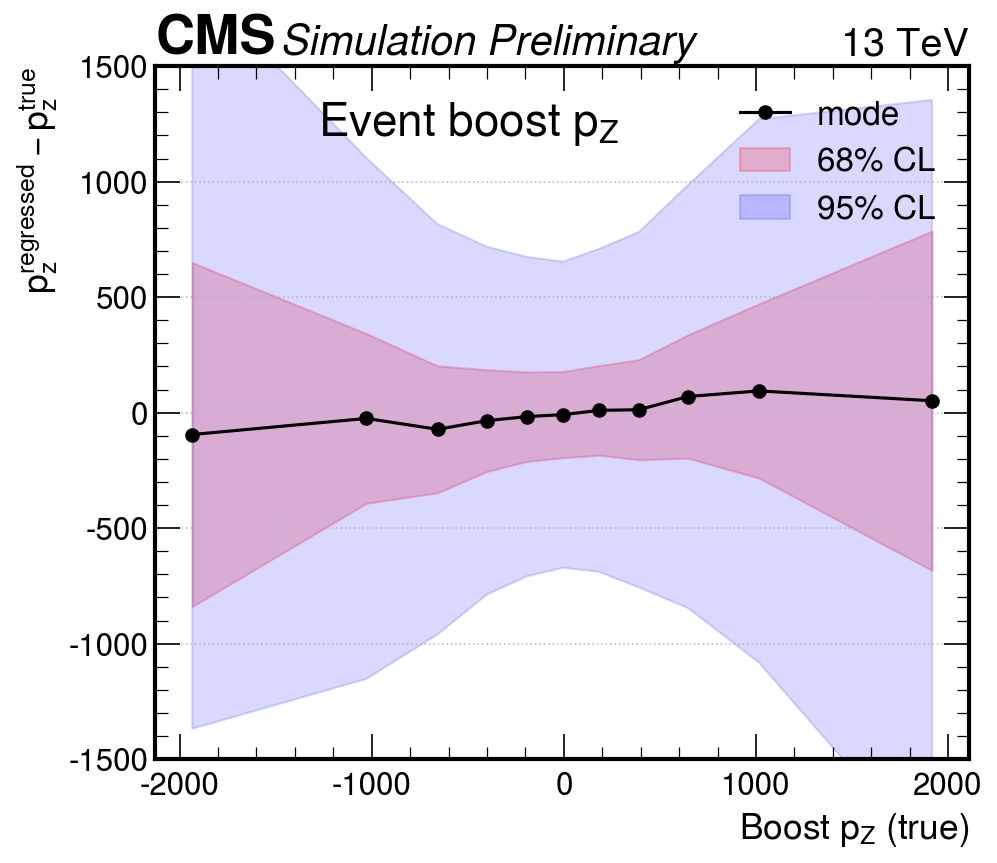

In [161]:
plot_diff_mode_quantile((boost_regr[:,1] - boost_parton[:,0,-1]).numpy(), 
                        X=boost_parton[:,0,-1].numpy(),
                        cat_var=boost_parton[:,0,-1].numpy(), 
                        bins=np.quantile(boost_parton[:,0,-1].numpy(), np.linspace(0,1,12)),
                        xlabel='Boost $p_Z$ (true)', ylim=(-1500,1500),
                    ylabel='$p_z^{regressed} - p_z^{true}$', title='Event boost $p_Z$',nbins_mode=100,
                        output_file=output+"/Boost_regression_Pz")

cm_M_regr = (boost_regr[:,0]**2 - boost_regr[:,1])**0.5
cm_M_true = (boost_parton[:,0,0]**2 - boost_parton[:,0,1])**0.5

<Figure size 1000x1000 with 0 Axes>

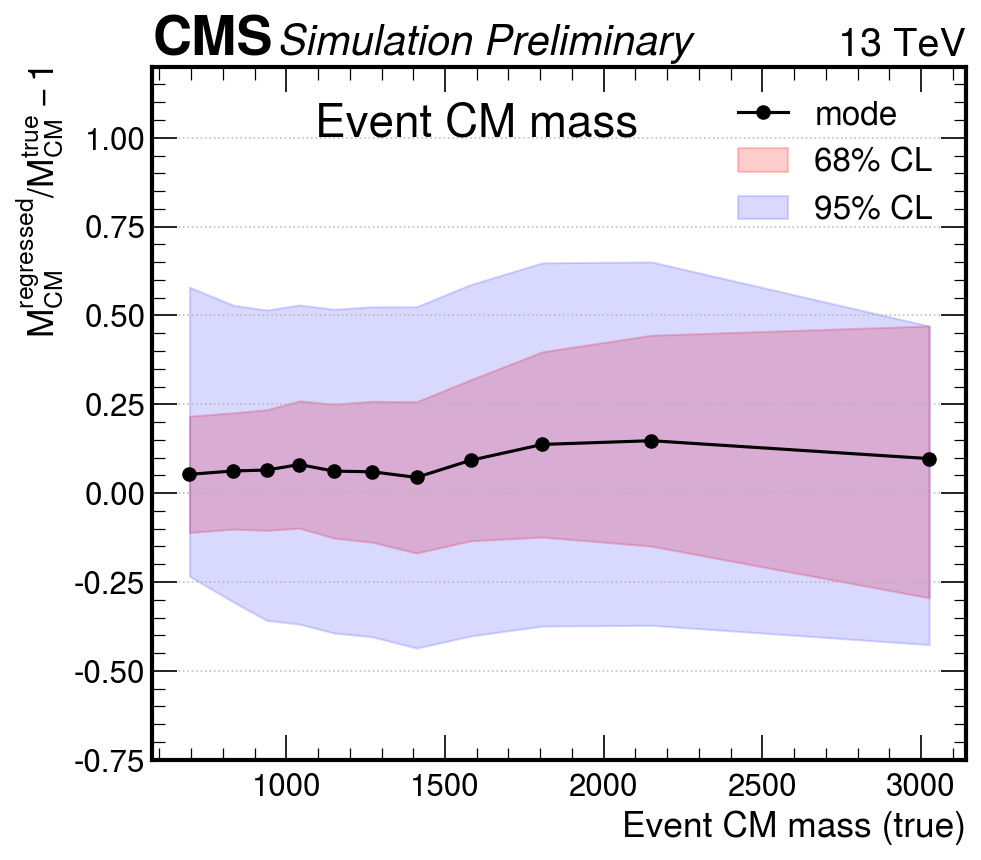

In [168]:
cm_M_regr = (boost_regr[:,0]**2 - boost_regr[:,1])**0.5
cm_M_true = (boost_parton[:,0,0]**2 - boost_parton[:,0,1])**0.5

plot_diff_mode_quantile((cm_M_regr / cm_M_true - 1).numpy(), 
                        X=cm_M_true.numpy(),
                        cat_var=cm_M_true.numpy(), 
                        bins=np.quantile(cm_M_true.numpy(), np.linspace(0,1,12)),
                        xlabel='Event CM mass (true)', ylim=(-0.75,1.2),
                    ylabel='$M_{CM}^{regressed}/M_{CM}^{true} -1$', title='Event CM mass',nbins_mode=100,
                        output_file=output+"/Boost_regression_ECM")


# Bias analysis for the sampling

In [41]:
import h5py
df = h5py.File(f"{basedir_flow}/samples_30_allevents.hdf5")
df.keys()

<KeysViewHDF5 ['boost', 'flow_samples', 'logprob', 'part_CM_Epxpypz', 'part_lab_ptetaphi', 'ps']>

In [42]:
ps_samples = torch.from_numpy(df["flow_samples"][()]).to("cpu")

In [43]:
regr_data = torch.from_numpy(df["part_CM_Epxpypz"][()])
(higgs_regr_CM, thad_regr_CM, tlep_regr_CM, isr_regr_CM) = get_particle_awkward(torch.from_numpy(df["part_CM_Epxpypz"][()] )) # it is in the CM
boost_regr = torch.from_numpy(df['boost'][()])
boost_regr = boost_regr*log_std_boost.to("cpu") + log_mean_boost.to("cpu") 
boost_regr[:,0] = torch.exp(boost_regr[:,0]) - 1

x1true = (boost_parton[:,0,0]+boost_parton[:,0,3])/E_CM
x2true = (boost_parton[:,0,0]-boost_parton[:,0,3])/E_CM


In [44]:
# Need to unscale the particle in the lab
partons_lab = torch.from_numpy(df["part_lab_ptetaphi"][()])
partons_lab = partons_lab*log_std_parton_lab.to("cpu")  + log_mean_parton_lab.to("cpu") 
partons_lab[:,:,0] = torch.exp(partons_lab[:,:, 0]) - 1
(higgs_regr_lab, thad_regr_lab, tlep_regr_lab, isr_regr_lab) = get_particle_awkward_ptetaphi(partons_lab)

In [13]:
ps_unscaled = torch.sigmoid(ps_samples[:,1,:]*scale_ps.to("cpu") + mean_ps.to("cpu")).squeeze()
momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_unscaled)

In [12]:
momenta_total = []

In [15]:
for i in range(4):
    print(i)
    ps_unscaled = torch.sigmoid(ps_samples[:,i,:]*scale_ps.to("cpu") + mean_ps.to("cpu")).squeeze()
    momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_unscaled)
    momenta_total.append(momenta)
#Hs, t1s, t2s, isrs = get_particle_awkward(momenta[:,2:].cpu())

0
1
2
3


In [ ]:
momenta_tot = torch.cat(momenta_total, 0)
Hs, t1s, t2s, isrs = get_particle_awkward(momenta_tot[:,2:].cpu())

In [58]:
part_CM_repeated = torch.cat([part_CM,part_CM,part_CM,part_CM], dim=0).shape

In [65]:
x1pp.shape

torch.Size([1792125])

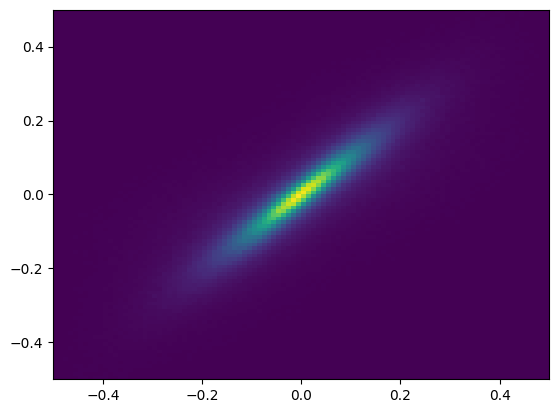

In [66]:
plt.hist2d((x1true-x2true).cpu().numpy(),(x1pp-x2pp).numpy(), bins=100, range=((-0.5,0.5),(-0.5,0.5)),
          );

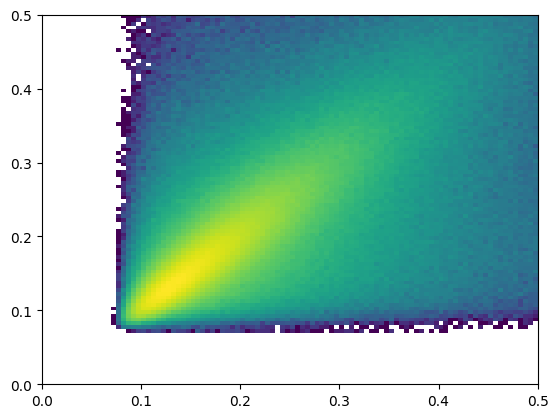

In [67]:
plt.hist2d((x1true+x2true).numpy(),(x1pp+x2pp).numpy(), bins=100, range=((0,0.5),(0,0.5)),
          norm=LogNorm());

Text(0.5, 1.0, 'ISR')

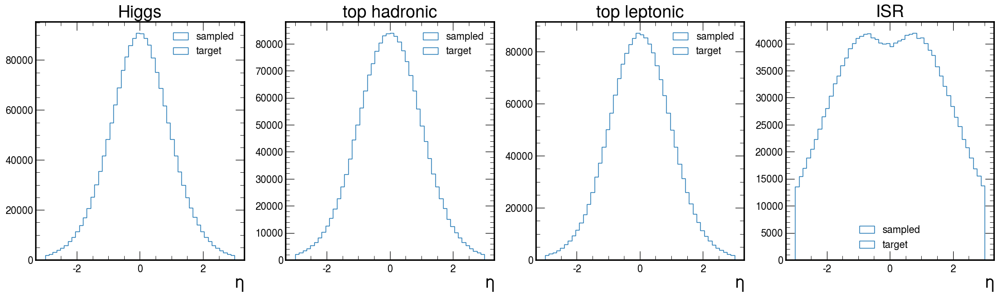

In [45]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(Hs.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[0].hist(higgsCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$\eta$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(t1s.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[1].hist(thadCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$\eta$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(t2s.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[2].hist(tlepCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$\eta$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isrs.eta, bins=50, range=(-3,3), histtype="step", label="sampled");
axs[3].hist(glISRCorrect.eta, bins=50, range=(-3, 3), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$\eta$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

Text(0.5, 1.0, 'ISR')

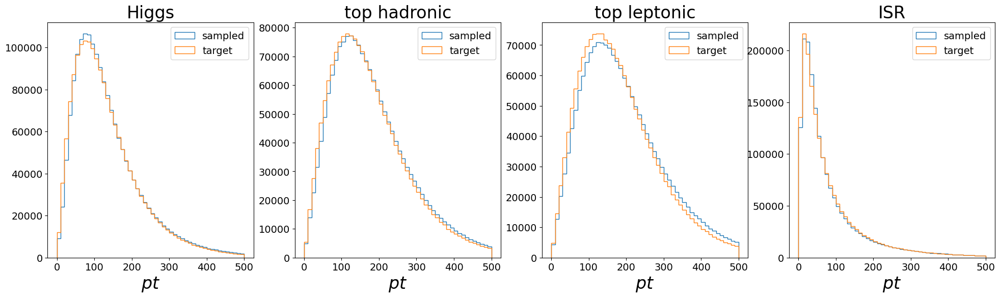

In [69]:
f, axs = plt.subplots(1,4 , figsize =(24,6))
axs[0].hist(Hs.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[0].hist(higgsCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[0].legend(fontsize=14)
axs[0].set_xlabel('$pt$', fontsize=24)
axs[0].tick_params(axis='both', which='major', labelsize=14)
axs[0].set_title("Higgs", fontsize=24)

axs[1].hist(t1s.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[1].hist(thadCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[1].legend(fontsize=14)
axs[1].tick_params(axis='both', which='major', labelsize=14)
axs[1].set_xlabel('$pt$', fontsize=24)
axs[1].set_title("top hadronic", fontsize=24)

axs[2].hist(t2s.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[2].hist(tlepCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[2].legend(fontsize=14)
axs[2].tick_params(axis='both', which='major', labelsize=14)
axs[2].set_xlabel('$pt$', fontsize=24)
axs[2].set_title("top leptonic", fontsize=24)

axs[3].hist(isrs.pt, bins=50, range=(0,500), histtype="step", label="sampled");
axs[3].hist(glISRCorrect.pt, bins=50, range=(0,500), histtype="step",  label="target");
axs[3].legend(fontsize=14)
axs[3].tick_params(axis='both', which='major', labelsize=14)
axs[3].set_xlabel('$pt$', fontsize=24)
axs[3].set_title("ISR", fontsize=24)

## Multisample avg

In [49]:
N= 1000000 * 10
out= {
    "H_pt": np.zeros(N),
    "H_eta": np.zeros(N),
    "H_phi": np.zeros(N),
    "t1_pt": np.zeros(N),
    "t1_eta": np.zeros(N),
    "t1_phi": np.zeros(N),
    "t2_pt": np.zeros(N),
    "t2_eta": np.zeros(N),
    "t2_phi": np.zeros(N),
    "isr_pt": np.zeros(N),
    "isr_eta": np.zeros(N),
    "isr_phi": np.zeros(N),
    #"Njets": mask_jets.sum(1).cpu().numpy(),
    "x1":  np.zeros(N),
    "x2":  np.zeros(N),

    
    "delta_x1": np.zeros(N),
    "delta_x2": np.zeros(N),

    #"sigma_x1": x1pp.std(1).cpu().numpy(),
    #"sigma_x2":  x2pp.std(1).cpu().numpy(),
    
    "delta_H_pt": np.zeros(N),
    "delta_H_eta": np.zeros(N),
    "delta_H_phi": np.zeros(N),
    
    "delta_t1_pt": np.zeros(N),
    "delta_t1_eta": np.zeros(N),
    "delta_t1_phi": np.zeros(N),
    
    "delta_t2_pt": np.zeros(N),
    "delta_t2_eta": np.zeros(N),
    "delta_t2_phi": np.zeros(N),

    "delta_isr_pt": np.zeros(N),
    "delta_isr_eta": np.zeros(N),
    "delta_isr_phi": np.zeros(N),

    "delta_H_pt_regr": np.zeros(N),
    "delta_H_eta_regr": np.zeros(N),
    "delta_H_phi_regr": np.zeros(N),
    
    "delta_t1_pt_regr": np.zeros(N),
    "delta_t1_eta_regr": np.zeros(N),
    "delta_t1_phi_regr": np.zeros(N),
    
    "delta_t2_pt_regr": np.zeros(N),
    "delta_t2_eta_regr": np.zeros(N),
    "delta_t2_phi_regr": np.zeros(N),

    "delta_isr_pt_regr": np.zeros(N),
    "delta_isr_eta_regr": np.zeros(N),
    "delta_isr_phi_regr": np.zeros(N),
}


In [50]:
outputs = []
batch_size = 10000
#Nsamples = ps_samples.shape[1]
Nsamples = 10

for b in track(range(100)):
    ps_unscaled = torch.sigmoid(ps_samples[b*batch_size:(b+1)*batch_size, 0:Nsamples]*scale_ps.to("cpu") + mean_ps.to("cpu"))
    ps_new_flat = ps_unscaled.flatten(0, 1)
    momenta, weight, x1pp, x2pp = phasespace.get_momenta_from_ps(ps_new_flat)
    x1pp = x1pp.reshape(-1, Nsamples)
    x2pp = x2pp.reshape(-1, Nsamples)
    momenta = momenta.reshape(-1,Nsamples, 6, 4)#.transpose(1, 0)
    Hs, t1s, t2s, isrs = get_particle_awkward_samples(momenta.cpu())
    
    Nevents= ps_samples.shape[0]

    # H, t1, t2, isr = (higgsCorrect[b*batch_size:(b+1)*batch_size], 
    # thadCorrect[b*batch_size:(b+1)*batch_size],
    # tlepCorrect[b*batch_size:(b+1)*batch_size], glISRCorrect[b*batch_size:(b+1)*batch_size])
    # Duplicate the 
    dCM = dataCM[b*batch_size:(b+1)*batch_size].unsqueeze(1).expand(-1, Nsamples, -1,-1).cpu()

    boostData = boost_parton[b*batch_size:(b+1)*batch_size].unsqueeze(1).expand(-1, Nsamples, -1,-1).cpu()
    x1true = (boostData[:,:,0,0]+boostData[:,:,0,3])/E_CM
    x2true = (boostData[:,:,0,0]-boostData[:,:,0,3])/E_CM
    
    H, t1, t2, isr = get_particle_awkward_samples(dCM.cpu(),offset=0)
    regrCM = regr_data[b*batch_size:(b+1)*batch_size].unsqueeze(1).expand(-1, Nsamples, -1,-1).cpu()
    Hr, t1r, t2r, isrr = get_particle_awkward_samples(regrCM.cpu(), offset=0)

    diff_H_pt = Hs.pt - H.pt
    diff_H_eta = Hs.eta - H.eta
    diff_H_phi = Hs.phi - H.phi

    diff_t1_pt = t1s.pt - t1.pt
    diff_t1_eta = t1s.eta - t1.eta
    diff_t1_phi = t1s.phi - t1.phi

    diff_t2_pt = t2s.pt - t2.pt
    diff_t2_eta = t2s.eta - t2.eta
    diff_t2_phi = t2s.phi - t2.phi
    
    diff_isr_pt = isrs.pt - isr.pt
    diff_isr_eta = isrs.eta - isr.eta
    diff_isr_phi = isrs.phi - isr.phi

    diff_H_pt_regr = Hs.pt - Hr.pt
    diff_H_eta_regr = Hs.eta - Hr.eta
    diff_H_phi_regr = Hs.phi - Hr.phi

    diff_t1_pt_regr = t1s.pt - t1r.pt
    diff_t1_eta_regr = t1s.eta - t1r.eta
    diff_t1_phi_regr = t1s.phi - t1r.phi

    diff_t2_pt_regr = t2s.pt - t2r.pt
    diff_t2_eta_regr = t2s.eta - t2r.eta
    diff_t2_phi_regr = t2s.phi - t2r.phi
    
    diff_isr_pt_regr = isrs.pt - isrr.pt
    diff_isr_eta_regr = isrs.eta - isrr.eta
    diff_isr_phi_regr = isrs.phi - isrr.phi


    out["H_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(H.pt))
    out["H_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(H.eta))
    out["H_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(H.phi))

    out["t1_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(t1.pt))
    out["t1_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(t1.eta))
    out["t1_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(t1.phi))
    
    out["t2_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(t2.pt))
    out["t2_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(t2.eta))
    out["t2_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(t2.phi))
    out["isr_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(isr.pt))
    out["isr_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(isr.eta))
    out["isr_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(ak.to_numpy(isr.phi))

    out["x1"][b*batch_size*10: (b+1)*batch_size*10] =  x1true.cpu().numpy().flatten()
    out["x2"][b*batch_size*10: (b+1)*batch_size*10] =  x2true.cpu().numpy().flatten()
    
    out["delta_x1"][b*batch_size*10: (b+1)*batch_size*10] = (x1pp - x1true).cpu().numpy().flatten()
    out["delta_x2"][b*batch_size*10: (b+1)*batch_size*10] = (x2pp - x2true).cpu().numpy().flatten()
     
    out["delta_H_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_H_pt)
    out["delta_H_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_H_eta)
    out["delta_H_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_H_phi)

    out["delta_t1_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t1_pt)
    out["delta_t1_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t1_eta)
    out["delta_t1_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t1_phi)

    out["delta_t2_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t2_pt)
    out["delta_t2_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t2_eta)
    out["delta_t2_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t2_phi)

    out["delta_isr_pt"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_isr_pt)
    out["delta_isr_eta"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_isr_eta)
    out["delta_isr_phi"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_isr_phi)

    out["delta_H_pt_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_H_pt_regr)
    out["delta_H_eta_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_H_eta_regr)
    out["delta_H_phi_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_H_phi_regr)

    out["delta_t1_pt_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t1_pt_regr)
    out["delta_t1_eta_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t1_eta_regr)
    out["delta_t1_phi_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t1_phi_regr)

    out["delta_t2_pt_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t2_pt_regr)
    out["delta_t2_eta_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t2_eta_regr)
    out["delta_t2_phi_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_t2_phi_regr)

    out["delta_isr_pt_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_isr_pt_regr)
    out["delta_isr_eta_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_isr_eta_regr)
    out["delta_isr_phi_regr"][b*batch_size*10: (b+1)*batch_size*10] =  ak.flatten(diff_isr_phi_regr)
   


Output()

In [ ]:
with h5py.File(f"{basedir_flow}/bias_analysis_dump_flow_v3f-sampling.csv", 'a') as f:
    for k, a in out.items():
         f.create_dataset(k, (N,), dtype='f', data=a)
    

In [ ]:
total = {}

for k in outputs[0].keys():
    if k in ["sigma_x1", "sigma_x2", "x1", "x2"]: continue
    total[k] = np.stack([v[k] for v in outputs],0).flatten()

df = pd.DataFrame(total) 
df.to_csv("bias_analysis_dump_flow_v3f-sampling.csv", index=False,sep=";")

In [21]:
def plot_results(df, var, xrange=None, xrange2=None):
    f, axs = plt.subplots(1, 2, figsize=(8, 4), dpi=100)
    axs[0].hist(df[f"delta_{var}"], bins=100, range=xrange if xrange else None);
    #axs[1].hist(df[f"sigma_{var}"], bins=100, range=xrange2 if xrange2 else None);
    axs[0].set_xlabel(f"delta_{var}")
    #axs[1].set_xlabel(f"sigma_{var}")
    f.show()

/tmp/ipykernel_16593/555069074.py:7: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  f.show()


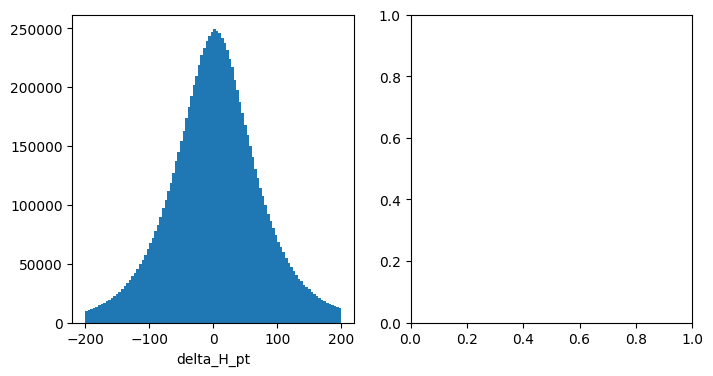

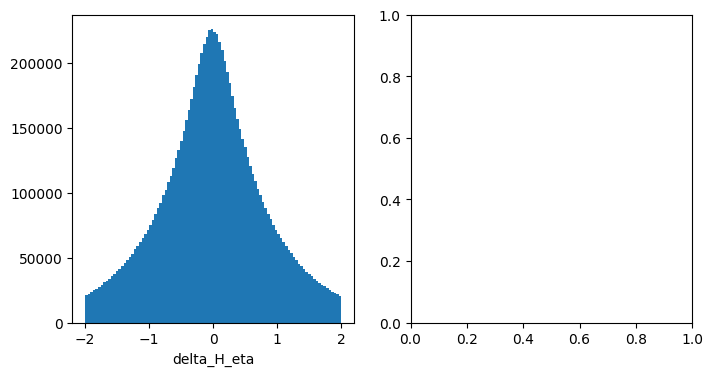

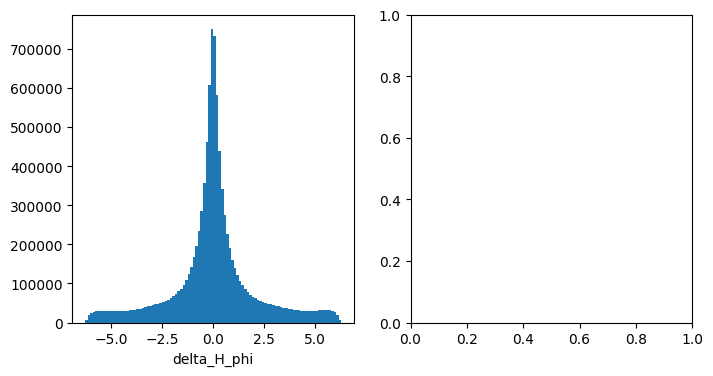

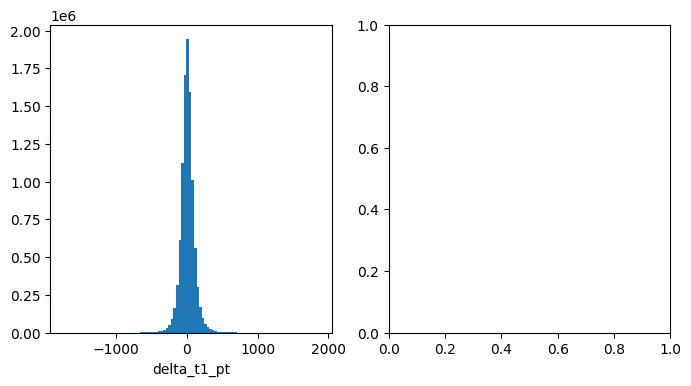

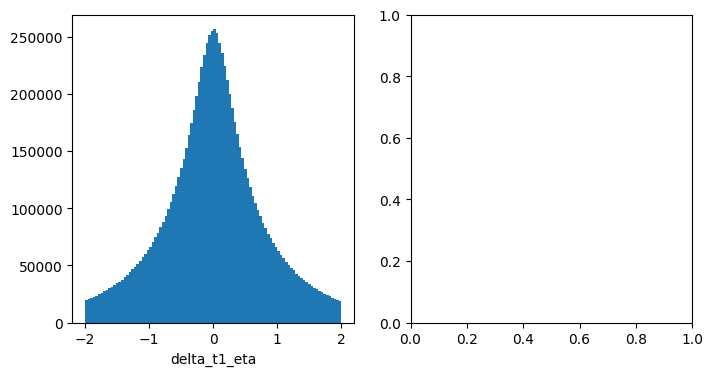

...

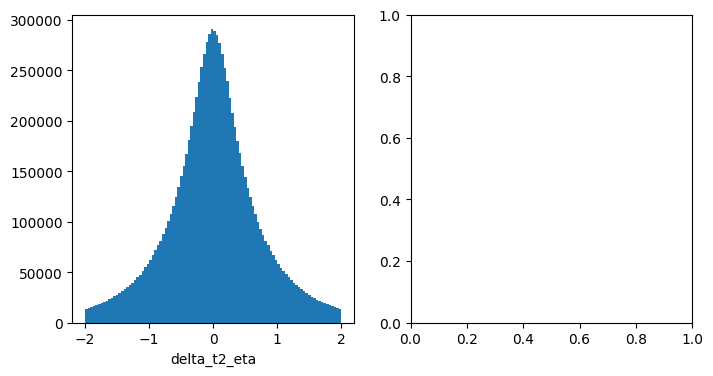

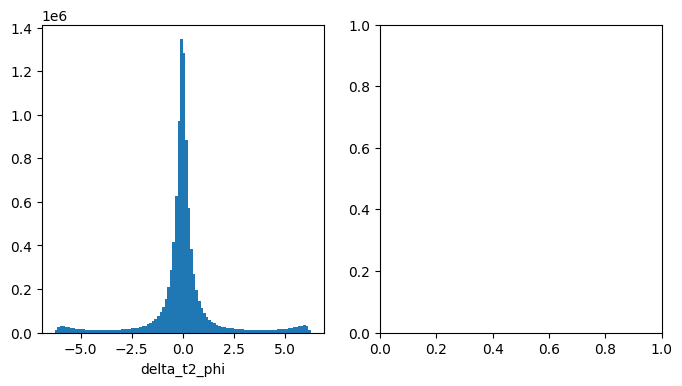

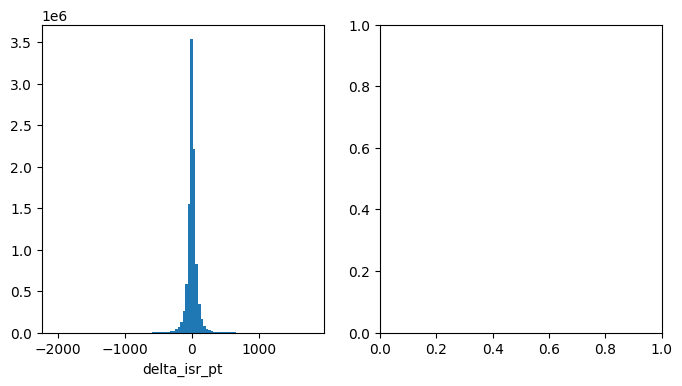

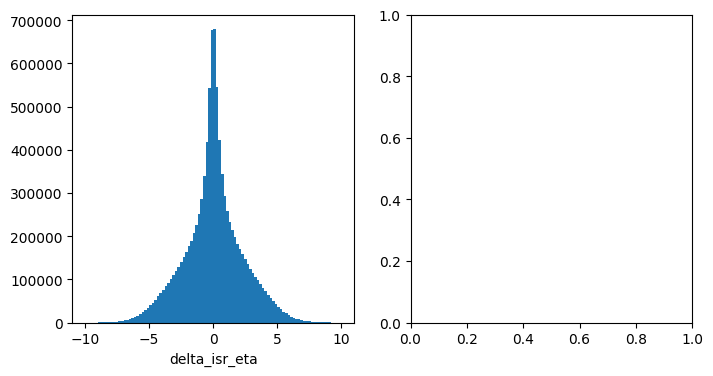

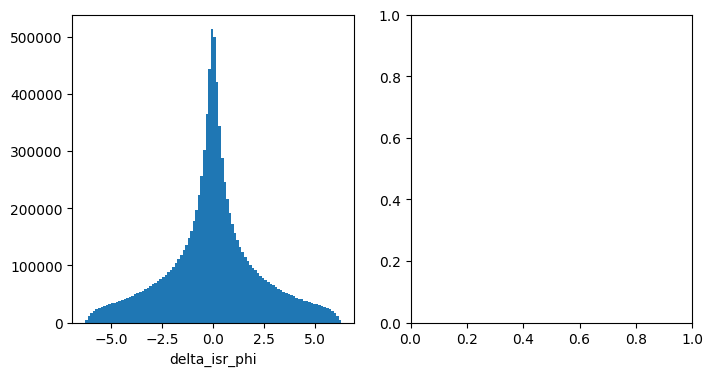

In [23]:
plot_results(out, "H_pt", xrange=(-200,200))
plot_results(out, "H_eta", xrange=(-2,2))
plot_results(out, "H_phi")
plot_results(out, "t1_pt")
plot_results(out, "t1_eta", xrange=(-2,2))
plot_results(out, "t1_phi")
plot_results(out, "t2_pt")
plot_results(out, "t2_eta",xrange=(-2,2))
plot_results(out, "t2_phi")
plot_results(out, "isr_pt")
plot_results(out, "isr_eta", xrange=(-10,10), xrange2=(0, 10))
plot_results(out, "isr_phi")

<Figure size 1000x1000 with 0 Axes>

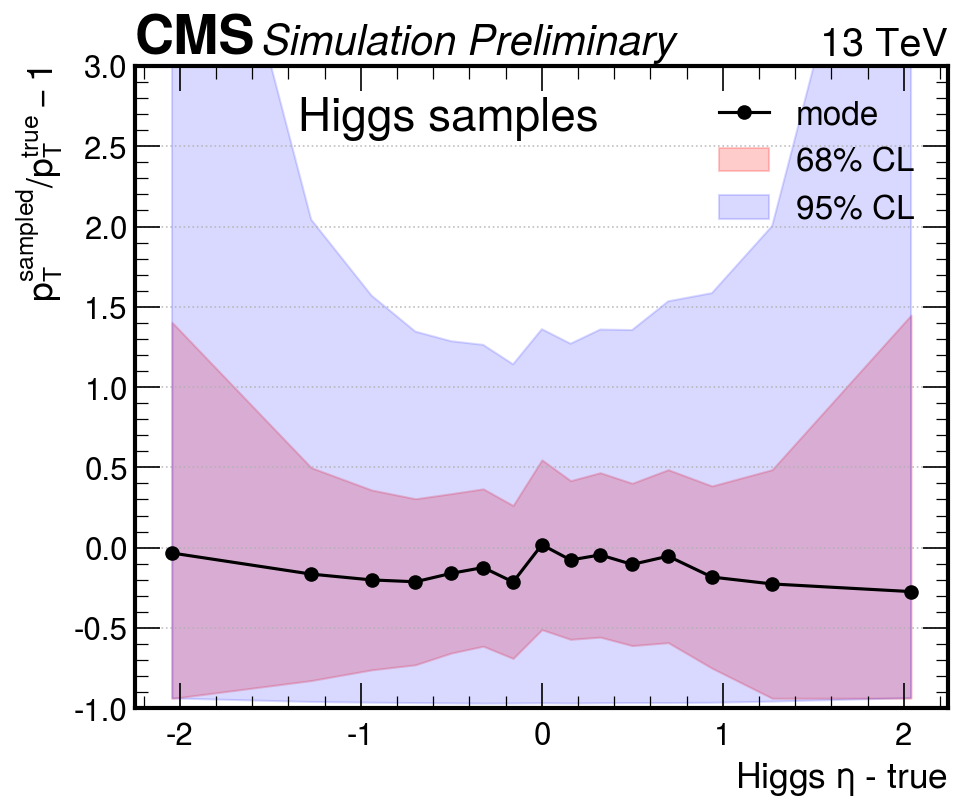

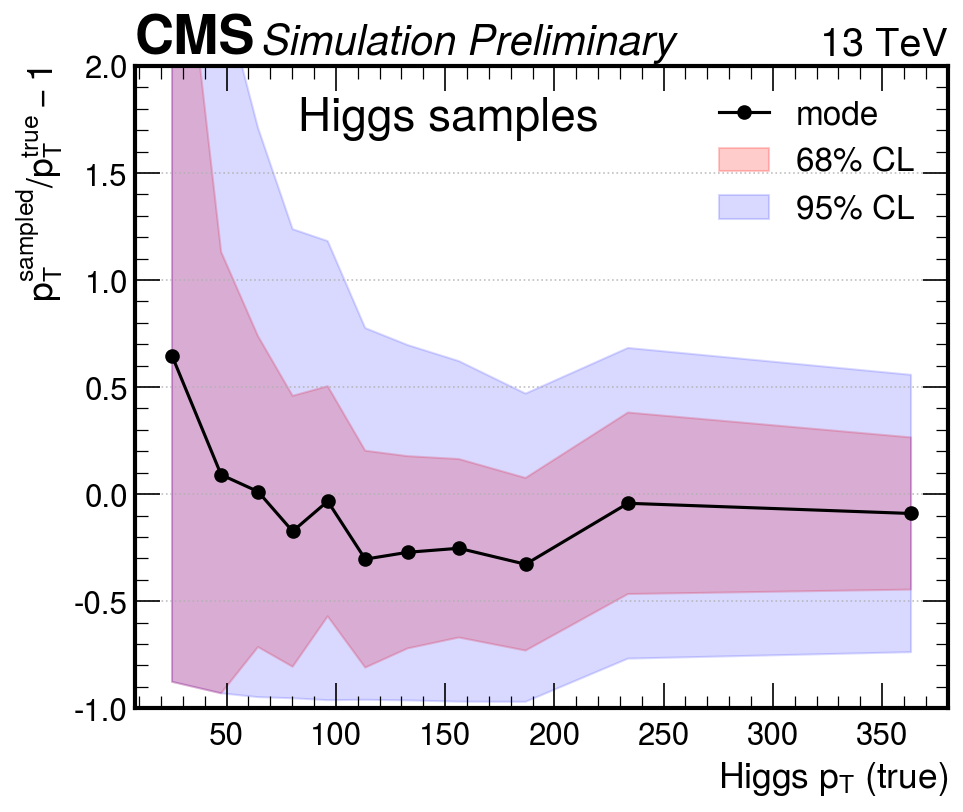

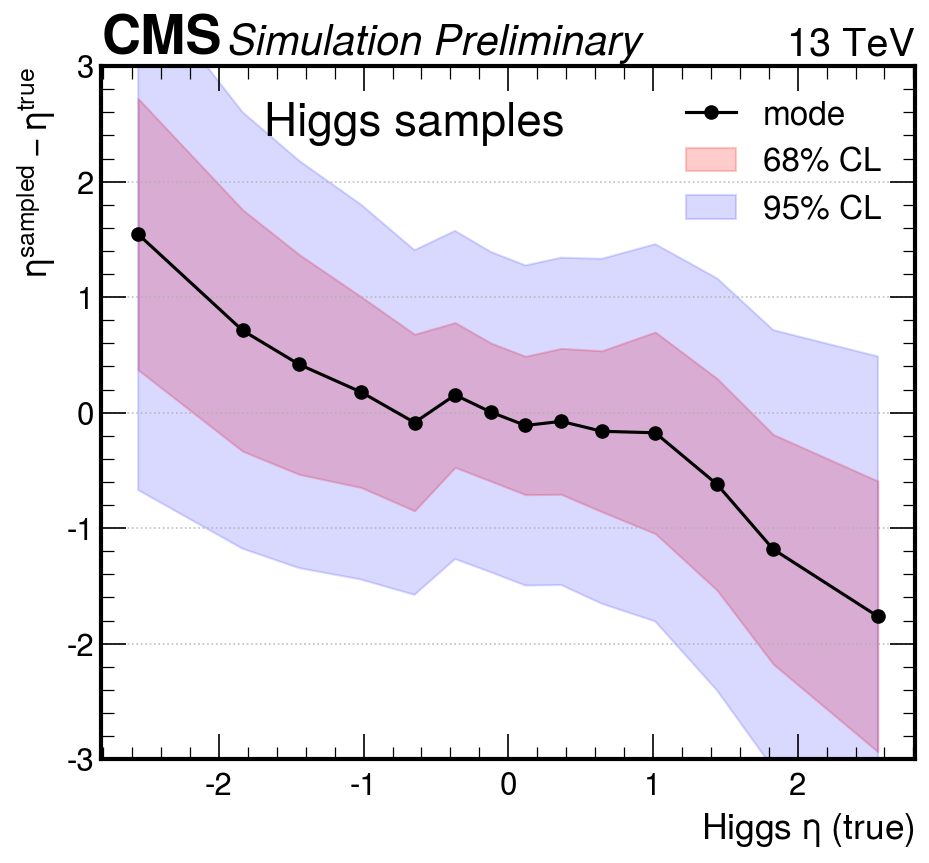

In [51]:
plot_diff_mode_quantile((out["delta_H_pt"]/out["H_pt"]), 
                        X=out["H_eta"],  
                        cat_var=out["H_eta"], 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(out["H_eta"], np.linspace(0,1,16)),
                         xlabel='Higgs $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Higgs samples',
                       output_file=output+"/Higgs_samplesbias_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((out["delta_H_pt"]/out["H_pt"]), 
                        X=out["H_pt"],  
                        cat_var=out["H_pt"], 
                        bins=np.quantile(out["H_pt"], np.linspace(0,1,12)),
                         xlabel='Higgs $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Higgs samples',nbins_mode=100,
                        output_file=output+"/Higgs_samplesbias_deltaPt_byPt")

plot_diff_mode_quantile((out["delta_H_eta"]), 
                        X=out["H_eta"],  
                        cat_var=out["H_eta"], 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                         bins=np.quantile(out["H_eta"], [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                       xlabel='Higgs $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{sampled} - \eta^{true}$', title='Higgs samples',nbins_mode=50,
                        output_file=output+"/Higgs_samplesbias_deltaEta_byEta")

# plot_diff_mode_quantile(out["delta_H_phi"], 
#                         X=out["H_eta"],  
#                         cat_var=out["H_eta"], 
#                         # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
#                         #       -0.5, -0.2, -0., 0.2,0.5,
#                         #       1., 1.2, 1.6, 2.,4.],|
#                         bins=np.quantile(out["H_eta"], np.linspace(0,1,16)),
#                         xlabel='Higgs True $\eta$', ylim=(-pi,pi),
#                     ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

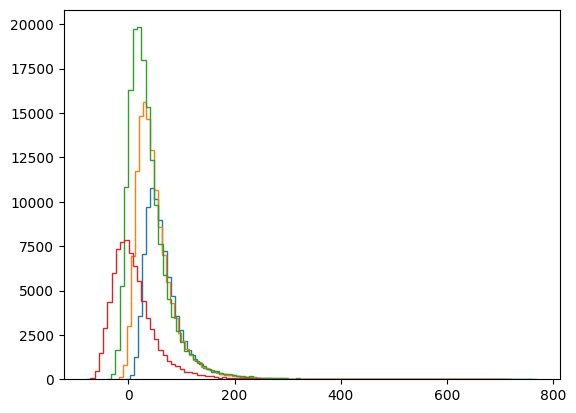

In [81]:
plt.hist(df.delta_H_pt[df.H_pt<30], bins=100, histtype="step");
plt.hist(df.delta_H_pt[(df.H_pt>30)&(df.H_pt<50)], bins=100, histtype="step");
plt.hist(df.delta_H_pt[(df.H_pt>50)&(df.H_pt<70)], bins=100, histtype="step");
plt.hist(df.delta_H_pt[(df.H_pt>100)&(df.H_pt<110)], bins=100, histtype="step");

<Figure size 1000x1000 with 0 Axes>

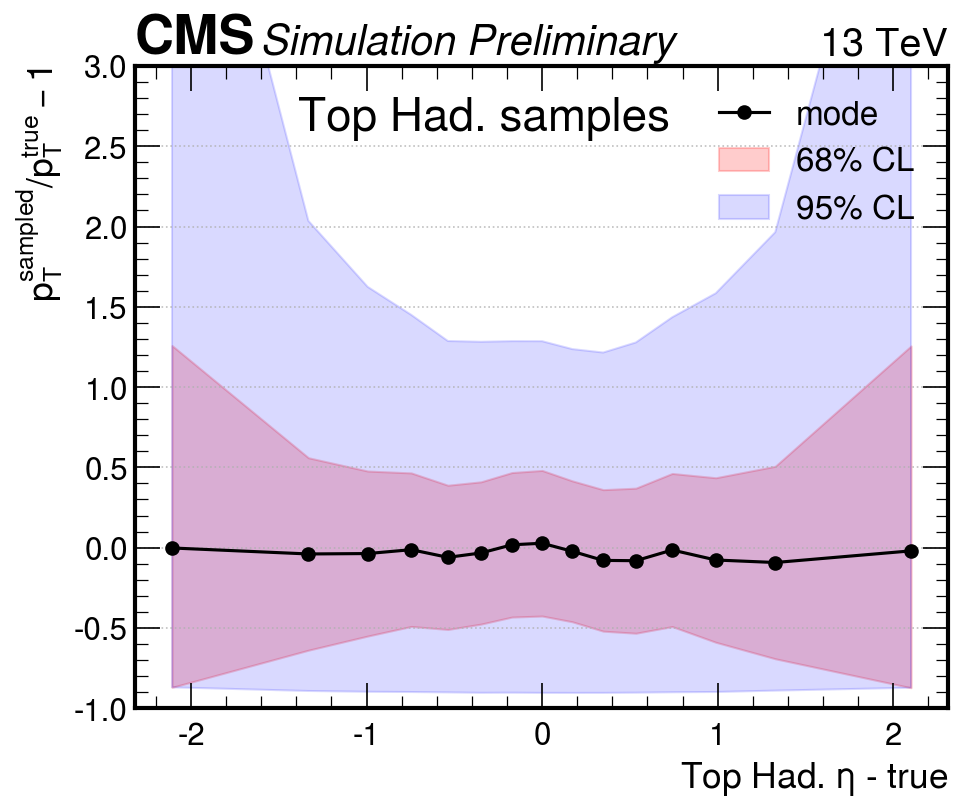

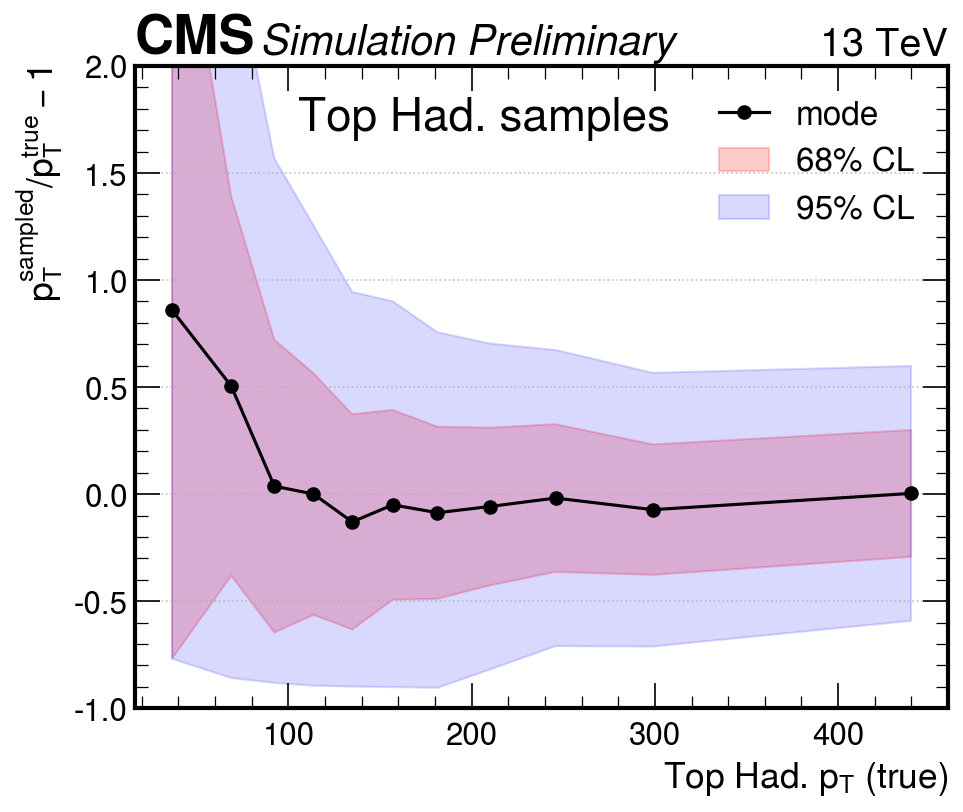

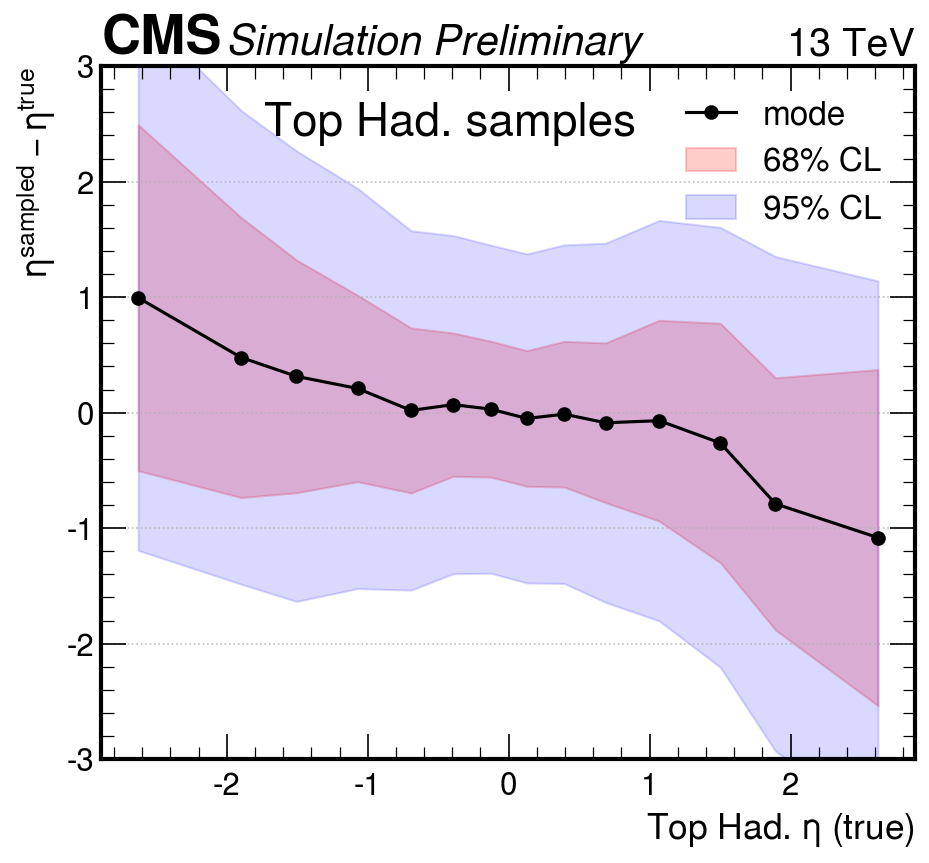

In [176]:
plot_diff_mode_quantile((out["delta_t1_pt"]/out["t1_pt"]), 
                        X=out["t1_eta"],  
                        cat_var=out["t1_eta"], 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(out["t1_eta"], np.linspace(0,1,16)),
                         xlabel='Top Had. $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Top Had. samples',
                       output_file=output+"/TopHad_samplesbias_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((out["delta_t1_pt"]/out["t1_pt"]), 
                        X=out["t1_pt"],  
                        cat_var=out["t1_pt"], 
                        bins=np.quantile(out["t1_pt"], np.linspace(0,1,12)),
                         xlabel='Top Had. $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Top Had. samples',nbins_mode=100,
                        output_file=output+"/TopHad_samplesbias_deltaPt_byPt")

plot_diff_mode_quantile((out["delta_t1_eta"]), 
                        X=out["t1_eta"],  
                        cat_var=out["t1_eta"], 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                         bins=np.quantile(out["t1_eta"], [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                       xlabel='Top Had. $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{sampled} - \eta^{true}$', title='Top Had. samples',nbins_mode=50,
                        output_file=output+"/TopHad_samplesbias_deltaEta_byEta")

# plot_diff_mode_quantile(out["delta_t1_phi"], 
#                         X=out["t1_eta"],  
#                         cat_var=out["t1_eta"], 
#                         # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
#                         #       -0.5, -0.2, -0., 0.2,0.5,
#                         #       1., 1.2, 1.6, 2.,4.],|
#                         bins=np.quantile(out["t1_eta"], np.linspace(0,1,16)),
#                         xlabel='Top Had. True $\eta$', ylim=(-pi,pi),
#                     ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

<Figure size 1000x1000 with 0 Axes>

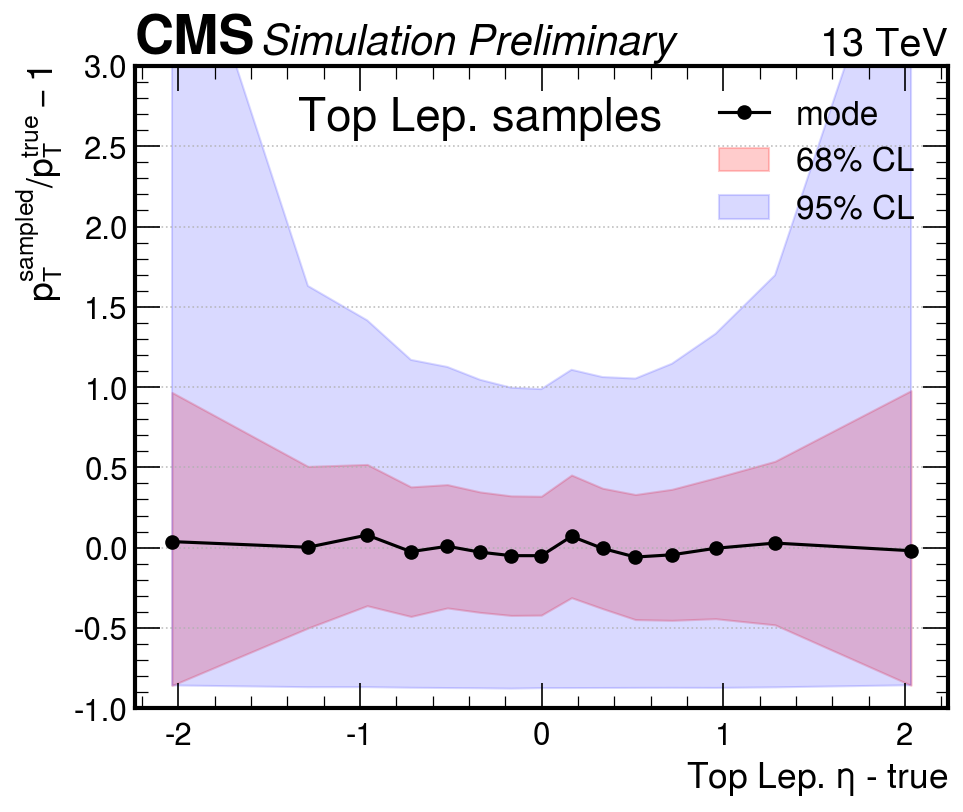

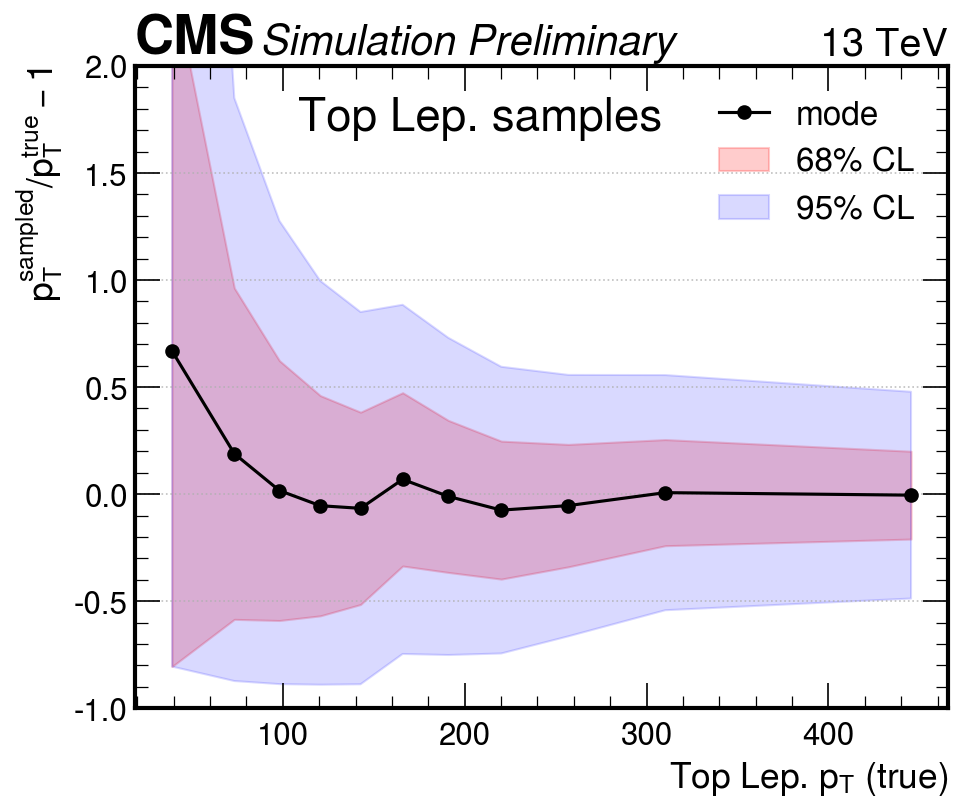

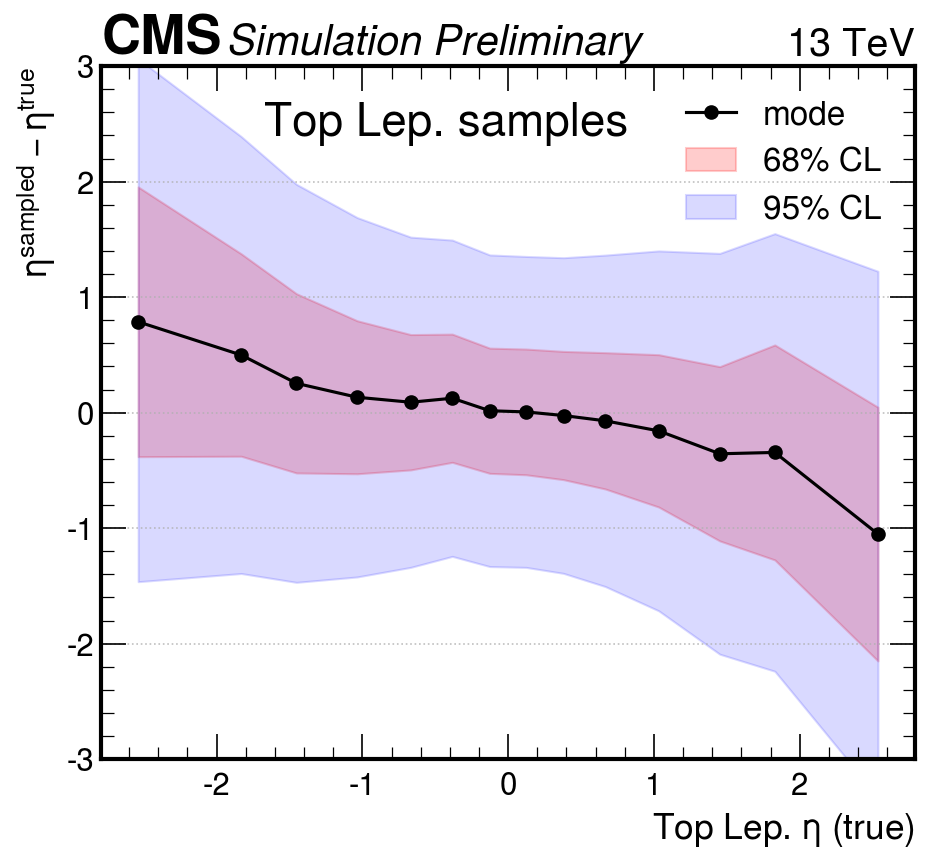

In [177]:
plot_diff_mode_quantile((out["delta_t2_pt"]/out["t2_pt"]), 
                        X=out["t2_eta"],  
                        cat_var=out["t2_eta"], 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(out["t2_eta"], np.linspace(0,1,16)),
                         xlabel='Top Lep. $\eta$ - true', ylim=(-1,3),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Top Lep. samples',
                       output_file=output+"/TopLep_samplesbias_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((out["delta_t2_pt"]/out["t2_pt"]), 
                        X=out["t2_pt"],  
                        cat_var=out["t2_pt"], 
                        bins=np.quantile(out["t2_pt"], np.linspace(0,1,12)),
                         xlabel='Top Lep. $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Top Lep. samples',nbins_mode=100,
                        output_file=output+"/TopLep_samplesbias_deltaPt_byPt")

plot_diff_mode_quantile((out["delta_t2_eta"]), 
                        X=out["t2_eta"],  
                        cat_var=out["t2_eta"], 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                         bins=np.quantile(out["t2_eta"], [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                       xlabel='Top Lep. $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{sampled} - \eta^{true}$', title='Top Lep. samples',nbins_mode=50,
                        output_file=output+"/TopLep_samplesbias_deltaEta_byEta")

# plot_diff_mode_quantile(out["delta_t2_phi"], 
#                         X=out["t2_eta"],  
#                         cat_var=out["t2_eta"], 
#                         # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
#                         #       -0.5, -0.2, -0., 0.2,0.5,
#                         #       1., 1.2, 1.6, 2.,4.],|
#                         bins=np.quantile(out["t2_eta"], np.linspace(0,1,16)),
#                         xlabel='Top Lep. True $\eta$', ylim=(-pi,pi),
#                     ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

<Figure size 1000x1000 with 0 Axes>

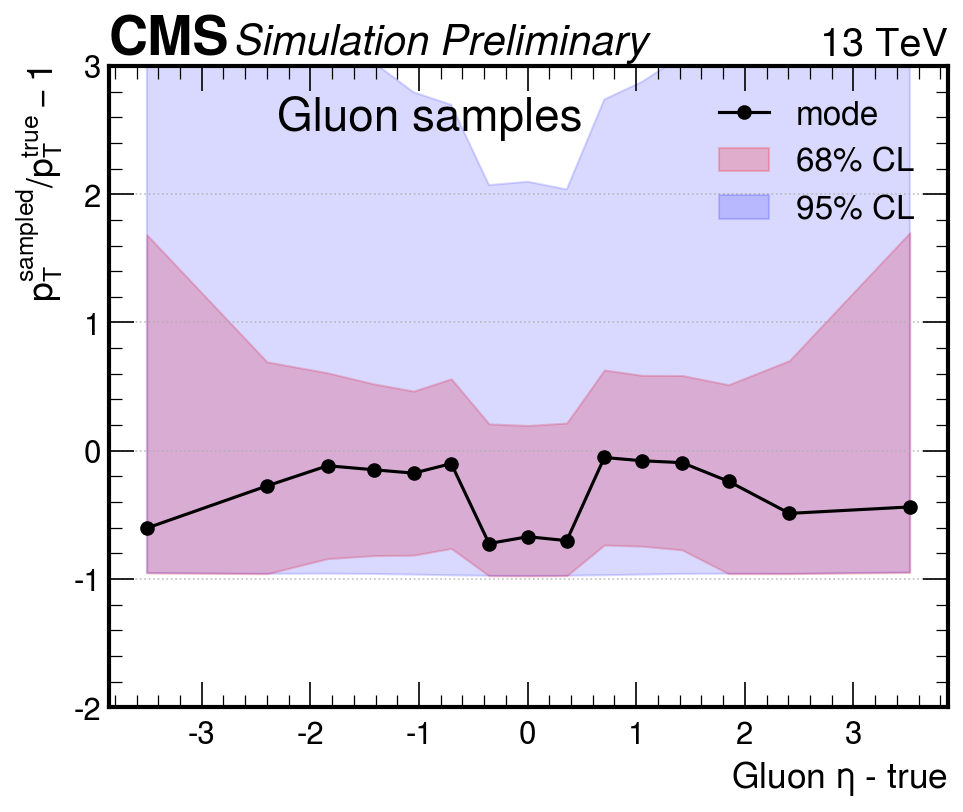

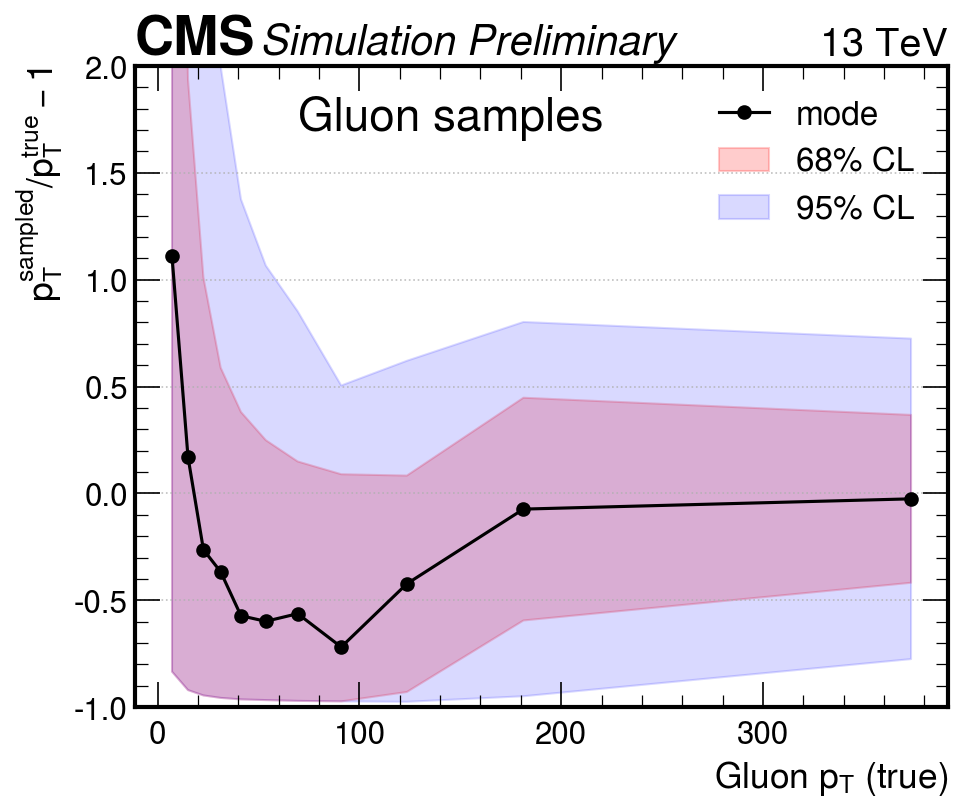

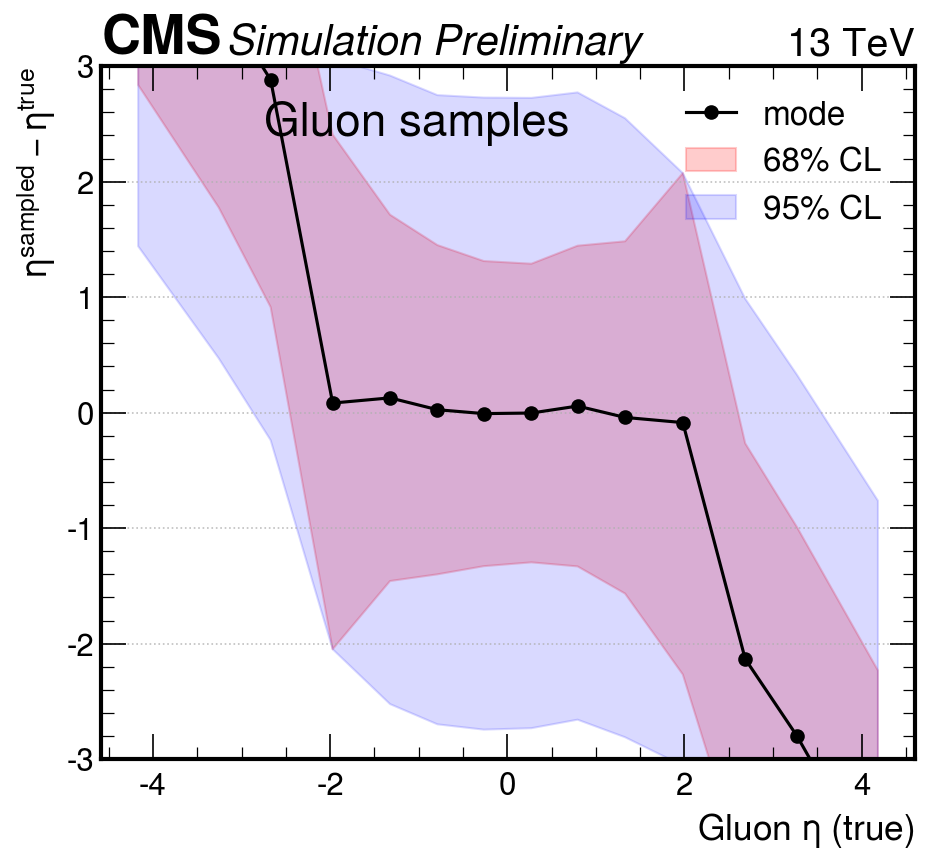

In [179]:
plot_diff_mode_quantile((out["delta_isr_pt"]/out["isr_pt"]), 
                        X=out["isr_eta"],  
                        cat_var=out["isr_eta"], 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile(out["isr_eta"], np.linspace(0,1,16)),
                         xlabel='Gluon $\eta$ - true', ylim=(-2,3),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Gluon samples',
                       output_file=output+"/Gluon_samplesbias_deltaPt_byEta",nbins_mode=100)

plot_diff_mode_quantile((out["delta_isr_pt"]/out["isr_pt"]), 
                        X=out["isr_pt"],  
                        cat_var=out["isr_pt"], 
                        bins=np.quantile(out["isr_pt"], np.linspace(0,1,12)),
                         xlabel='Gluon $p_T$ (true)', ylim=(-1,2),
                    ylabel='$p_T^{sampled}/p_T^{true} -1 $', title='Gluon samples',nbins_mode=100,
                        output_file=output+"/Gluon_samplesbias_deltaPt_byPt")

plot_diff_mode_quantile((out["delta_isr_eta"]), 
                        X=out["isr_eta"],  
                        cat_var=out["isr_eta"], 
                        # bins=[-4,-2.2,-2.,-1.6, -1.2, -1.0, 
                        #       -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                        #       1., 1.2, 1.6, 2., 2.2,4],
                         bins=np.quantile(out["isr_eta"], [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                       xlabel='Gluon $\eta$ (true)', ylim=(-3,3),
                    ylabel='$\eta^{sampled} - \eta^{true}$', title='Gluon samples',nbins_mode=50,
                        output_file=output+"/Gluon_samplesbias_deltaEta_byEta")

# plot_diff_mode_quantile(out["delta_isr_phi"], 
#                         X=out["isr_eta"],  
#                         cat_var=out["isr_eta"], 
#                         # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
#                         #       -0.5, -0.2, -0., 0.2,0.5,
#                         #       1., 1.2, 1.6, 2.,4.],|
#                         bins=np.quantile(out["isr_eta"], np.linspace(0,1,16)),
#                         xlabel='Gluon True $\eta$', ylim=(-pi,pi),
#                     ylabel='$\phi^{regr} - \phi^{true} $', title='Higgs') 

In [32]:
target = 1
mask = ((df.t1_eta>(target-0.1))&(df.t1_eta<(target+0.1)))

X = (df.t1_eta+ df.delta_t1_eta)[mask]
mode, left, right = get_central_smallest_interval(X.values, 
                xrange=(np.quantile(X, 0.03), np.quantile(X, 0.97)),
                    nbins=X.size//100, Ntrial=1000, perc=0.68)
plt.hist(X, bins=50, range=(-3,3), histtype="step");
plt.axvline(np.mean(X), c='r', label="avg")
plt.axvline(target, c='g', label="target")
plt.axvline(mode, c='b', label="mode")
plt.axvline(left, c='cyan',  linestyle="dashed", label="68")
plt.axvline(right, c='cyan',  linestyle="dashed",)
plt.legend()
#plt.axvline( torch.quantile(data_regressed[mask, 0, 1]), c='r')

AttributeError: 'File' object has no attribute 't1_eta'

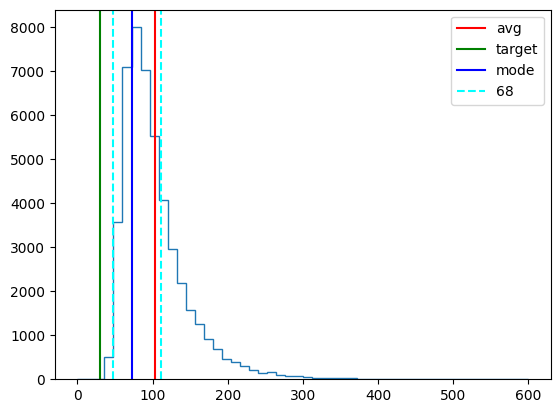

In [86]:
target = 30
mask = ((df.t2_pt>(target-10))&(df.t2_pt<(target+10)))

X = (df.t2_pt+ df.delta_t2_pt)[mask]
mode, left, right = get_central_smallest_interval(X.values, 
                xrange=(np.quantile(X, 0.03), np.quantile(X, 0.97)),
                    nbins=X.size//100, Ntrial=1000, perc=0.68)
plt.hist(X, bins=50, range=(0,600), histtype="step");
plt.axvline(np.mean(X), c='r', label="avg")
plt.axvline(target, c='g', label="target")
plt.axvline(mode, c='b', label="mode")
plt.axvline(left, c='cyan',  linestyle="dashed", label="68")
plt.axvline(right, c='cyan',  linestyle="dashed",)
plt.legend()
#plt.axvline( torch.quantile(data_regressed[mask, 0, 1]), c='r')

In [181]:
total["delta_x1"].shape

(2000,)

In [180]:
(total["x1"]+total["x2"]).shape

(1000000,)

In [87]:
plot_diff_mode_quantile(total["delta_x1"], 
                        X=total["x1"]+total["x2"],  
                        cat_var=total["x1"]+total["x2"], 
                        # bins =[-4.,-2.,-1.6, -1.2, -1.0, 
                        #       -0.5, -0.2, -0., 0.2,0.5,
                        #       1., 1.2, 1.6, 2.,4.],|
                        bins=np.quantile((total["x1"]+total["x2"]), np.linspace(0,1,16)),
                        xlabel='Gluon True $\eta$', ylim=(-1,2),
                    ylabel='$p_T^{regr}/p_T^{true} -1 $', title='Gluon')

KeyError: 'x1'

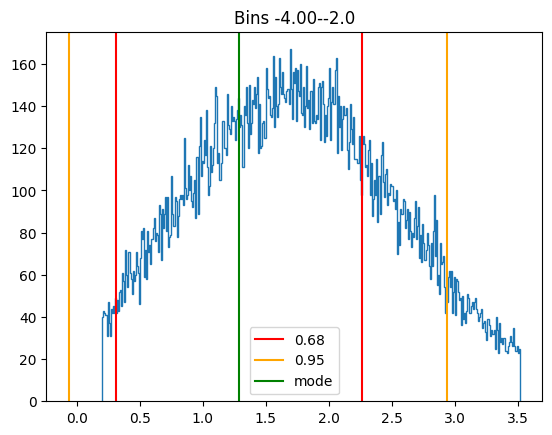

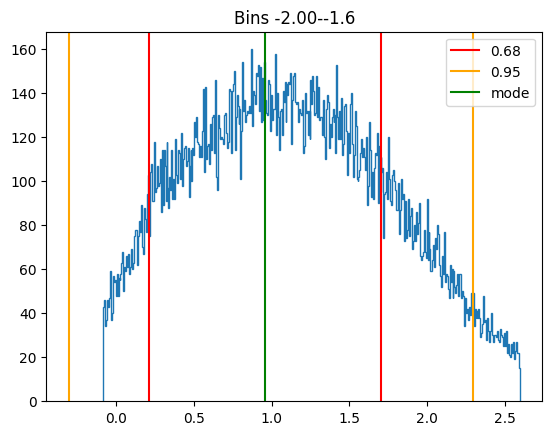

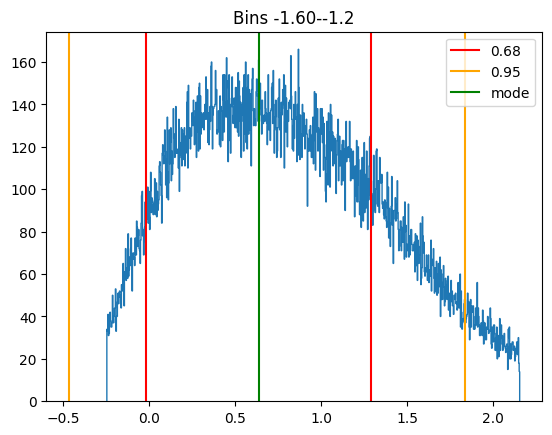

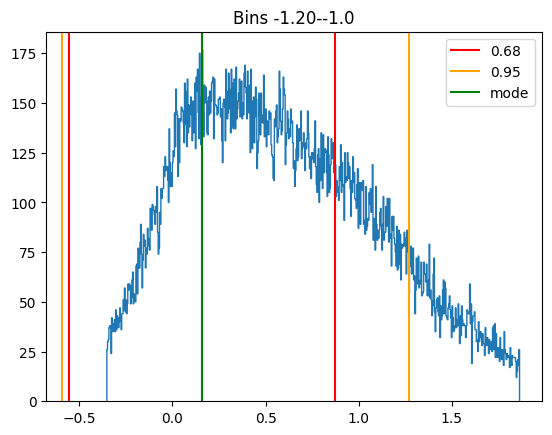

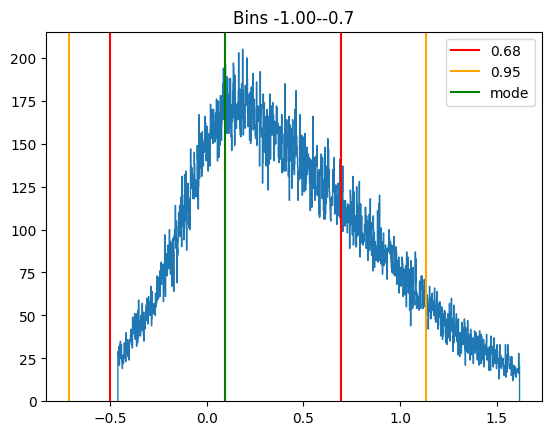

...

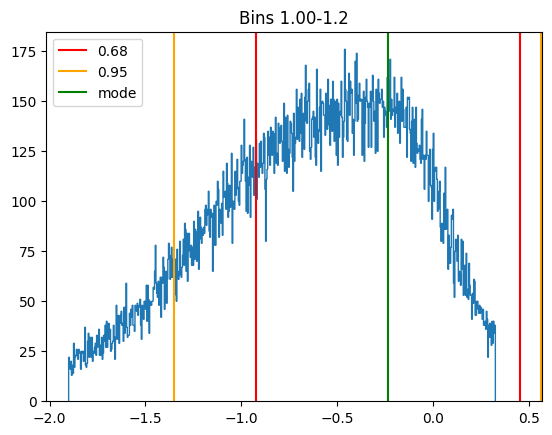

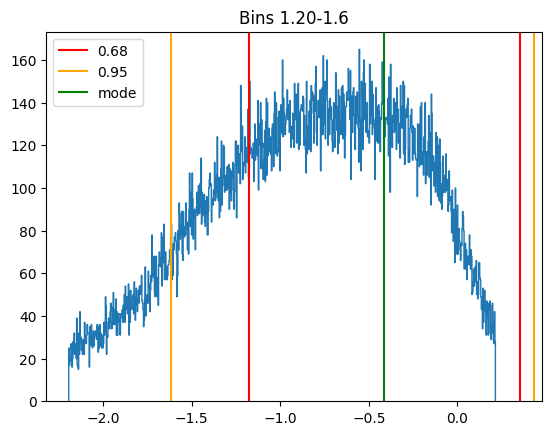

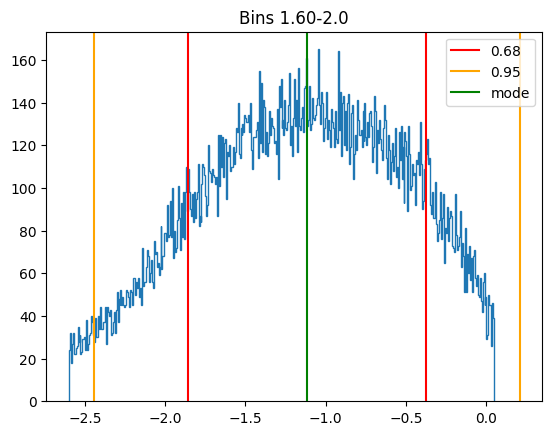

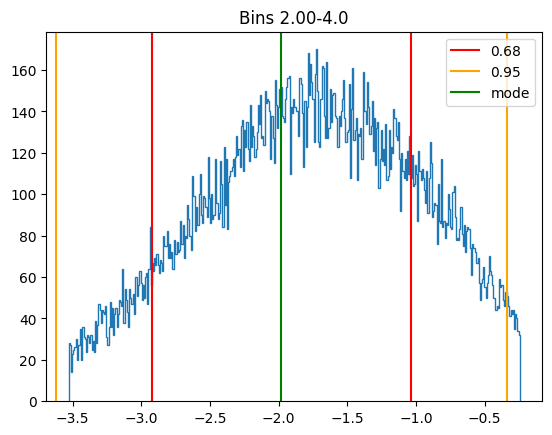

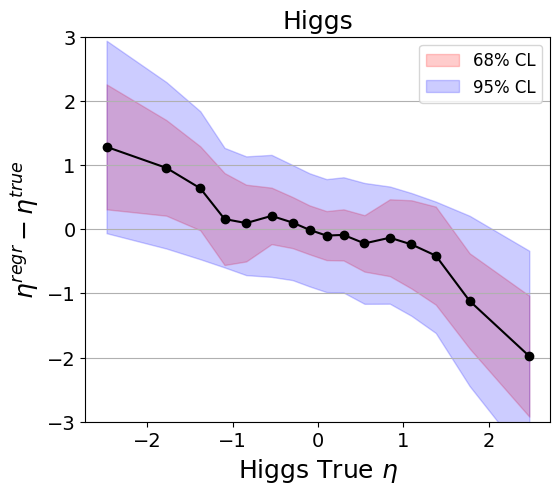

In [89]:
plot_diff_mode_quantile((df.delta_H_eta).values, 
                        X=df.H_eta.values,  
                        cat_var=df.H_eta.values, 
                        bins=[-4.,-2.,-1.6, -1.2, -1.0, 
                               -0.7, -0.4, -0.2, -0., 0.2,0.4, 0.7,
                               1., 1.2, 1.6, 2.,4.], nbins_mode =20,
                        #bins=np.quantile(df.H_eta.values, [0,0.025, 0.05,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,0.95,0.975, 1.]),
                        xlabel='Higgs True $\eta$', ylim=(-3,3),
                    ylabel='$\eta^{regr} - \eta^{true}$', title='Higgs', 
                       debug=True)


In [187]:
boost_pz_sampled = (out["delta_x1"] + out["x1"] - (out["delta_x2"] + out["x2"]))*13000/2
boost_pz_true = (out["x1"] - out["x2"])*13000/2

In [188]:
cm_M_sampled = ((out["delta_x1"] + out["x1"] )*(out["delta_x2"] + out["x2"]))**0.5 * 13000
cm_M_true = (( out["x1"] )*( out["x2"]))**0.5 * 13000

<Figure size 1000x1000 with 0 Axes>

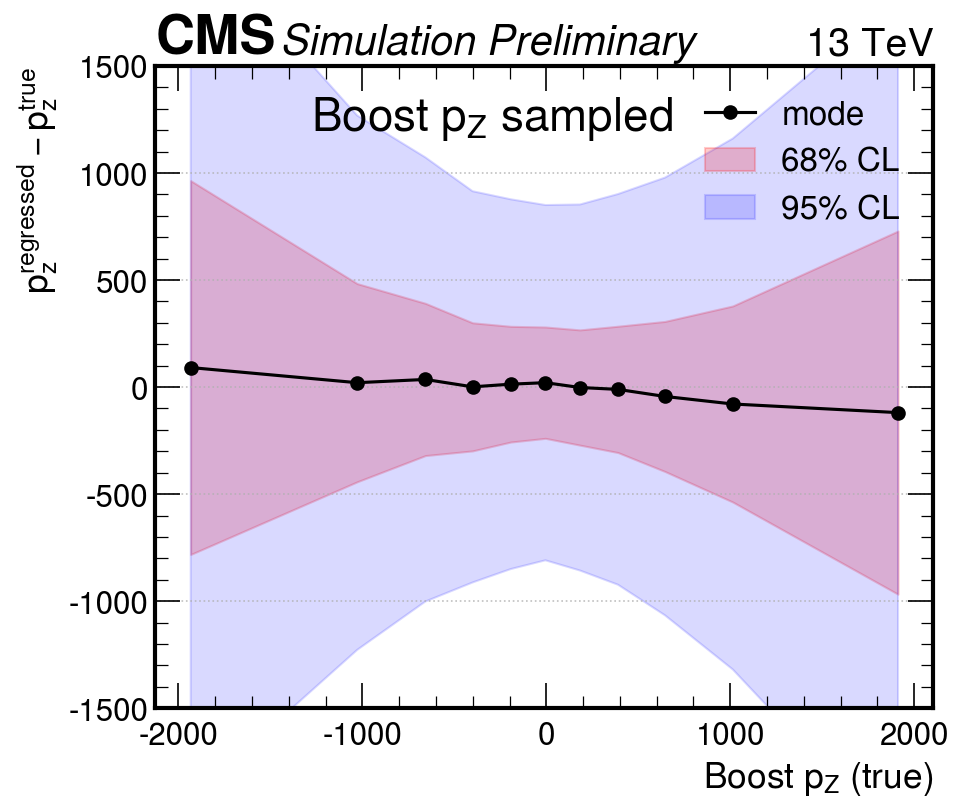

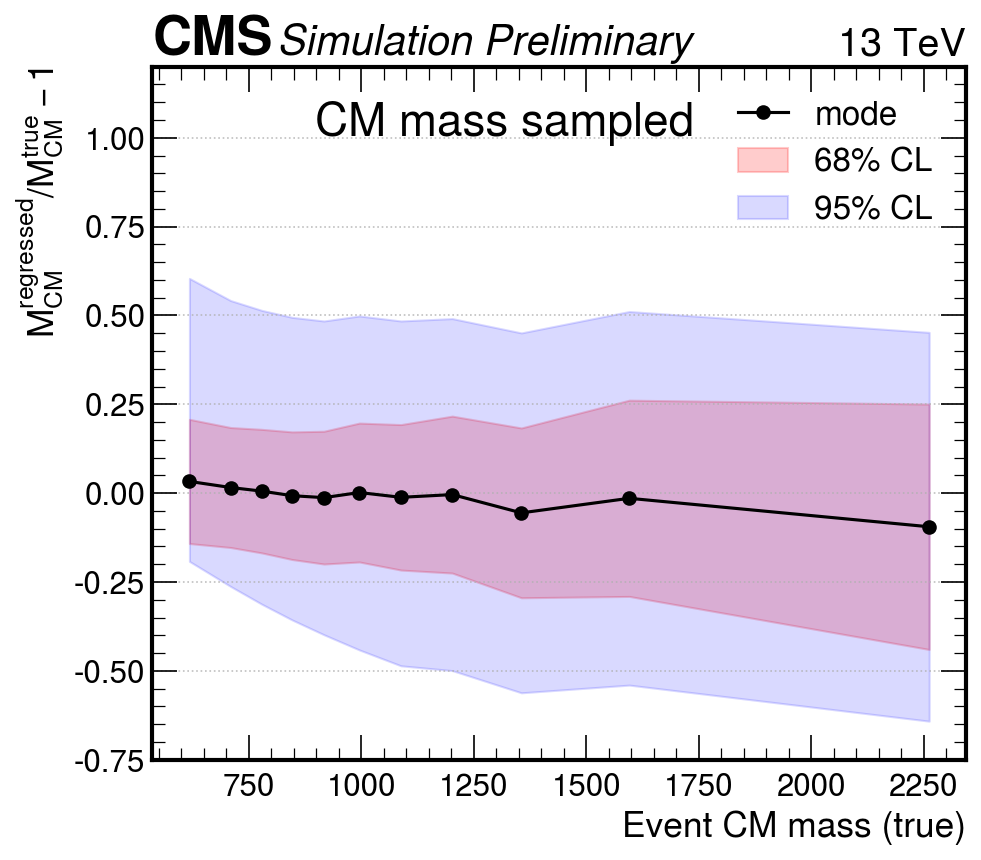

In [199]:
plot_diff_mode_quantile((boost_pz_sampled - boost_pz_true), 
                        X=boost_pz_true,
                        cat_var=boost_pz_true, 
                        bins=np.quantile(boost_pz_true, np.linspace(0,1,12)),
                        xlabel='Boost $p_Z$ (true)', ylim=(-1500,1500),
                    ylabel='$p_z^{regressed} - p_z^{true}$', title='Boost $p_Z$ sampled',nbins_mode=100,
                        output_file=output+"/Boost_sampled_Pz")

plot_diff_mode_quantile((cm_M_sampled / cm_M_true - 1), 
                        X=cm_M_true,
                        cat_var=cm_M_true, 
                        bins=np.quantile(cm_M_true, np.linspace(0,1,12)),
                        xlabel='Event CM mass (true)', ylim=(-0.75,1.2),
                    ylabel='$M_{CM}^{regressed}/M_{CM}^{true} -1$', title='CM mass sampled',nbins_mode=100,
                        output_file=output+"/Boost_sampled_ECM")

In [90]:
cum = []
cum_t1 = []
xs = np.linspace(0, 3, 30)
for x in xs:
    cum.append(np.sum(df.H_eta.abs()>x) / len(df.H_eta))
    cum_t1.append(np.sum(df.t1_eta.abs()>x) / len(df.t1_eta))

(array([  2557.,   2987.,   3406.,   3950.,   4526.,   5281.,   6199.,
          7195.,   8111.,   9519.,  10843.,  12643.,  14242.,  16098.,
         18625.,  20699.,  23606.,  26861.,  30698.,  35131.,  39997.,
         44988.,  50747.,  56542.,  62616.,  69491.,  77278.,  85178.,
         93578., 101708., 111548., 121872., 132004., 141415., 152906.,
        162906., 174491., 184275., 196204., 207097., 216888., 227267.,
        235767., 244595., 252897., 261046., 267776., 270989., 273726.,
        274156., 273925., 272858., 265644., 260797., 255638., 249842.,
        241652., 231982., 221471., 212382., 202511., 190917., 180725.,
        169354., 157431., 147484., 136440., 126631., 116129., 106461.,
         96385.,  87914.,  80043.,  71945.,  65301.,  57773.,  52042.,
         46117.,  40559.,  36080.,  32432.,  28490.,  24919.,  22280.,
         19438.,  17286.,  14939.,  13026.,  11091.,   9597.,   8240.,
          7124.,   6170.,   5438.,   4672.,   3984.,   3566.,   3016.,
      

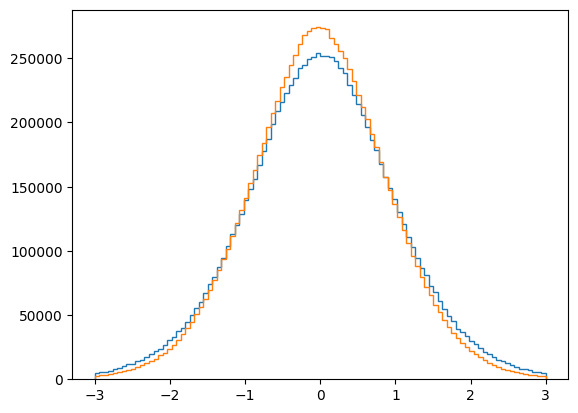

In [28]:
plt.hist(out["H_eta"], bins=100, range=(-3,3), histtype="step")
plt.hist(out["H_eta"]+out["delta_H_eta"], bins=100, range=(-3,3), histtype="step")

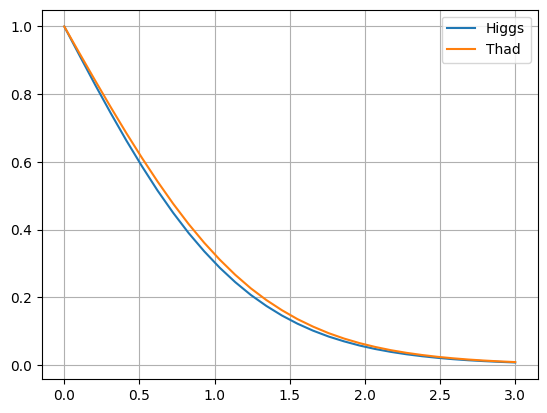

In [92]:
plt.plot(xs, cum, label="Higgs")
plt.plot(xs, cum_t1 , label="Thad")
plt.grid()
plt.legend()

(array([ 28800.,  40102.,  79483., 125812., 171737., 212873., 251906.,
        284915., 311133., 331945., 345188., 354168., 357587., 358100.,
        352778., 345914., 336602., 326309., 313133., 298673., 285869.,
        271203., 258286., 243776., 229600., 216491., 203195., 190805.,
        179347., 168640., 157213., 147487., 138432., 129232., 121022.,
        113014., 106180.,  98828.,  92331.,  86614.,  81164.,  75806.,
         70405.,  66375.,  62109.,  58404.,  54207.,  51281.,  47744.,
         45077.,  42139.,  39669.,  36731.,  34802.,  32726.,  30918.,
         28676.,  27114.,  25680.,  24175.,  22766.,  21628.,  20230.,
         19329.,  18104.,  16837.,  15823.,  15006.,  14202.,  13499.,
         12711.,  11775.,  11101.,  10838.,  10088.,   9368.,   8750.,
          8443.,   8028.,   7506.,   6972.,   6680.,   6129.,   5921.,
          5593.,   5286.,   4932.,   4674.,   4415.,   4136.,   3948.,
          3624.,   3319.,   3269.,   3030.,   3009.,   2807.,   2590.,
      

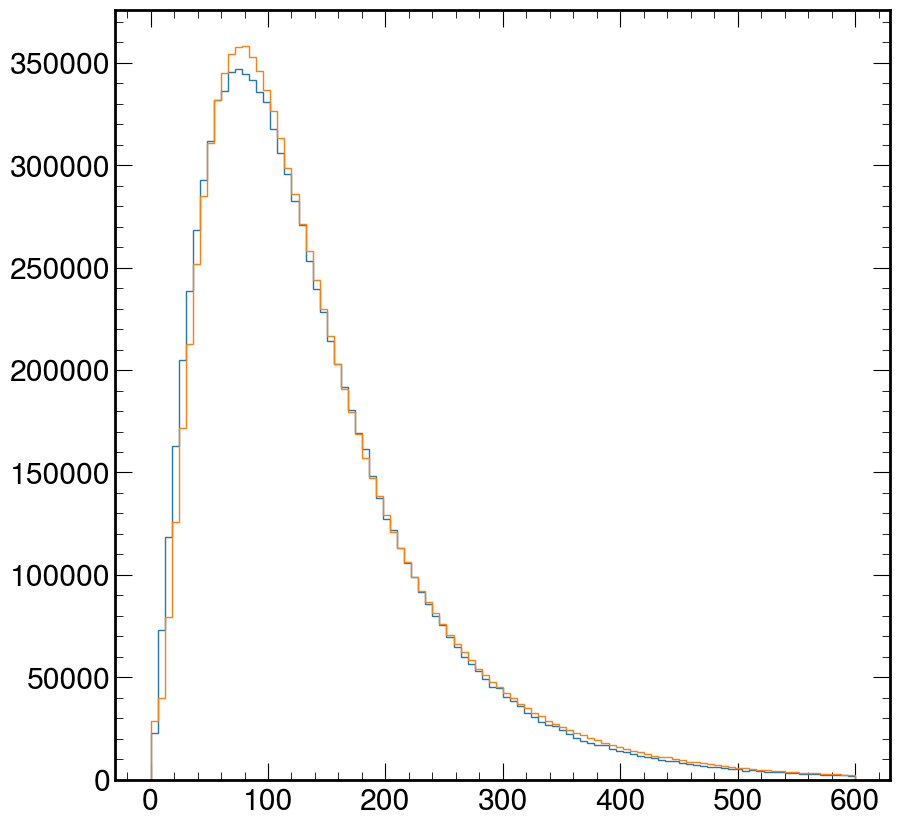

In [319]:
plt.hist(out["H_pt"], bins=100, range=(0,600), histtype="step")
plt.hist(out["H_pt"]+out["delta_H_pt"], bins=100, range=(0,600), histtype="step")

In [321]:
cum = []
cum_t1 = []
xs = np.linspace(0, 600, 30)
for x in xs:
    cum.append(np.sum(out["H_pt"]>x) / len(out["H_pt"]))
    cum_t1.append(np.sum(out["t1_pt"]>x) / len(out["t1_pt"]))

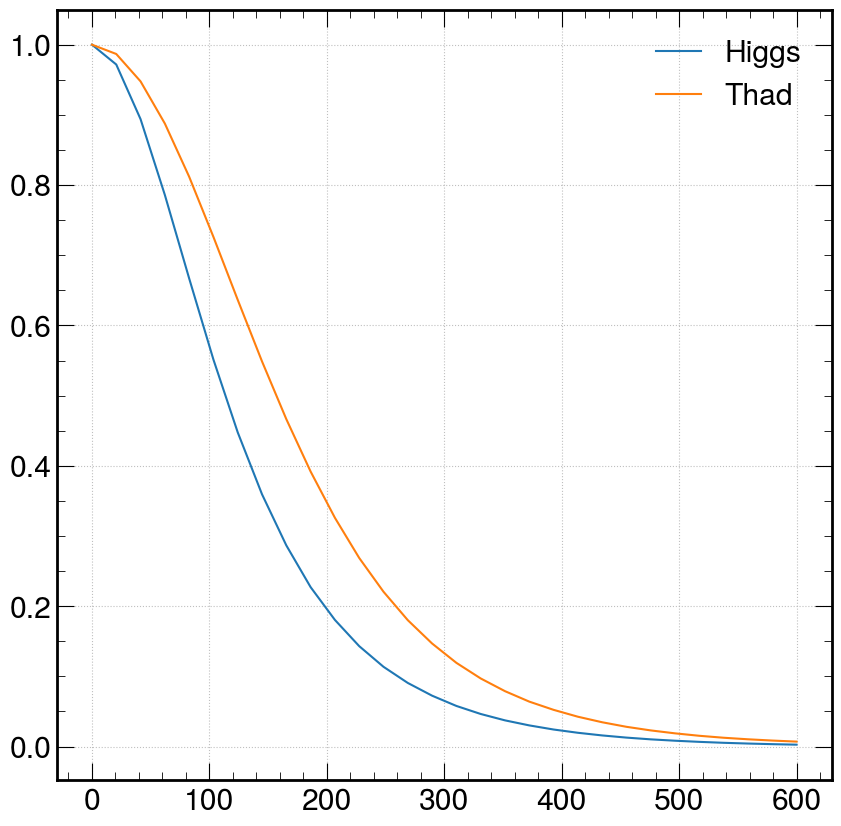

In [322]:
plt.plot(xs, cum, label="Higgs")
plt.plot(xs, cum_t1 , label="Thad")
plt.grid()
plt.legend()

In [161]:
np.quantiles(df.H_eta.abs()

0          0.459183
1          0.134169
2          0.459139
3          0.322623
4          0.804271
             ...   
1499995    1.840345
1499996    0.276695
1499997    0.946906
1499998    0.163123
1499999    1.957651
Name: H_eta, Length: 1500000, dtype: float64

# Boost plot

tensor([[[ 644.9089,  -11.6064,  -16.9297, -404.5905]],

        [[1365.8651,   42.9471,   -8.8268,  821.2266]],

        [[ 925.1965,  -43.5248,   -7.5663,  679.1958]],

        ...,

        [[ 766.9849,  -89.8343,    7.8308, -219.7976]],

        [[1301.7220,   26.8487,    3.3207,  907.0079]],

        [[1241.5529,    5.1484,    2.4470,  424.9549]]])

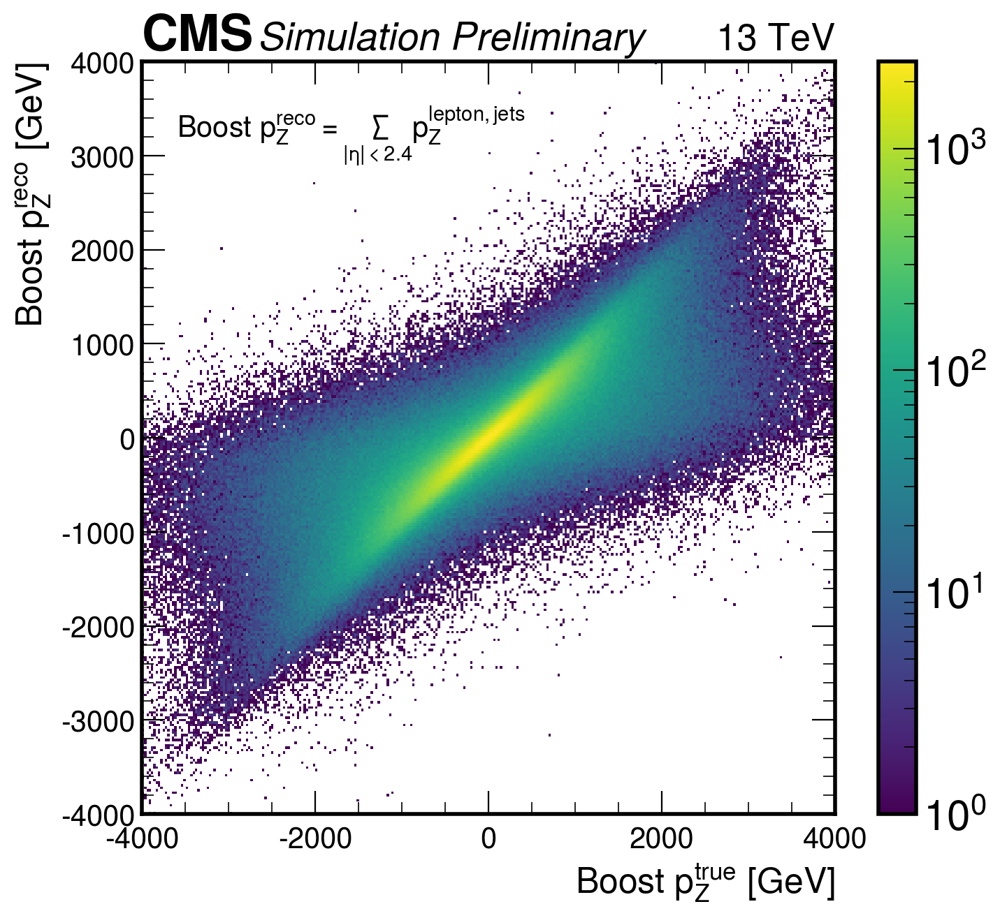

In [302]:
f= plt.figure(figsize=(8,7), dpi=200)
ax = plt.gca()

_,_,_,I= ax.hist2d(boost_parton[:,0,-1].numpy(), 
           data.reco_lab.data_boost[:,0,-1].numpy(), 
           bins=(300,300), range=((-4000,4000),(-4000,4000)),
          norm=LogNorm());

ax.tick_params(axis='both', which='major', labelsize=15)
ax.set_xlabel("Boost $p_Z^{true}$ [GeV]", fontsize=18)
ax.set_ylabel("Boost $p_Z^{reco}$ [GeV]",fontsize=18)
ax.text(0.05, 0.9, "Boost $p_Z^{reco} = \sum_{|\eta|<2.4} p_Z^{lepton,jets}$ ", transform=ax.transAxes, fontsize=15)

hep.cms.label(rlabel="13 TeV",  llabel="Simulation Preliminary", loc=0, ax=ax,fontsize=20)
plt.colorbar(I, ax=ax)

plt.savefig(f"{output}/boost_reco.png")
plt.savefig(f"{output}/boost_reco.pdf")

In [287]:
boost_regr

tensor([[ 860.2443, -658.2746],
        [1474.9980,  949.2159],
        [1453.6350, 1250.0747],
        ...,
        [1897.1353, -638.9467],
        [2438.0165, 1338.4487],
        [1610.5788,  561.3750]])

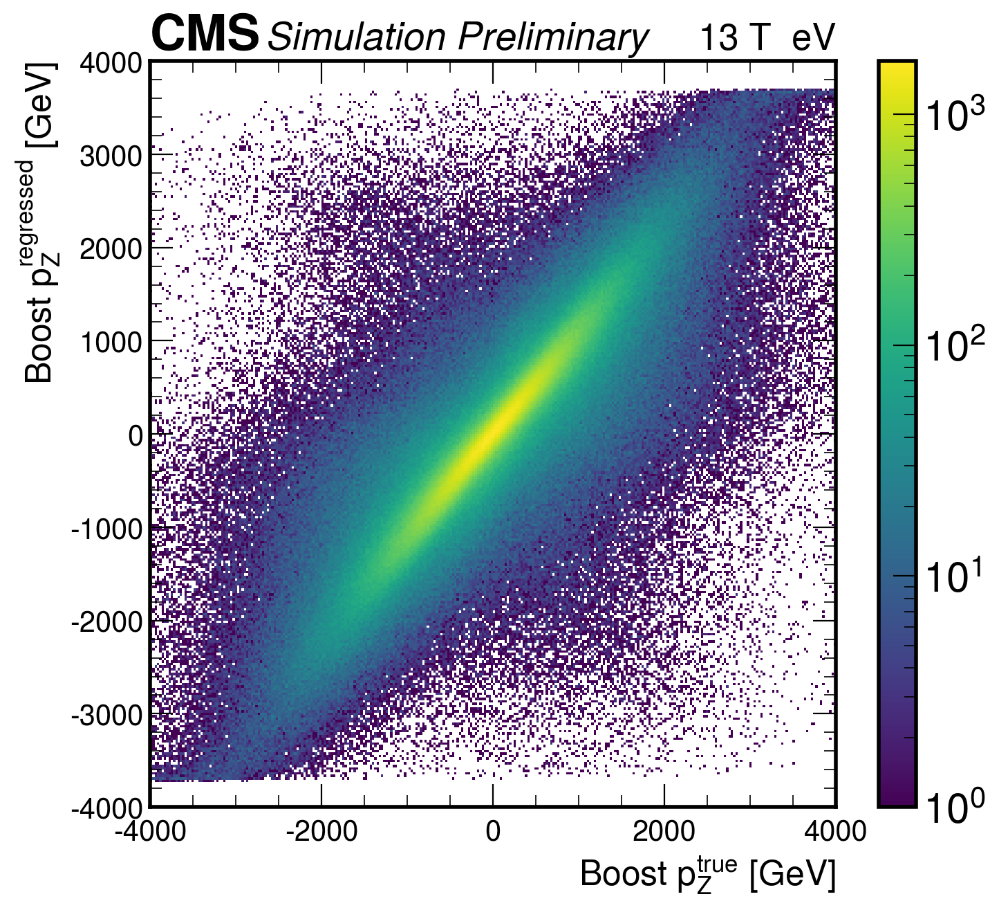

In [308]:
f= plt.figure(figsize=(8,7), dpi=200)
ax = plt.gca()

_,_,_,I= ax.hist2d(boost_parton[:,0,-1].numpy(), 
           boost_regr[:,1].numpy(), 
           bins=(300,300), range=((-4000,4000),(-4000,4000)),
          norm=LogNorm());

ax.tick_params(axis='both', which='major', labelsize=15)
ax.set_xlabel("Boost $p_Z^{true}$ [GeV]", fontsize=18)
ax.set_ylabel("Boost $p_Z^{regressed}$ [GeV]",fontsize=18)
#ax.text(0.05, 0.9, "Boost $p_Z^{reco} = \sum_{|\eta|<2.4} p_Z^{lepton,jets}$ ", transform=ax.transAxes, fontsize=15)

hep.cms.label(rlabel="13 T  eV",  llabel="Simulation Preliminary", loc=0, ax=ax,fontsize=20)
plt.colorbar(I, ax=ax)

plt.savefig(f"{output}/boost_regressed.png")
plt.savefig(f"{output}/boost_regressed.pdf")

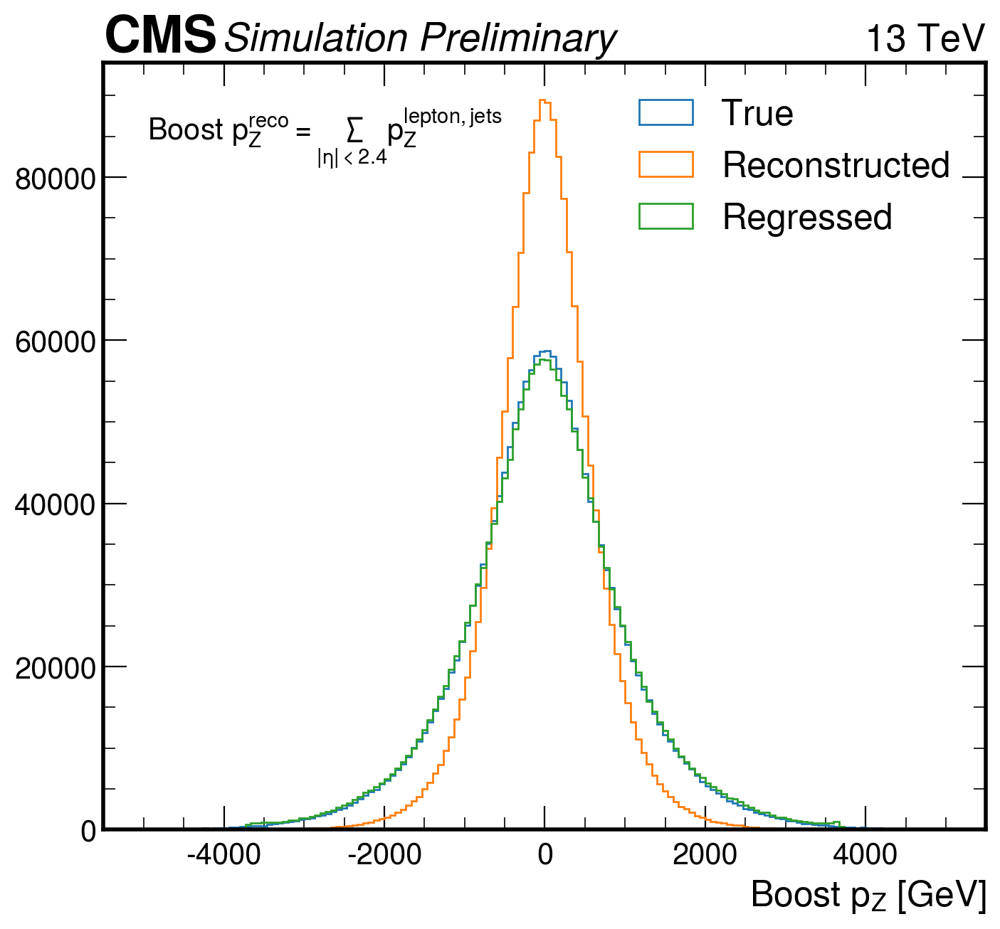

In [317]:
f= plt.figure(figsize=(8,7), dpi=200)
ax = plt.gca()


ax.hist(boost_parton[:,0,-1].numpy(), 
        bins=150, range=(-5000,5000), label="True", histtype="step")
ax.hist(data.reco_lab.data_boost[:,0,-1].numpy(), 
        bins=150, range=(-5000,5000), label="Reconstructed",histtype="step")
ax.hist(boost_regr[:,1].numpy(), 
        bins=150, range=(-5000,5000), label="Regressed",histtype="step")

ax.tick_params(axis='both', which='major', labelsize=15)
ax.set_xlabel("Boost $p_Z$ [GeV]", fontsize=18)
ax.legend(loc="upper right", fontsize=18)
ax.text(0.05, 0.9, "Boost $p_Z^{reco} = \sum_{|\eta|<2.4} p_Z^{lepton,jets}$ ", transform=ax.transAxes, fontsize=15)


hep.cms.label(rlabel="13 TeV",  llabel="Simulation Preliminary", loc=0, ax=ax,fontsize=20)

plt.savefig(f"{output}/boost_regressed_1D.png")
plt.savefig(f"{output}/boost_regressed.1D.pdf")